# **<font size="7">` Dependencies (must to run)`</font>**

___

In [1]:

import sys, os, copy
#os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 
import numpy as np
import matplotlib.pyplot as plt
if sys.platform != 'darwin' :
    os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 

'main root'
main_path = os.path.abspath('../')
ds_root_path =  os.path.join(os.path.abspath('../..'),"ML_DataSet")
'pretrained model lib'
lib_root_path =  os.path.join(os.path.abspath('../..'),"trained")
sys.path.append(main_path)

import tensorflow as tf
from lib.utils.common import is_path_available
from lib.datasets.transforms.utils import PackInputTensorTypeSpec
from lib.Registers import DATASETS
from lib.visualization import Vis_SampleTransform
from lib.datasets.transforms import CVBaseTransform, CVBaseTransformLayer, VectorizedTransformLayer

'basic info'
print(" tensorflow version:",tf.__version__)
print(" numpy version:", np.__version__)
print(" Python version:", sys.version)
print(" sys.platform:", sys.platform)
print(" gpu available:", tf.config.list_physical_devices('GPU'))
print(" sys.path:", sys.path)

"path of lib"
is_path_available(main_path) 
"path to save model weights"
is_path_available(lib_root_path) 

if  sys.platform == 'win32':
    'xla issue : https://www.qiniu.com/qfans/qnso-68614547#comments'
    #libdevice_path = "C:/Users/yista/anaconda3/envs/rtx_py38_tf2-10_cu118/Library/bin"
    #os.environ['XLA_FLAGS'] = "--xla_gpu_cuda_data_dir=C:/Users/yista/anaconda3/envs/rtx_py38_tf2-10_cu118/Library/bin"
    libdevice_path = "C:/Users/yista/anaconda3/envs/rtx_py38_tf2-10_cu118/Library/bin"
    #libdevice_path = "C:/Users/David/anaconda3/envs/Test/Library/bin"
    is_path_available(libdevice_path)
    os.environ['XLA_FLAGS'] = "--xla_gpu_cuda_data_dir="+libdevice_path
    print(os.environ['XLA_FLAGS'])

key : BBoxesFormatTransform, value :<class 'lib.datasets.transforms.bboxes_format_transform.BBoxesFormatTransform'> >
key : ImageResize, value :<class 'lib.datasets.transforms.img_resize.ImageResize'> >
key : RandomPadImageResize, value :<class 'lib.datasets.transforms.img_resize.RandomPadImageResize'> >
key : Albumentations, value :<class 'lib.datasets.transforms.albumentations.Albumentations'> >
key : IdendityTest, value :<class 'lib.datasets.transforms.idendity_test.IdendityTest'> >
key : EnsureTensor, value :<class 'lib.datasets.transforms.ensure_to_tensor.EnsureTensor'> >
key : ImageNormalize, value :<class 'lib.datasets.transforms.img_norm.ImageNormalize'> >
key : RandomBBoxTransform, value :<class 'lib.datasets.transforms.random_bbox_transform.RandomBBoxTransform'> >
key : RandomFlip, value :<class 'lib.datasets.transforms.random_flip.RandomFlip'> >
key : RandomChannelShift, value :<class 'lib.datasets.transforms.random_channel_shift.RandomChannelShift'> >
key : RandomContrast, 

c:\Users\yista\anaconda3\envs\rtx_py38_tf2-10_cu118\lib\site-packages\tensorflow_addons\utils\tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [2]:
# import sys, os, copy
# import numpy as np
# import matplotlib.pyplot as plt

# if sys.platform == 'darwin' :
#     os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 


# 'main root'
# main_path = os.path.abspath('../')
# 'ds_root_path'
# ds_root_path =  os.path.join(os.path.abspath('../..'),"ML_DataSet")
# 'pretrained model lib'
# lib_root_path =  os.path.join(os.path.abspath('../..'),"trained")
# sys.path.append(main_path)
# import tensorflow as tf
# from lib.utils.common import is_path_available
# #from lib.visualization import Vis_PoseSampleTransform

# 'basic info'
# print(" tensorflow version:",tf.__version__)
# print(" numpy version:", np.__version__)
# print(" Python version:", sys.version)
# print(" sys.platform:", sys.platform)
# print(" gpu available:", tf.config.list_physical_devices('GPU'))
# print(" sys.path:", sys.path)


# 'dataset'
# is_path_available(ds_root_path)
# "path of lib"
# is_path_available(main_path) 
# "path to save model weights"
# is_path_available(lib_root_path) 

### **<font size="6">`HyperParams`</font>**

In [3]:
'MODEL Type'
MODEL_TYPE = 'mvla_pose'
PROJECT_NAME = 'RTMPose'
MODEL_INPUT_SIZE_HW = (256,192)
MODEL_INPUT_SIZE_WH = MODEL_INPUT_SIZE_HW[::-1]


'Global Settings'
USE_MIXED_PRECISION = True if sys.platform != 'darwin' else False
BATCH_SIZE = 16
PREFETCH_SIZE = 4
BATCH_NORM_EPSILON = 1e-5  #torch  :  bn_eps = 1e-5,  tensorflow : bn_eps = 1e-3
BATCH_NORM_MOMENTUM = 0.9  #torch  :  bn_moentum = 0.9,  tensorflow : bn_moentum = 0.99
CODEC_PARALLEL_ITERS = BATCH_SIZE  #parallel_iterations
CV_TRANS_PARALLEL_ITERS = BATCH_SIZE  #parallel_iterations

'Training'
TOTAL_EPOCHS = 420
WARMUP_EPOCHS = TOTAL_EPOCHS//20
LR = 4e-3

"model path"
PATH_BACKBONE_FEATURE_VEC = None
PATH_TO_SAVE_MODEL = None
PATH_TO_SAVE_EMA_MODEL = None
PATH_TO_LOAD_MODEL = None
PATH_TO_LOAD_EMA_MODEL= None




## **<font size="6">`Mixed Precision (Optional)`</font>**

In [4]:
from tensorflow.keras import mixed_precision
if USE_MIXED_PRECISION :
    policy = mixed_precision.Policy('mixed_float16')
else:
    policy = mixed_precision.Policy('float32')
mixed_precision.set_global_policy(policy)
print('Compute dtype: %s' % policy.compute_dtype)
print('Variable dtype: %s' % policy.variable_dtype)



INFO:tensorflow:Mixed precision compatibility check (mixed_float16): OK
Your GPU will likely run quickly with dtype policy mixed_float16 as it has compute capability of at least 7.0. Your GPU: NVIDIA GeForce RTX 3070 Laptop GPU, compute capability 8.6
Compute dtype: float16
Variable dtype: float32


## **<font size="6">`Data Paths`</font>**

In [5]:
'dataset root'
ds_main_path =  os.path.join(ds_root_path,"COCO-WholeBody")
is_path_available(ds_main_path)

'train/ val dataset path'
val_tfrec_kps_dir = os.path.join(ds_main_path, "tfrecords_kps_val")
'verify whether tfrecords_dir is exist'
is_path_available(val_tfrec_kps_dir)

'train/ val dataset path'
train_tfrec_kps_dir = os.path.join(ds_main_path, "tfrecords_kps_train")
'verify whether tfrecords_dir is exist'
is_path_available(train_tfrec_kps_dir)



successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody

successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val

successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train



True

## **<font size="6">`save / load .h5  path `</font>**

In [6]:
## **<font size="6">`Data Paths`</font>**
'pretrained model lib'
lib_main_path =  os.path.join(lib_root_path, MODEL_TYPE, PROJECT_NAME)
is_path_available(lib_main_path)

successfully connect floder  : 
h:\deep_learning\trained\mvla_pose\RTMPose



True

# **<font size="7">` 1. Build DataLoader`</font>**

## **<font size="6">`1-1. Train data pipeline `</font>**

In [7]:
import copy
from lib.Registers import DATASETS
from lib.datasets.transforms import PackInputTensorTypeSpec

'#0 train / val dataset path'
tfrec_train_dataset_cfg = dict(
    type = 'Parser_CocoSinglePoseTFRec', 
    data_root = train_tfrec_kps_dir,
)

IdendityTest_cfg = dict(type='IdendityTest')

flip_cfg = dict(type='RandomFlip',prob=0.5)

halfbody_cfg = dict(
    type='RandomHalfBody',
    prob=0.5, 
    upper_prioritized_prob= 0.7,
    padding = 1.5,
    min_total_keypoints = 9, 
    min_upper_keypoints = 4,
    min_lower_keypoints = 4
)

bbox_cfg = dict(
    type='RandomBBoxTransform',  
    shift_factor = 0.16, 
    shift_prob = 0.5, 
    scale_factor = (0.75, 1.25), 
    scale_prob = 0.5 ,
)


contrast_cfg = dict(
    type = 'RandomContrast',
    value_range =(0,255), 
    factor =(0.3, 0.8),
    prob = 0.5,
    test_mode=False
)

hsv_cfg = dict(
    type='RandomHSVAug',  
    hue_prob = 0.5,
    saturation_prob = 0.5,
    brightness_prob = 0.5,
    hue_delta = 0.3, 
    saturation_factor = (0.5,2.0),
    brightness_delta = 0.4
)

blur_cfg = dict(
    type='RandomGaussianBlur', 
    kernel_size_xy=(5,5),
    factor=3.0,
    prob =0.5,
    test_mode=True
)
kpsdrop_cfg = dict(
    type='RandomCutoutByKeypoints',   
    base_mask_ratio = 0.05,
    mask_scale_factor = (0.8, 1.2),
    min_bbox_area = 64.*64.,
    prob=0.2, 
    drop_joints_indices=[5,6,7,8,11,12],
    random_mask_color=False, 
    test_mode =False
)


affine_cfg = dict(
    type='TopdownAffine',
    is_train = True, 
    test_mode = False,   
    do_clip = True,      
    keep_bbox_aspect_prob = 0.5,
    rotate_prob = 0.5,
    shear_prob = 0.25,
    MaxRot_deg=30., 
    MaxShear_deg=15.
)


train_dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = BATCH_SIZE,
    prefetch_size = PREFETCH_SIZE,
    shuffle  =  True,
    tfrec_datasets_list = [tfrec_train_dataset_cfg],
    augmenters = [flip_cfg, halfbody_cfg, kpsdrop_cfg, blur_cfg, affine_cfg],
    codec = None,
    ensure_to_tensor = True,
    parallel_iterations = CV_TRANS_PARALLEL_ITERS,
    vis_fn = Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0],
        plot_transformed_bbox=False,
    )
)

train_tfds_builder = DATASETS.build(copy.deepcopy(train_dataloader_cfg))
#train_tfds_builder.get_pipeline_cfg() 

batch_train_dataset = train_tfds_builder.GenerateTargets(
    test_mode=False, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None,
    show_PackTensorTypeSpec  = True,
    show_pipeline_cfg = True
)
#PackInputTensorTypeSpec(next(iter(batch_train_dataset)),{})




register : <tfds_pipeline>  init ...................from internal libs


 All Modules of registry < tfds_pipeline >have been automatically imported from lib.datasets

--------------register : <tfds_pipeline>  Update Done-----from internal libs

successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train

samples_in_tfrec : 4269 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_00-4269.tfrec>
samples_in_tfrec : 2899 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_01-2899.tfrec>
samples_in_tfrec : 3523 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_02-3523.tfrec>
samples_in_tfrec : 4124 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_03-4124.tfrec>
samples_in_tfrec : 4701 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_04-4701.tfrec>
samples_in_tfrec : 5047 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_train\file_05-5047.tfrec>

h:\deep_learning\project_sample_V0.7.3\lib\datasets\tfds_builder.py:91: UserWarning: codec is None, you cannot gen targets used in traaining, but test_mode to review data is ok @pose_dataloader
  warnings.warn(


register : <transforms>  init ...................from internal libs


 All Modules of registry < transforms >have been automatically imported from lib.datasets.transforms

--------------register : <transforms>  Update Done-----from internal libs


 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- RandomFlip : <lib.datasets.transforms.random_flip.RandomFlip object at 0x000002D6C81E9E80>
< 2 >  --- RandomHalfBody : <lib.datasets.transforms.random_half_body.RandomHalfBody object at 0x000002D6C81E9850>
< 3 >  --- RandomCutoutByKeypoints : <lib.datasets.transforms.random_cutout_by_kps.RandomCutoutByKeypoints object at 0x000002D6CF9E55E0>
< 4 >  --- RandomGaussianBlur : <lib.datasets.transforms.random_gaussian_blur.RandomGaussianBlur object at 0x000002D6CF9E5AC0>
< 5 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x000002D6CF9E5AF0>
< 6 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTens

In [10]:
type(batch_train_dataset)

tensorflow.python.data.ops.dataset_ops.PrefetchDataset

### **<font size="5">`Explore Sample (option)`</font>**

h:\deep_learning\project_sample_V0.7.3\lib\datasets\tfds_builder.py:259: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")



 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- RandomFlip : <lib.datasets.transforms.random_flip.RandomFlip object at 0x000002D6C81E9E80>
< 2 >  --- RandomHalfBody : <lib.datasets.transforms.random_half_body.RandomHalfBody object at 0x000002D6C81E9850>
< 3 >  --- RandomCutoutByKeypoints : <lib.datasets.transforms.random_cutout_by_kps.RandomCutoutByKeypoints object at 0x000002D6CF9E55E0>
< 4 >  --- RandomGaussianBlur : <lib.datasets.transforms.random_gaussian_blur.RandomGaussianBlur object at 0x000002D6CF9E5AC0>
< 5 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x000002D6CF9E5AF0>
< 6 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x000002D6CFA3D550>
< 7 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x000002D6E00C5F70>
--------------------------------------------------------------------------------


==========P

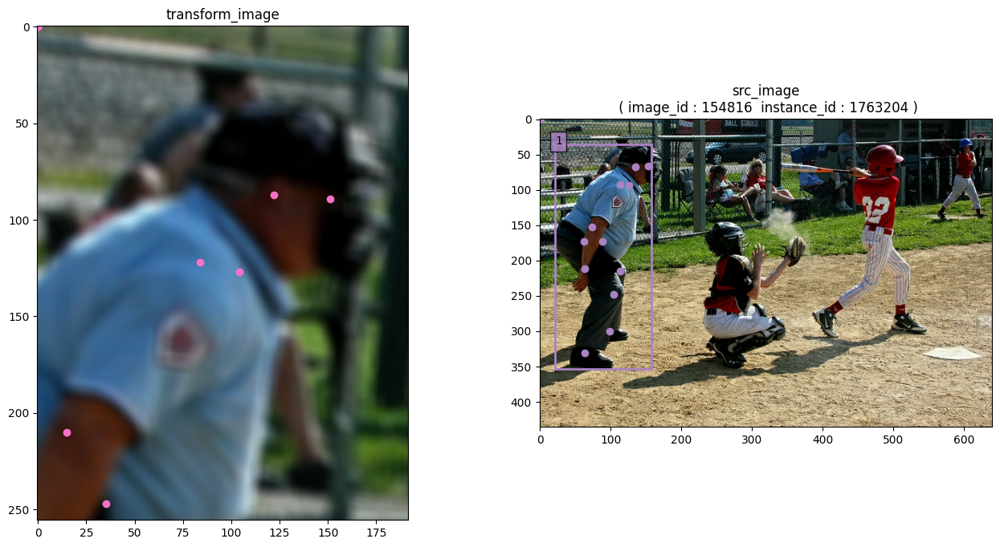

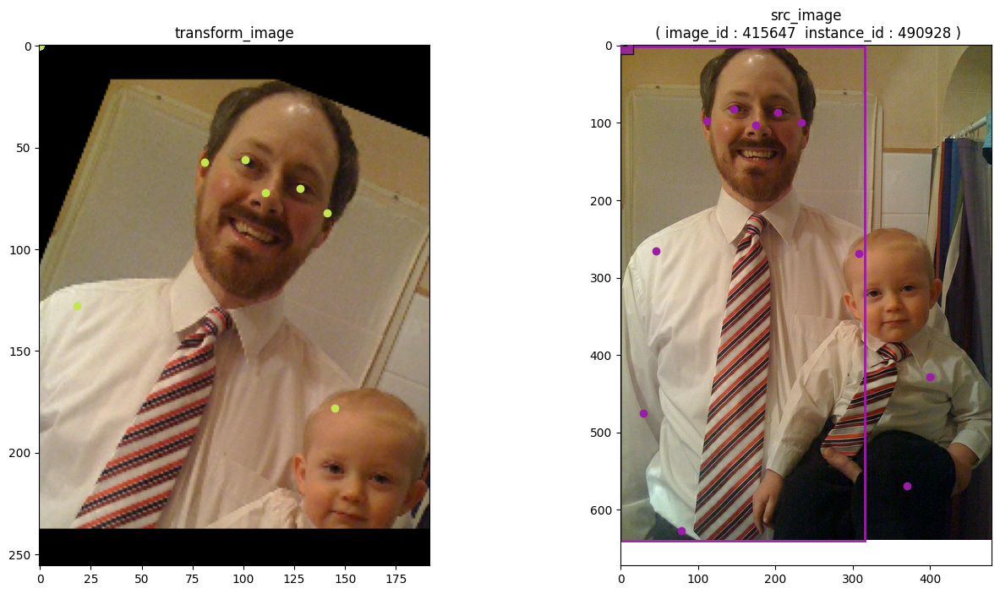

In [8]:
train_tfds_builder.explore_samples(
    take_batch_num = 2,
    # batch_ids  = [0,1,2],
    # plot_transformed_bbox=False,
)

## **<font size="6">`1-2. Val data pipeline`</font>**

In [9]:
tfrec_val_dataset_cfg = dict(
    type = 'Parser_CocoSinglePoseTFRec', 
    data_root = val_tfrec_kps_dir,
)

val_affine_cfg = dict(
    type='TopdownAffine',
    is_train = False, 
    test_mode = False,   
    do_clip = True,      
    keep_bbox_aspect_prob = 1.,
    rotate_prob = 0.,
    shear_prob = 0.,
    MaxRot_deg=0., 
    MaxShear_deg=0.
)

val_dataloader_cfg =  dict(
    type = 'dataloader',
    batch_size = BATCH_SIZE,
    prefetch_size = PREFETCH_SIZE,
    shuffle  =  False,
    tfrec_datasets_list = [tfrec_val_dataset_cfg],
    augmenters = [val_affine_cfg],
    codec = None,
    ensure_to_tensor = True,
    vis_fn =  Vis_SampleTransform(
        figsize = (16, 8),
        sel_batch_ids  = [0],
        plot_transformed_bbox=False,
    )
)
val_tfds_builder = DATASETS.build(
    copy.deepcopy(val_dataloader_cfg)
)
batch_val_dataset = val_tfds_builder.GenerateTargets(
    test_mode=False,     
    unpack_x_y_sample_weight= False, 
    ds_weights =None,
    show_PackTensorTypeSpec  = True,
    show_pipeline_cfg = True
)
# val_tfds_builder.explore_samples(
#     take_batch_num = 2,
# )


successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val

samples_in_tfrec : 1880 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val\file_00-1880.tfrec>
samples_in_tfrec : 2425 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val\file_01-2425.tfrec>
samples_in_tfrec : 1342 @ <h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val\file_02-1342.tfrec>
num_TotalSamples: 5647
successfully connect floder  : 
h:\deep_learning\ML_DataSet\COCO-WholeBody\tfrecords_kps_val


 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x000002D8829983D0>
< 2 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x000002D88299F610>
< 3 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x000002D88242B040>
---------------------------------------------------------

### **<font size="5">`Explore Sample (option)`</font>**


 ----------------pipeline_cfg  (< ith > --- key : value)   @explore_samples-------------------
< 1 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x000002D8829983D0>
< 2 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x000002D88299F610>
< 3 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x000002D88295D040>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- TensorSpec(shape=(16, 256, 192, 3), dtype=tf.uint8, name=None)
kpts ----- TensorSpec(shape=(16, 17, 3), dtype=tf.float16, name=None)
bboxes ----- TensorSpec(shape=(16, 4), dtype=tf.float16, name=None)
labels ----- None
src_img ----- RaggedTensorSpec(TensorShape([16, None, None, 3]), tf.uint8, 2, tf.int64)
src_bboxes ----- TensorSpec(shape=(16, 4), dtype=tf.float16, name=None)
src_labels ----- None
src_img_id

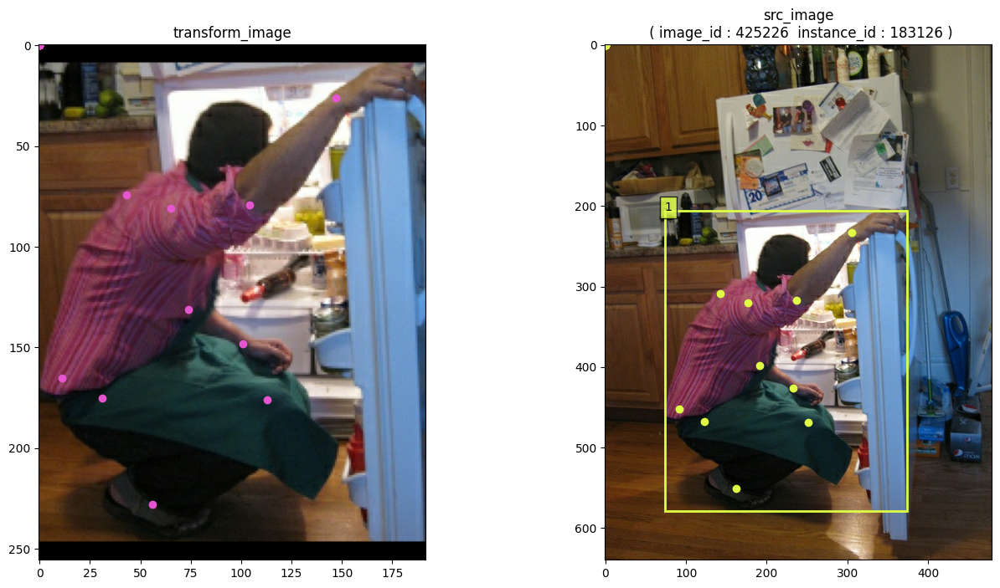

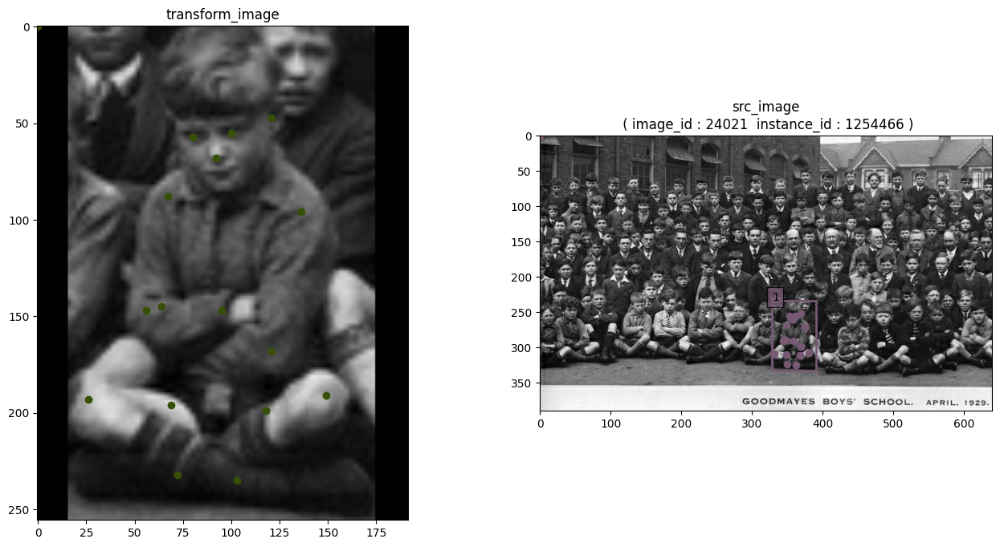

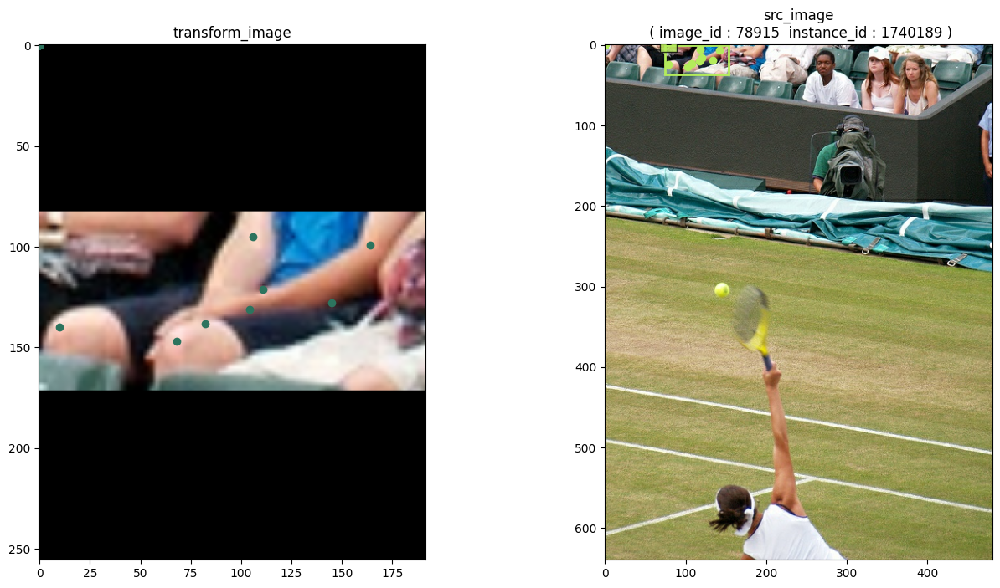

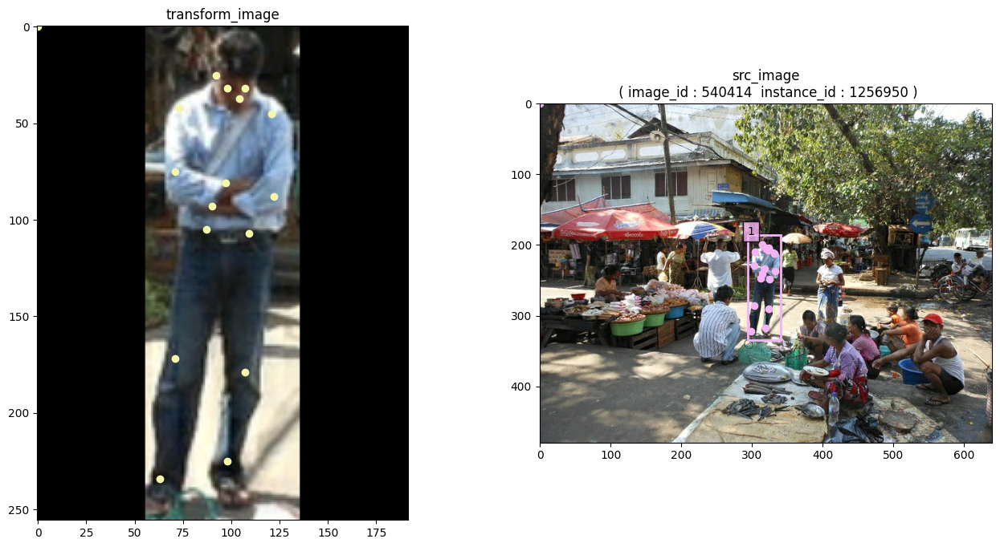

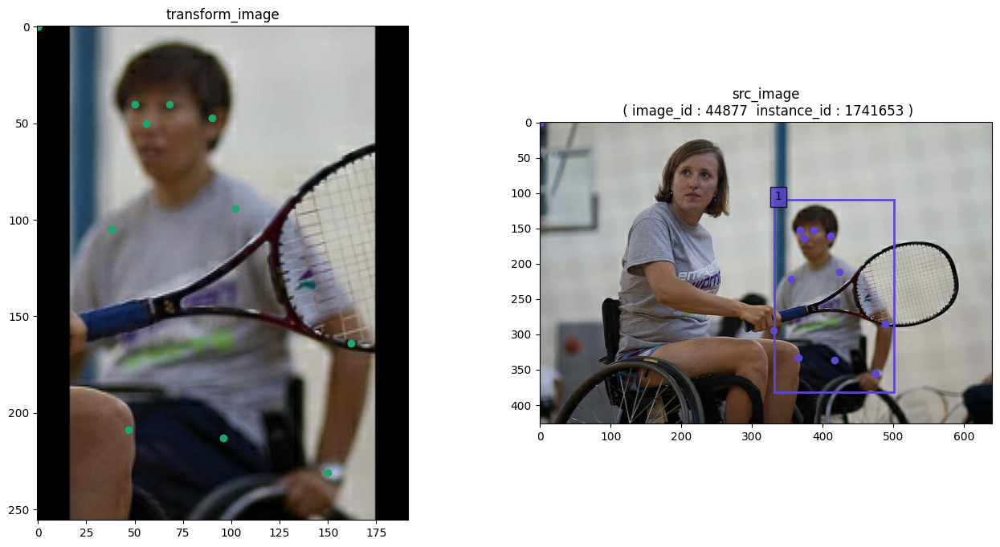

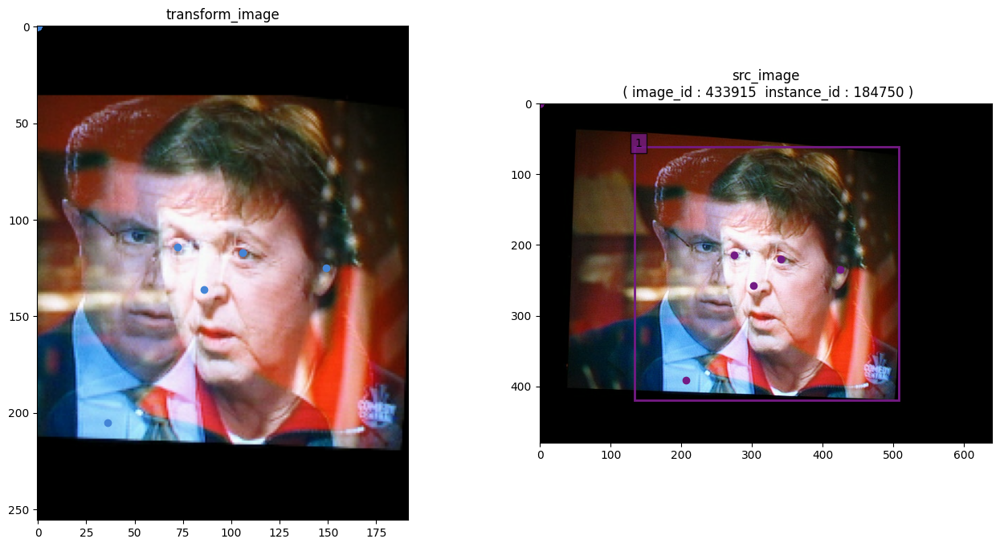

In [10]:
val_tfds_builder.explore_samples(
    take_batch_num = 2,
    sel_batch_ids  = [0,1,2],
    plot_transformed_bbox=False
)

#  **<font size="7">`2. Model`</font>**

##  **<font size="6">`2-1. BackBone`</font>**

In [4]:
from lib.models.backbones import CSPNeXt
'CSPNeXt-m'
cspnext_cfg = dict(
    model_input_shape=(640,640),
    arch_type  = 'P5',
    deepen_factor = 0.67,
    widen_factor = 0.75,
    expand_ratio= 0.5,
    use_channel_attn = True,
    use_depthwise = False,
    out_feat_indices = [3,4,5],
    bn_epsilon = 1e-5,
    bn_momentum = 0.9,
    activation = 'silu',
    data_preprocessor = dict(
            type='ImgNormalization', 
            img_mean = [0.485, 0.456, 0.406],  
            img_std = [0.229, 0.224, 0.225]
    ),
    deploy = None,
    name = 'CSPNeXt'
)
model = CSPNeXt(**cspnext_cfg)


key : RelativePositionalEmbedding, value :<class 'lib.layers.transformers.rel_pos_embs.RelativePositionalEmbedding'> >
key : AddRelativePositionBiasT5, value :<class 'lib.layers.transformers.rel_pos_embs.AddRelativePositionBiasT5'> >
key : RotaryPositionEmbedding, value :<class 'lib.layers.transformers.rope.RotaryPositionEmbedding'> >
key : GatedAttentionUnit, value :<class 'lib.layers.transformers.gau.GatedAttentionUnit'> >
key : ImgNormalization, value :<class 'lib.layers.pre_processors.img_norm.ImgNormalization'> >
key : ViT, value :<class 'lib.models.backbones.vit.ViT'> >
key : ResidualStepsBlock, value :<class 'lib.models.modules.rsb.ResidualStepsBlock'> >
key : CSPNeXt, value :<class 'lib.models.backbones.cspnext.CSPNeXt'> >
key : CSPNeXt_L, value :<function CSPNeXt_L at 0x000001DFA32CF940> >
key : CSPNeXt_M, value :<function CSPNeXt_M at 0x000001DFA32E3C10> >
key : CSPNeXt_S, value :<function CSPNeXt_S at 0x000001DFA32E3CA0> >
key : CSPNeXt_Tiny, value :<function CSPNeXt_Tiny at

In [8]:
model.output

[<KerasTensor: shape=(None, 80, 80, 192) dtype=float16 (created by layer 'Stage_P3_CSP_final_conv')>,
 <KerasTensor: shape=(None, 40, 40, 384) dtype=float16 (created by layer 'Stage_P4_CSP_final_conv')>,
 <KerasTensor: shape=(None, 20, 20, 768) dtype=float16 (created by layer 'Stage_P5_CSP_final_conv')>]

In [8]:
from lib.models.builder import build_backbone
'CSPNeXt-m'
cspnext_cfg = dict(
    type = 'CSPNeXt',
    model_input_shape=(640,640),
    arch_type  = 'P5',
    deepen_factor = 0.67,
    widen_factor = 0.75,
    expand_ratio= 0.5,
    use_channel_attn = True,
    use_depthwise = False,
    out_feat_indices = [3,4,5],
    bn_epsilon = 1e-5,
    bn_momentum = 0.9,
    activation = 'silu',
    data_preprocessor = dict(
            type='ImgNormalization', 
            img_mean = [0.485, 0.456, 0.406],  
            img_std = [0.229, 0.224, 0.225]
    ),
    deploy = None,
    name = 'CSPNeXt'
)
model = build_backbone(cspnext_cfg)
model.summary(200)

Model: "CSPNeXt"
________________________________________________________________________________________________________________________________________________________________________________________________________
 Layer (type)                                                     Output Shape                                Param #                 Connected to                                                      
 input_3 (InputLayer)                                             [(None, 640, 640, 3)]                       0                       []                                                                
                                                                                                                                                                                                        
 img_normalization_2 (ImgNormalization)                           (None, 640, 640, 3)                         0                       ['input_3[0][0]']                            

In [ ]:
# tensor = tf.ones(shape=(32,640,640,3))
# tf_model = tf.function(model, jit_compile=True)
# %timeit _ = tf_model(tensor)

In [ ]:
model.outputs

##  **<font size="6">`2-2. with single Heatmap head`</font>**

In [8]:
from lib.models import BaseModel

'CSPNeXt-m'
cspnext_cfg = dict(
    type = 'CSPNeXt',
    model_input_shape=(256,192),
    arch_type  = 'P5',
    deepen_factor = 0.67,
    widen_factor = 0.75,
    expand_ratio= 0.5,
    use_channel_attn = True,
    use_depthwise = False,
    out_feat_indices = [5],
    bn_epsilon = BATCH_NORM_EPSILON,
    bn_momentum =BATCH_NORM_MOMENTUM,
    activation = 'silu',
    data_preprocessor = dict(
        type='ImgNormalization', 
        img_mean = [0.485, 0.456, 0.406],  
        img_std = [0.229, 0.224, 0.225]
    ),
    deploy = None,
    name = 'CSPNeXt'
)

heatmap_head_cfg = dict(
    type ='HeatmapBaseHead',
    out_channels = 17,
    deconv_filters_list =[256,256,256], 
    deconv_kernels_list = [4,4,4],
    conv_kernel_szie=None,
    conv_out_channels= None,
    bn_epsilon = BATCH_NORM_EPSILON,
    bn_momentum = BATCH_NORM_MOMENTUM,
    activation = 'silu',
)   

# Optimzer_cfg = dict(
#     type="experimental.AdamW", 
#     learning_rate=0.001,
#     global_clipnorm = 10.,
#     jit_compile=False
# )

Optimzer_cfg = dict(
    type="Adam", 
    learning_rate=LR,
)

Loss_cfg_list = [  
    dict(
        type = 'KeypointsMSELoss',
        joints_balance_weights = 
        [
            1., 1., 1., 1., 1., 1., 1., 1.2, 1.2,
            1.5, 1.5, 1., 1., 1.2, 1.2, 1.5, 1.5
        ],
        loss_weight = 1.0                          
    ) 
]

metric_cfg_dict =  [ 
    dict(
        type = 'PCKMetric',
        tf_dists = 0.5, 
        num_kps = 17,
        hm_thr= 
        [
            0.75, 0.75, 0.75, 0.75, 0.75,
            0.25, 0.25, 0.25, 0.25, 0.25,
            0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25
        ]            
    )
]

codec_cfg = dict(   
    type = 'MSRAHeatmapCodec',
    use_udp = True, 
    num_kps = 17,
    sigma = 2,
    target_size_xy = (192,256),
    heatmap_size_xy = (48, 64),
    hm_thr= tf.concat(
        [ tf.ones(shape=(5,), dtype=tf.float32)*0.75,  tf.ones(shape=(12,), dtype=tf.float32)*0.5], 
        axis=-1
    ),
    use_vectorized_map  = False,
    parallel_iterations  = CODEC_PARALLEL_ITERS,
)

model = BaseModel(
    backbone = cspnext_cfg,
    neck  = None,
    head  = heatmap_head_cfg,
    extract_layres = [],
    codec = codec_cfg,
    optimizer = Optimzer_cfg,
    losses  = Loss_cfg_list,
    metrics  = metric_cfg_dict, 
    name = 'RTMPose_256x192_17kps'
)

model.summary(200)


register : <models>  init ...................from internal libs


 All Modules of registry < models >have been automatically imported from lib.models

--------------register : <models>  Update Done-----from internal libs

register : <layers>  init ...................from internal libs


 All Modules of registry < layers >have been automatically imported from lib.layers

--------------register : <layers>  Update Done-----from internal libs

register : <loss>  init ...................from internal libs

key : KLDiscretLoss, value :<class 'lib.losses.simcc_loss.KLDiscretLoss'> >
key : YoloAnchorBaseLoss, value :<class 'lib.losses.yolo_anchor_base_loss.YoloAnchorBaseLoss'> >
key : YoloAnchorFreeBBoxLoss, value :<class 'lib.losses.yolo_anchor_free_loss.YoloAnchorFreeBBoxLoss'> >
key : YoloAnchorFreeClassLoss, value :<class 'lib.losses.yolo_anchor_free_loss.YoloAnchorFreeClassLoss'> >
key : YoloAnchorFreePoseLoss, value :<class 'lib.losses.yolo_anchor_free_loss.YoloAnchorFreePoseLoss'> >
key

In [7]:

model.output

<KerasTensor: shape=(None, 64, 48, 17) dtype=float32 (created by layer 'HeatmapBaseHead_pwConv_OUT')>

### Bug

In [6]:
from lib.models import BaseModel
'CSPNeXt-m'
cspnext_cfg = dict(
    type = 'CSPNeXt',
    model_input_shape=(256,192),
    arch_type  = 'P5',
    deepen_factor = 0.67,
    widen_factor = 0.75,
    expand_ratio= 0.5,
    use_channel_attn = True,
    use_depthwise = False,
    out_feat_indices = [5],
    bn_epsilon = BATCH_NORM_EPSILON,
    bn_momentum =BATCH_NORM_MOMENTUM,
    activation = 'silu',
    data_preprocessor = dict(
        type='ImgNormalization', 
        img_mean = [0.485, 0.456, 0.406],  
        img_std = [0.229, 0.224, 0.225]
    ),
    deploy = None,
    name = 'CSPNeXt'
)

model = BaseModel(
    backbone = cspnext_cfg,
    neck  = None,
    head  = None,
    extract_layres = [],
    codec = None,
    optimizer = None,
    losses  = None,
    metrics  = None, 
    name = 'RTMPose_256x192_17kps'
)
model.save('model_test')

c:\Users\yista\anaconda3\envs\rtx_py38_tf2-10_cu118\lib\site-packages\tensorflow_addons\utils\tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


key : RelativePositionalEmbedding, value :<class 'lib.layers.transformers.rel_pos_embs.RelativePositionalEmbedding'> >
key : AddRelativePositionBiasT5, value :<class 'lib.layers.transformers.rel_pos_embs.AddRelativePositionBiasT5'> >
key : RotaryPositionEmbedding, value :<class 'lib.layers.transformers.rope.RotaryPositionEmbedding'> >
key : GatedAttentionUnit, value :<class 'lib.layers.transformers.gau.GatedAttentionUnit'> >
key : ImgNormalization, value :<class 'lib.layers.pre_processors.img_norm.ImgNormalization'> >
key : ViT, value :<class 'lib.models.backbones.vit.ViT'> >
key : ResidualStepsBlock, value :<class 'lib.models.modules.rsb.ResidualStepsBlock'> >
key : CSPNeXt, value :<class 'lib.models.backbones.cspnext.CSPNeXt'> >
key : CSPNeXt_L, value :<function CSPNeXt_L at 0x0000019058A71550> >
key : CSPNeXt_M, value :<function CSPNeXt_M at 0x0000019058A87790> >
key : CSPNeXt_S, value :<function CSPNeXt_S at 0x0000019058A87820> >
key : CSPNeXt_Tiny, value :<function CSPNeXt_Tiny at

h:\deep_learning\project_sample_V0.6\lib\models\estimators\base_model.py:93: UserWarning: codec is None, you may not gen targets used in training
  warnings.warn("codec is None, you may not gen targets used in training")


INFO:tensorflow:Assets written to: model_test\assets


INFO:tensorflow:Assets written to: model_test\assets


### **<font size="6">`Load Model Weights`</font>**

In [ ]:
model_type= 'mvla_pose'
project_name = 'RTMPose'
h5_file_name = 'td-hm_CSPNeXt_udp-b128-200e_coco-256x192.h5'
file_path = os.path.join(lib_main_path,model_type,project_name,h5_file_name)
is_path_avaiable(file_path)
#model.load_weights(file_path)

### **<font size="5">`Callbacks`</font>**

tf.Tensor(5.3537162e-05, shape=(), dtype=float32)


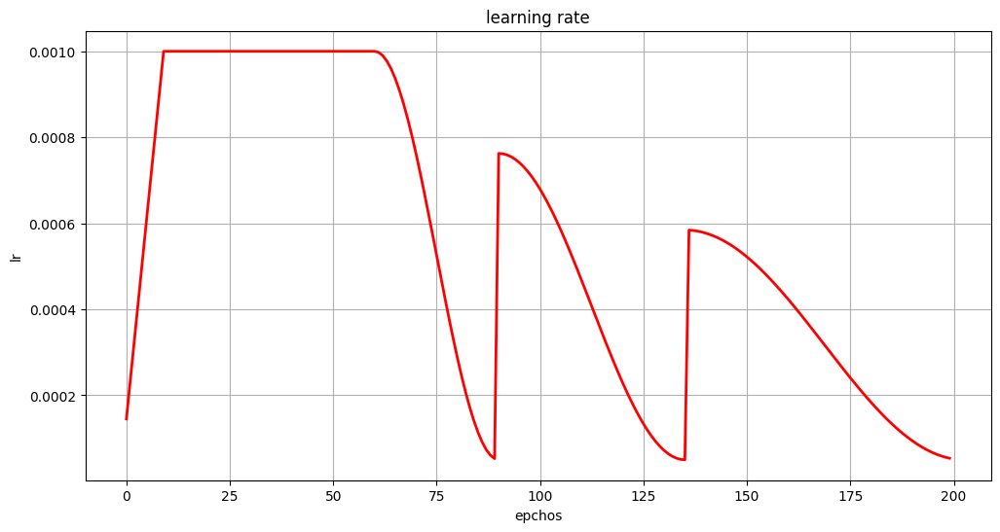

In [30]:
train_steps_per_epoch = train_tfds_builder.ds_steps_per_epoch
val_steps_per_epoch = val_tfds_builder.ds_steps_per_epoch
from lib.callbacks import CosineDecayScheduler
  
STEPS_PER_EPOCH = train_steps_per_epoch

lr_callback = CosineDecayScheduler(
    learning_rate  = LR,
    alpha = 0.05,
    total_epochs = TOTAL_EPOCHS,
    steps_per_epoch = STEPS_PER_EPOCH ,
    warmup_steps = STEPS_PER_EPOCH*10, # STEPS_PER_EPOCH*TOTAL_EPOCHS/10
    warmup_steps_update = 10,
    hold_epochs = 50,
    base_decay_cycle_epochs = 30,
    t_mul=1.5,
    m_mul=0.75
) 
lr_callback.test()

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping, ReduceLROnPlateau
from lib.callbacks import CosineDecayScheduler
from lib.callbacks import ExponentialMovingAverage

train_steps_per_epoch = train_tfds_builder.ds_steps_per_epoch
val_steps_per_epoch = val_tfds_builder.ds_steps_per_epoch
STEPS_PER_EPOCH = train_steps_per_epoch


callbacks = [
    ExponentialMovingAverage(
        decay=0.999, 
        num_updates=1
    ),
    EarlyStopping(
        monitor = 'pck_val_acc',  # "val_loss"
        patience=20
    ),
    ModelCheckpoint(
        filepath = file_path,
        monitor="loss",
        verbose=1,
        save_best_only=True,
        save_weights_only=True
    ),
    CosineDecayScheduler(
        learning_rate  = LR,
        alpha = 0.,
        total_epochs = TOTAL_EPOCHS,
        steps_per_epoch = STEPS_PER_EPOCH,
        warmup_steps = STEPS_PER_EPOCH*10, # STEPS_PER_EPOCH*TOTAL_EPOCHS/10
        warmup_steps_update = 10,
        hold_epochs =20,
        base_decay_cycle_epochs = -1,
        t_mul=1.,
        m_mul=1.
    ) ,
    TensorBoard(
        log_dir='logs'
    ),
]

### **<font size="6">` Training`</font>**

In [ ]:
history = model.fit(
    batch_train_dataset, 
    epochs = TOTAL_EPOCHS, 
    steps_per_epoch = train_steps_per_epoch,
    validation_data = batch_val_dataset,
    validation_steps = val_steps_per_epoch
    callbacks = callbacks
)

In [34]:
tensor = tf.ones(shape=(32,256,192,3))
tf_model = tf.function(model, jit_compile=True)
%timeit _ = tf_model(tensor)

The slowest run took 11.33 times longer than the fastest. This could mean that an intermediate result is being cached.
12.1 ms ± 13.4 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [36]:
%timeit _ = tf_model(tensor)

14.2 ms ± 1.4 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


##  **<font size="6">`2-3. with RTMCC head`</font>**

In [11]:
from lib.models import BaseModel
R'''
                deepen_factor        widen_factor
    ---------------------------------------------
    CSPNeXt-x       1.33                  1.25
    CSPNeXt-l       1.                    1.
    CSPNeXt-m       0.67                  0.75
    CSPNeXt-s       0.33                  0.5
    CSPNeXt-t       0.167                 0.375

'''

cspnext_cfg = dict(
    type = 'CSPNeXt',
    model_input_shape=(256,192),
    arch_type  = 'P5',
    deepen_factor = 0.67,
    widen_factor = 0.75,
    expand_ratio= 0.5,
    use_channel_attn = True,
    use_depthwise = False,
    out_feat_indices = [5],
    bn_epsilon = BATCH_NORM_EPSILON,
    bn_momentum = BATCH_NORM_MOMENTUM,
    activation = 'silu',
    data_preprocessor = dict(
            type='ImgNormalization', 
            img_mean = [0.485, 0.456, 0.406],  
            img_std = [0.229, 0.224, 0.225]
    ),
    deploy = None,
    name = 'CSPNeXt-m'
)

rtmcc_head_cfg = dict(
    type ='RTMCCHead',
    simcc_split_ratio = 2.0,   
    input_size_hw = MODEL_INPUT_SIZE_HW,       
    hidden_dims = 256,
    gau_expansion_factor =2.,
    gau_att_dims = 128,
    ln_epsilon = BATCH_NORM_EPSILON,
    conv_out_channels = 17, 
    conv_kernel_size = 7,
    output_concatenate = True,
    name='RTMCCHead'
)   

# Optimzer_cfg = dict(
#     type="experimental.AdamW", 
#     learning_rate=0.001,
#     global_clipnorm = 10.,
#     jit_compile=False
# )

Optimizer_cfg = dict(
    type="Adam", 
    learning_rate=0.001,
)



Loss_cfg_list = [  
    dict(
        type = 'KLDiscretLoss',
        beta=10.0, 
        label_beta =10.0,
        use_label_softmax = True,
        simcc_dim_splits_hw = (
            MODEL_INPUT_SIZE_HW[0]*2, MODEL_INPUT_SIZE_HW[1]*2
        ),  
        joints_balance_weights = [
            1., 1., 1., 1., 1., 1., 1., 1.2, 1.2,
            1.5, 1.5, 1., 1., 1.2, 1.2, 1.5, 1.5
        ],
        loss_weight = 1.0  ,
        reduction = 'sum'                         
    ) 
]

metric_cfg_dict =  [ 
    dict(
        type = 'SimCC_PCKMetric',
        input_size_hw = MODEL_INPUT_SIZE_HW,
        tf_dists = 0.5, 
        num_kps = 17,
        hm_thr= [
                0.75, 0.75, 0.75, 0.75, 0.75,
                0.25, 0.25, 0.25, 0.25, 0.25,
                0.25, 0.25, 0.25, 0.25, 0.25, 0.25, 0.25
        ]            
    )
]

codec_cfg = dict(   
    type = 'SimCCLabelCodec',
    sigma_xy =(4.9, 5.66), 
    image_size_xy = MODEL_INPUT_SIZE_WH, 
    simcc_split_ratio=2.,
    hm_thr =  [
        0.5, 0.5, 0.5, 0.5, 0.5,
        0.1, 0.1, 0.1, 0.1, 0.1,
        0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1
    ] 
)

model = BaseModel(
    backbone = cspnext_cfg,
    neck  = None,
    head  = rtmcc_head_cfg,
    extract_layres = [],
    codec = codec_cfg,
    optimizer = Optimizer_cfg,
    losses  = Loss_cfg_list,
    metrics  = metric_cfg_dict, 
    name = 'RTMPose-m_256x192_17kps'
)

#model.summary(200)




key : RelativePositionalEmbedding, value :<class 'lib.layers.transformers.rel_pos_embs.RelativePositionalEmbedding'> >
key : AddRelativePositionBiasT5, value :<class 'lib.layers.transformers.rel_pos_embs.AddRelativePositionBiasT5'> >
key : RotaryPositionEmbedding, value :<class 'lib.layers.transformers.rope.RotaryPositionEmbedding'> >
key : GatedAttentionUnit, value :<class 'lib.layers.transformers.gau.GatedAttentionUnit'> >
key : ImgNormalization, value :<class 'lib.layers.pre_processors.img_norm.ImgNormalization'> >
key : ViT, value :<class 'lib.models.backbones.vit.ViT'> >
key : ResidualStepsBlock, value :<class 'lib.models.modules.rsb.ResidualStepsBlock'> >
key : CSPNeXt, value :<class 'lib.models.backbones.cspnext.CSPNeXt'> >
key : CSPNeXt_L, value :<function CSPNeXt_L at 0x000002D87FE4B4C0> >
key : CSPNeXt_M, value :<function CSPNeXt_M at 0x000002D87FE4EE50> >
key : CSPNeXt_S, value :<function CSPNeXt_S at 0x000002D87FE4EEE0> >
key : CSPNeXt_Tiny, value :<function CSPNeXt_Tiny at

### **<font size="6">`Load Heatmap Pre-train Weights (option)`</font>**

In [ ]:
model_type= 'mvla_pose'
project_name = 'RTMPose'
h5_file_name = 'td-hm_CSPNeXt_udp-b128-200e_coco-256x192.h5'
file_path = os.path.join(lib_main_path,model_type,project_name,h5_file_name)
is_path_available(file_path)
model.load_weights(file_path,skip_mismatch=True,by_name=True)

### **<font size="6">`Load SimCC Pre-train Weights`</font>**

In [12]:
model_type= 'mvla_pose'
project_name = 'RTMPose'
h5_file_name = 'td-simcc_RTMPose-m_udp-b128-420e_coco-256x192.h5'
file_path = os.path.join(lib_main_path, h5_file_name)
is_path_available(file_path)
model.load_weights(file_path,skip_mismatch=False,by_name=True)

successfully connect floder  : 
h:\deep_learning\trained\mvla_pose\RTMPose\td-simcc_RTMPose-m_udp-b128-420e_coco-256x192.h5



### **<font size="6">` Callbacks`</font>**

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping, ReduceLROnPlateau
from lib.callbacks import CosineDecayScheduler, EMA_ModelCheckpoint
train_steps_per_epoch = train_tfds_builder.ds_steps_per_epoch
val_steps_per_epoch = val_tfds_builder.ds_steps_per_epoch
STEPS_PER_EPOCH = train_steps_per_epoch

ema_h5_file_name = 'td-simcc_RTMPose-m_udp-b128-420e_coco-256x192_EMA.h5'
h5_file_name = 'td-simcc_RTMPose-m_udp-b128-420e_coco-256x192.h5'
ema_file_path = os.path.join(lib_main_path, ema_h5_file_name)
file_path = os.path.join(lib_main_path,h5_file_name)


callbacks = [
    EMA_ModelCheckpoint(
        ema_file_path,
        decay = 0.999, 
        val_use_ema_weights = True,
        verbose=1
    ) ,
    ModelCheckpoint(
        filepath = file_path,
        monitor="loss",
        verbose=1,
        save_best_only=True,
        save_weights_only=True
    ),
    CosineDecayScheduler(
        learning_rate  = LR,
        alpha = 0.05,
        total_epochs = TOTAL_EPOCHS,
        steps_per_epoch = STEPS_PER_EPOCH,
        warmup_steps = 0, # STEPS_PER_EPOCH*TOTAL_EPOCHS/10
        warmup_steps_update = 10,
        hold_epochs = 210,
        base_decay_cycle_epochs = -1,
        t_mul=1.,
        m_mul=1.
    ) ,
    TensorBoard(
        log_dir='logs'
    ),
]

tf.Tensor(0.00020021258, shape=(), dtype=float32)


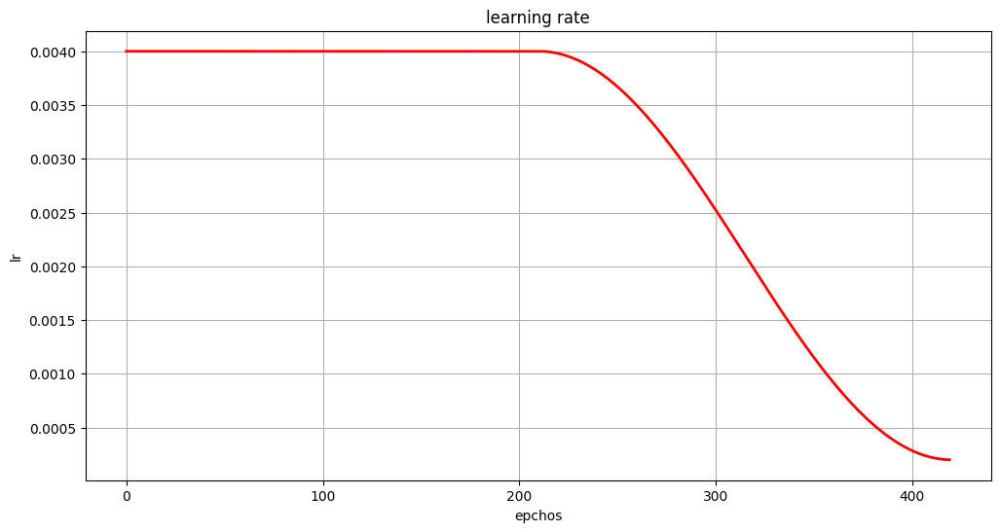

In [18]:
train_steps_per_epoch = train_tfds_builder.ds_steps_per_epoch
val_steps_per_epoch = val_tfds_builder.ds_steps_per_epoch
from lib.callbacks import CosineDecayScheduler

STEPS_PER_EPOCH = train_steps_per_epoch

lr_callback = CosineDecayScheduler(
    learning_rate  = LR,
    alpha = 0.05,
    total_epochs = TOTAL_EPOCHS,
    steps_per_epoch = STEPS_PER_EPOCH,
    warmup_steps = 0, # STEPS_PER_EPOCH*TOTAL_EPOCHS/10
    warmup_steps_update = 10,
    hold_epochs = 210,
    base_decay_cycle_epochs = -1,
    t_mul=1.,
    m_mul=1.
) 

lr_callback.test()

### **<font size="6">` Training`</font>**

In [10]:
history = model.fit(
    batch_train_dataset, 
    epochs = 3, 
    steps_per_epoch = 4,
)

init ModelingTask ..............
Epoch 1/3
4/4 [==============================] - 16s 115ms/step - loss: 4.8839 - simcc_pck_acc: 0.0000e+00
Epoch 2/3
4/4 [==============================] - 1s 162ms/step - loss: 4.6238 - simcc_pck_acc: 0.0000e+00
Epoch 3/3
4/4 [==============================] - 1s 167ms/step - loss: 4.7852 - simcc_pck_acc: 0.0000e+00


### **<font size="6">`Evaluation`</font>**

In [18]:
tensor = tf.ones(shape=(4,256,192,3), dtype=tf.uint8)
out = model(tensor)

In [19]:
out.dtype

tf.float32

In [17]:
from lib.codecs.simcc import Vis_TopdownPoseSimCCLabelCodec

batch_val_dataset = val_tfds_builder.GenerateTargets(
    test_mode=True,     
    unpack_x_y_sample_weight= False, 
    ds_weights =None,
    show_PackTensorTypeSpec  = False,
    show_pipeline_cfg = True
)


batched_samples_list = [ model.encoder(feat) for feat in batch_val_dataset.take(2)]
encoded_trues_list = [ batched_samples['y_true'] for batched_samples in batched_samples_list]
batched_images_list = [ batched_samples['image'] for batched_samples in batched_samples_list]
batched_kpts_list = [ batched_samples['kps'] for batched_samples in batched_samples_list]
batched_pred_list = [ model(batched_samples['image']) for batched_samples in batched_samples_list]
batched_decode_pred_list = [ model.decoder(batched_samples) for batched_samples in batched_pred_list]
batched_src_imgs_list = [ batched_samples['meta_info']['src_image'] for batched_samples in batched_samples_list]
batched_src_kpts_list =  [ tf.reshape(batched_samples['meta_info']['src_keypoints'],[-1,17,3])  for batched_samples in batched_samples_list]
batched_src_bboxes_list = [ batched_samples['meta_info']['src_bbox'] for batched_samples in batched_samples_list]
batched_src_img_ids_list = [ batched_samples['meta_info']['image_id'] for batched_samples in batched_samples_list]
batched_src_ids_list = [ batched_samples['meta_info']['id'] for batched_samples in batched_samples_list]


vis_fn = Vis_TopdownPoseSimCCLabelCodec(
    simicc_split_xy_dim  = (192*2, 256*2),
    figsize = (24, 8),
    sel_batch_ids  = [0]
)

vis_fn(
    batched_samples_list = batched_samples_list,
    y_pred = batched_pred_list,
    decode_pred  = batched_decode_pred_list,
)



 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x000002D8829983D0>
< 2 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x000002D88299F610>
< 3 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x000002D882B5C3A0>
--------------------------------------------------------------------------------

1/1 [==============================] - 0s 36ms/step

==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- TensorSpec(shape=(16, 256, 192, 3), dtype=tf.uint8, name=None)
encode_true ----- TensorSpec(shape=(16, 17, 896), dtype=tf.float32, name=None)
kpts ----- TensorSpec(shape=(16, 17, 3), dtype=tf.float32, name=None)
y_pred ----- TensorSpec(shape=(16, 17, 896), dtype=tf.float32, name=None)
decode_pred ----- TensorSpec(shape=(16, 17, 3), dtype=tf.float32, name=None)
src_img -----

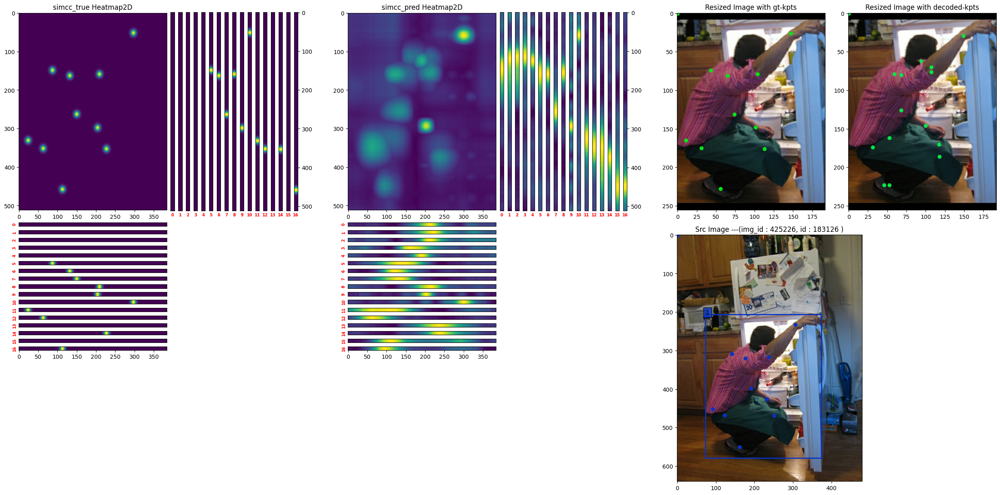

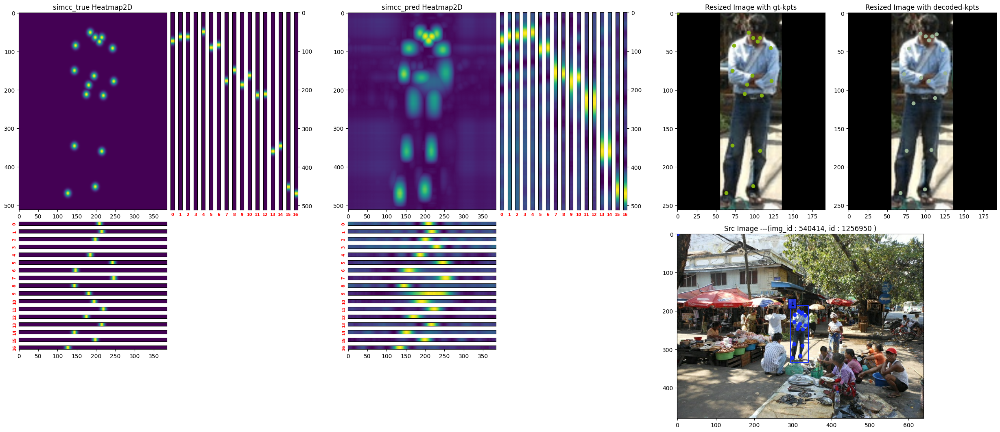

In [13]:
from lib.codecs.simcc import Vis_TopdownPoseSimCCLabelCodec

batch_val_dataset = val_tfds_builder.GenerateTargets(
    test_mode=True,     
    unpack_x_y_sample_weight= False, 
    ds_weights =None,
    show_PackTensorTypeSpec  = False,
    show_pipeline_cfg = True
)


batched_samples_list = [ model.encoder(feat) for feat in batch_val_dataset.take(2)]
batched_pred_list = [ model.predict(batched_samples) for batched_samples in batched_samples_list]



vis_fn = Vis_TopdownPoseSimCCLabelCodec(
    simicc_split_xy_dim  = (192*2, 256*2),
    figsize = (24, 8),
    sel_batch_ids  = [0]
)

vis_fn(
    batched_samples_list = batched_pred_list,
)

In [64]:
indices = tf.constant([[4], [3], [1], [7]])
updates = tf.constant([9, 10, 11, 12])
shape = tf.constant([8])
scatter = tf.scatter_nd(indices, updates, shape)
print(scatter)

tf.Tensor([ 0 11  0 10  9  0  0 12], shape=(8,), dtype=int32)


In [72]:
tensor = [0, 0, 0, 0, 0, 0, 0, 0]    # tf.rank(tensor) == 1
indices = [[1], [3], [4], [7]]       # num_updates == 4, index_depth == 1
updates = [9, 10, 11, 12]            # num_updates == 4
print(tf.tensor_scatter_nd_update(tensor, indices, updates))

a = tf.convert_to_tensor([1,2,3,4])
b = tf.convert_to_tensor([1,2,3])
labels = tf.ragged.stack([[1,2,3,4], [1,2,3,1,2,4,5,6]])
labels_flip_pair = [[3,4],[5,6]]
# print(labels.shape)
indices_lt = tf.where(labels==3)
# print(indices)
# tf.tensor_scatter_nd_update(labels, indices_lt, updates)
#tf.where(labels)

tf.nest.map_structure(lambda p a)
#tf.where(labels in [3,4])


tf.Tensor([ 0  9  0 10 11  0  0 12], shape=(8,), dtype=int32)


In [21]:
batch_test_dataset = train_tfds_builder.GenerateTargets(
    test_mode = True, 
    unpack_x_y_sample_weight= False, 
    ds_weights =None,
    show_PackTensorTypeSpec  = True,
    show_pipeline_cfg = True
)

h:\deep_learning\project_sample_V0.7.2\lib\datasets\tfds_builder.py:291: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")



 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- RandomFlip : <lib.datasets.transforms.random_flip.RandomFlip object at 0x000002BBF448FE80>
< 2 >  --- RandomHalfBody : <lib.datasets.transforms.random_half_body.RandomHalfBody object at 0x000002BBF448FDF0>
< 3 >  --- RandomKPSDropout : <lib.datasets.transforms.random_kps_dropout.RandomKPSDropout object at 0x000002BB8B723DC0>
< 4 >  --- RandomGaussianBlur : <lib.datasets.transforms.random_gaussian_blur.RandomGaussianBlur object at 0x000002BB8B723BE0>
< 5 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x000002BB8B7237F0>
< 6 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x000002BBF448FA00>
< 7 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x000002BDC6E54EE0>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] 

### Test

## New Test

In [11]:
from lib.visualization import BasePoseVisFun

h:\deep_learning\project_sample_V0.7.3\lib\datasets\tfds_builder.py:259: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")



 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x000001A0B8ECFC70>
< 2 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x000001A085CE7AC0>
< 3 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x000001A34BC0CF70>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- TensorSpec(shape=(16, 256, 192, 3), dtype=tf.uint8, name=None)
encode_true ----- TensorSpec(shape=(16, 17, 896), dtype=tf.float32, name=None)
kpts ----- TensorSpec(shape=(16, 17, 3), dtype=tf.float32, name=None)
y_pred ----- TensorSpec(shape=(16, 17, 896), dtype=tf.float32, name=None)
decode_pred ----- TensorSpec(shape=(16, 17, 3), dtype=tf.float32, name=None)
src_img ----- RaggedTensorSpec(TensorShape([16, None, None, 3]), 

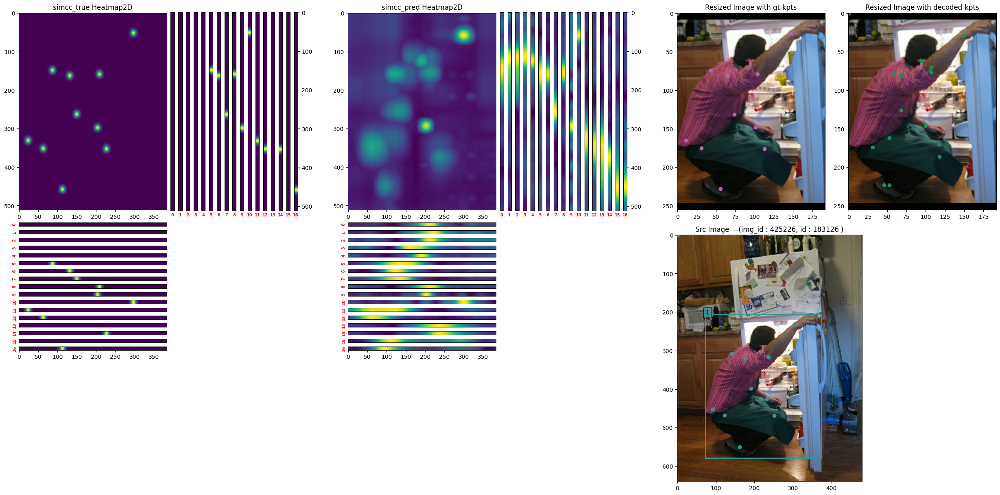

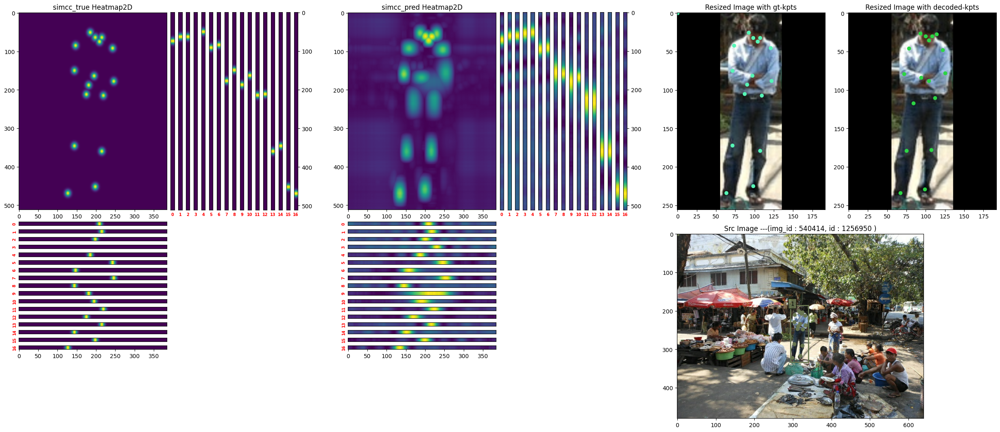

In [19]:
# from typing import Dict, List, Optional, Tuple, Union, Any, Sequence, Callable
# import matplotlib.pyplot as plt
# import matplotlib.gridspec as gridspec
# from tensorflow import Tensor
# class BasePoseVisFun:
#     VERSION = '1.0.0'
    
#     r""" BasePoseVisFun
#         Author : Dr. David Shen
#         Date : 2024/3/20
    


#     """
#     def __init__(
#             self, 
#             figsize : Tuple[int] = (24, 8),
#             sel_batch_ids : Optional[List[int]] = [0]
#     ):
#         self.figsize = figsize
#         self.sel_batch_ids = sel_batch_ids
#         self.num_batched_samples = None

#     def parse_subplot_spec(self, subplot_spec, **kwargs):
#         if type(subplot_spec)==tuple:
#             plt.subplot(*subplot_spec,**kwargs)
#         else:
#             plt.subplot(subplot_spec, **kwargs)
        
#     def base_plot(
#         self, 
#         image, 
#         bboxes=None, 
#         labels=None, 
#         kpts=None, 
#         title='Image',
#         subplot_spec=(1,1,1),
#         **kwargs
#     ):  
        
#         self.parse_subplot_spec(
#             subplot_spec=subplot_spec, **kwargs
#         )
#         plt.title(
#             title, fontsize = 12
#         )
#         plt.imshow(image)
#         if bboxes is not None and bboxes.shape.rank==3 :
#             num_obj = bboxes.shape[0]
#             ith_obj = -1 
#         else:
#             num_obj = 1 # single pose

#         num_obj = bboxes.shape[0] if bboxes is not None and bboxes.shape.rank==3 else 1
#         ith_obj = -1 
#         for i in range(num_obj):   
#             label = labels[i] if labels is not None else 1
#             if label==1: 
#                 color = np.random.uniform(
#                     low=0., high=1., size=3
#                 )
#                 ith_obj +=1

#             if bboxes is not None :   
#                 bbox = bboxes[i] if num_obj!=1 else bboxes
#                 x1, y1, w, h = bbox
#                 ax = plt.gca() 
#                 patch = plt.Rectangle(
#                     [x1, y1], w, h, 
#                     fill=False, 
#                     edgecolor=color, 
#                     linewidth=2
#                 )
#                 ax.add_patch(patch)
#                 text = "{}".format(label)
#                 ax.text(
#                     x1, y1, text,
#                     bbox={"facecolor": color, "alpha": 0.8},
#                     clip_box=ax.clipbox,
#                     clip_on=True,
#                 )

#             if kpts is not  None and label == 1 :
#                 kpt_ith = kpts[ith_obj] if num_obj!=1 else kpts
#                 for j in range(0,kpt_ith.shape[0]):
#                     kps_x = int((kpt_ith[j,0]))
#                     kps_y = int((kpt_ith[j,1]))
#                     plt.scatter(kps_x,kps_y, color=color)

#     def heatmaps_plot(
#             self,  
#             y_trues : Tensor, 
#             sum_axis= -1, 
#             title : str='heatmap', 
#             subplot_spec=(1,1,1),
#             **kwargs
#     ):
#         self.parse_subplot_spec(subplot_spec=subplot_spec)
#         plt.title(title, fontsize = 12)
#         heatmaps = y_trues.numpy()
#         plt.imshow(heatmaps.sum(axis=sum_axis))


#     def xy_heatmaps_plot(
#         self, 
#         gs : gridspec.GridSpec,
#         x_heatmaps : Tensor, 
#         y_heatmaps : Tensor, 
#         lt_start_gxy : Tuple[int] = (0,0), 
#         title = "simcc_",
#         hm_1d_size : int = 5,
#         hm_1d_intervel_row : int = 5,
#         hm_1d_intervel_col : int = 5,
#     ): 
#         if not isinstance(gs,gridspec.GridSpec):
#             raise TypeError(
#                 f"input 'gs' must be  matplotlib.gridspec.GridSpec type in xy_heatmaps_plot() "
#                 f"but got {type(gs)} @ {self.__class__.__name__} "
#             ) 
#         num_joints = y_heatmaps.shape[0]
#         lt_start_gx, lt_start_gy = lt_start_gxy
#         heatmaps_2d = x_heatmaps[:,None,:]*y_heatmaps[:,:,None] #(17,simcc_y, simcc_x)
#         hm_2d_size_hw = heatmaps_2d.shape[1:] #(512,384)
#         heatmaps_2d = tf.reduce_max(heatmaps_2d, axis=0).numpy()
       
#         '2d heatmap'
#         plt.subplot(
#             gs[lt_start_gy:lt_start_gy + hm_2d_size_hw[0]//2, lt_start_gx:lt_start_gx+hm_2d_size_hw[1]//2]
#         )
#         plt.title(
#             title + "Heatmap2D", fontsize = 12
#         )
#         plt.imshow(heatmaps_2d)
#         '1d heatmap'
#         start_gy = lt_start_gy + hm_2d_size_hw[0]//2+hm_1d_intervel_row+10
#         start_gx = lt_start_gx  + hm_2d_size_hw[1]//2+hm_1d_intervel_col
        
#         for i in range(num_joints) :
#             x_heatmap = x_heatmaps[i][None,:]
#             ax2 = plt.subplot(gs[start_gy:start_gy+hm_1d_size, lt_start_gx:lt_start_gx+hm_2d_size_hw[1]//2])
#             plt.imshow(x_heatmap, aspect='auto')
#             ax2.set_yticks([])
#             if i!=num_joints-1 :
#                 ax2.set_xticks([])
#             ax2.set_ylabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red')
#             start_gy += hm_1d_intervel_row+hm_1d_size


#             y_heatmap = y_heatmaps[i][:, None] 
#             ax2 = plt.subplot(gs[ lt_start_gy: lt_start_gy + hm_2d_size_hw[0]//2, start_gx:start_gx+hm_1d_size])
#             plt.imshow(y_heatmap, aspect='auto')
#             if i!=num_joints-1 :
#                 ax2.set_yticks([])
#             else:
#                 ax2.yaxis.set_label_position("right")
#                 ax2.yaxis.tick_right()
#             ax2.set_xticks([])
#             ax2.set_xlabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red') 
#             start_gx += hm_1d_intervel_col+hm_1d_size  



#     def map_data_structure(
#         self, data : dict
#     )->tuple:
        
#         num_batched_samples = None
#         batch_size = 0

#         for key, val in data.items():

#             if val==None:
#                continue  
#             if val==[]:
#                data[key] = None
#                continue 

#             if isinstance(val, Tensor):
#                 val = [ val ]

#             if isinstance(val, list) : 
#                 'get and verify batch_size'
#                 if not batch_size :
#                     batch_size =val[0].shape[0] 
#                     print(f"batch_size : {batch_size}")
#                 else:
#                     #print(key, batch_size, type(val[0]))
#                     assert(val[0].shape[0]==batch_size) 
                
#                 data[key] =  tf.stack(
#                     val, axis=0
#                 )
#                 'get and verify num_batched_samples'
#                 if not num_batched_samples :
#                     num_batched_samples = data[key].shape[0]
#                 else:
#                     assert(data[key].shape[0]==num_batched_samples) 

#             else:
#                 raise TypeError(
#                     f""
#                 )  
#         """ 
#         data : dict(
#                     key1 = (num_batched_samples, batch_size, ....),
#                     key2 = (num_batched_samples, batch_size, ....),
#                     key2 = (num_batched_samples, batch_size, ....),
#                 )
#         """       
#         return data , num_batched_samples  
    
#     def all_vaild(self,data_list : list):
#         return all(v is not None for v in data_list) 

#     def extract_key_samples(
#         self, samples_list : List[Dict[str,Tensor]], key : str
#     ) : 
#         if not all(samples_list):
#             return None
#         data = [ samples.get(key, None)for samples in samples_list]
#         return data if self.all_vaild(data) else None

#     def call(
#         self,  **kwargs
#     ):
#         r"""
#         args :
#             img : Tensor,
#             y_pred : Optional[Tensor] = None,
#             decode_pred : Optional[Tensor] = None,
#             encode_true : Optional[Tensor] = None,
#             kpts : Optional[Tensor] = None,
#             bboxes : Optional[Tensor] = None,
#             labels : Optional[Tensor] = None,
#             src_img : Optional[Tensor] = None,
#             src_kpts : Optional[Tensor] = None,
#             src_bboxes : Optional[Tensor] = None,
#             src_labels : Optional[Tensor] = None,
#             src_img_id : Optional[Tensor] = None,
#             src_ids : Optional[Tensor] = None,
        
 
#         """
#         raise NotImplementedError()


#     def parse_dataset(
#             self, batched_samples_list : List[Dict[str,Tensor]] = [],  
#         ) :
#         r""" Example 
        
#         """
#         if type(batched_samples_list[0])!= dict :
#             raise TypeError(
#                 f""
#             ) 
#         raise NotImplementedError()
        

#     def __call__(
#         self, 
#         batched_samples_list : List[Dict[str,Tensor]] = [],  
#         **kwargs
#     )-> None :
        
#         R""" kwargs : 
#                 y_preds : Optional[List[Tensor]] = None,
#                 decoded_preds : Optional[List[Tensor]] = None,
#                 encoded_trues : Optional[List[Tensor]] = None,
#                 kpts : Optional[List[Tensor]] = None,
#                 bboxes : Optional[List[Tensor]] = None,
#                 labels : Optional[List[Tensor]] = None,
#                 src_imgs : Optional[List[Tensor]] = None,
#                 src_kpts : Optional[List[Tensor]] = None,
#                 src_bboxes : Optional[List[Tensor]] = None,
#                 src_labels : Optional[List[Tensor]] = None,
#                 src_img_ids : Optional[List[Tensor]] = None,
#                 src_ids : Optional[List[Tensor]] = None,  
#         """
#         data = dict()
#         if isinstance(batched_samples_list, list) and len(batched_samples_list)!=0:
#             if type(batched_samples_list[0])!= dict :
#                 raise TypeError(
#                     f"the element in batched_samples_list must be 'dict' type to parse"
#                 ) 
#             data  =  self.parse_dataset(batched_samples_list)

#         data = {**data,**kwargs}
#         if all( [(val==None or val==[]) for val in data.values()]):
#                 raise ValueError(
#                     f"all input values are None or [], please check input data"
#             ) 
        
#         data , num_batched_samples  = self.map_data_structure(data)


#         for i in range(num_batched_samples):
#             for batch_id in self.sel_batch_ids:
#                 sel_data = tf.nest.map_structure(
#                     lambda x : x[i, batch_id,...] if x is not None else None, data     
#                 ) 
#                 'sel_data (single one sample) for ploting'
#                 self.call(**sel_data)    


from typing import Dict, List, Optional, Tuple, Union, Any, Sequence, Callable
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from tensorflow import Tensor
from lib.visualization import BasePoseVisFun
class Vis_TopdownPoseSimCCLabelCodec(BasePoseVisFun):
    VERSION = '1.0.0'

    R"""  Vis_TopdownPoseSimCCLabelCodec
    
    i.e. :
        vis_fn = Vis_TopdownPoseSimCCLabelCodec(
            simicc_split_xy_dim  = (192*2, 256*2),
            figsize = (24, 8),
            sel_batch_ids  = [0]
        )

        batch_val_dataset = val_tfds_builder.GenerateTargets(
            test_mode=True,     
            unpack_x_y_sample_weight= False, 
        )
        batched_samples_list = [ model.encoder(feat) for feat in batch_val_dataset.take(2)]

        # Method 1 : to list all possiable data for plotting
            encoded_trues_list = [ batched_samples['y_true'] for batched_samples in batched_samples_list]
            batched_images_list = [ batched_samples['image'] for batched_samples in batched_samples_list]
            batched_kpts_list = [ batched_samples['kps'] for batched_samples in batched_samples_list]
            batched_pred_list = [ model(batched_samples['image']) for batched_samples in batched_samples_list]
            batched_decode_pred_list = [ model.decoder(batched_samples) for batched_samples in batched_pred_list]
            batched_src_imgs_list = [ batched_samples['meta_info']['src_image'] for batched_samples in batched_samples_list]
            batched_src_kpts_list =  [ tf.reshape(batched_samples['meta_info']['src_keypoints'],[-1,17,3])  for batched_samples in batched_samples_list]
            batched_src_bboxes_list = [ batched_samples['meta_info']['src_bbox'] for batched_samples in batched_samples_list]
            batched_src_img_ids_list = [ batched_samples['meta_info']['image_id'] for batched_samples in batched_samples_list]
            batched_src_ids_list = [ batched_samples['meta_info']['id'] for batched_samples in batched_samples_list]

            vis_fn(
                img = batched_images_list,
                y_pred = batched_pred_list,
                decode_pred  = batched_decode_pred_list,
                encode_true  = encoded_trues_list,
                kpts = batched_kpts_list,
                bboxes  = None,
                labels = None,
                src_img  = batched_src_imgs_list,
                src_bboxes  = batched_src_bboxes_list,
                src_kpts  = batched_src_kpts_list,
                src_labels  = None,
                src_img_id  = batched_src_img_ids_list,
                src_ids = batched_src_ids_list,
            )

        # Method 2 : using  parser to get required data
            batched_samples_list = [ model.predict(batched_samples) for batched_samples in batched_samples_list]
            vis_fn(
                batched_samples_list = batched_samples_list,
            )

    """
    def __init__(
            self, 
            simicc_split_xy_dim : Tuple[int] = (192*2, 256*2),
            **kwargs
    ):
        super().__init__(**kwargs)
        self.simicc_split_xy_dim = simicc_split_xy_dim
        
    def parse_dataset(
        self, 
        batched_samples_list : List[dict], 
    ) :

        batched_src_samples_list = [samples.pop('meta_info', None) for samples in batched_samples_list]
        # src_kpts =  self.extract_key_samples(batched_src_samples_list, 'src_keypoints')
        # src_kpts =  [ tf.reshape(kps,[-1,17,3]) for kps in src_kpts] if self.all_vaild(src_kpts) else None

        data_dict = dict(
            img = self.extract_key_samples(batched_samples_list, 'image'),
            encode_true = self.extract_key_samples(batched_samples_list, 'y_true'),
            kpts = self.extract_key_samples(batched_samples_list, 'kps'),
            y_pred =  self.extract_key_samples(batched_samples_list, 'y_pred'),
            decode_pred =  self.extract_key_samples(batched_samples_list, 'decode_pred'),
            src_img = self.extract_key_samples(batched_src_samples_list, 'src_image'),
            src_bboxes = self.extract_key_samples(batched_src_samples_list, 'src_bbox'),
            src_img_id = self.extract_key_samples(batched_src_samples_list, 'image_id'),
            src_ids = self.extract_key_samples(batched_src_samples_list, 'id'),
            src_kpts = self.extract_key_samples(batched_src_samples_list, 'src_keypoints'),

        )
        del batched_samples_list
        return data_dict

    def call(
        self, 
        img : Tensor,
        y_pred : Optional[Tensor] = None,
        decode_pred : Optional[Tensor] = None,
        encode_true : Optional[Tensor] = None,
        kpts : Optional[Tensor] = None,
        bboxes : Optional[Tensor] = None,
        labels : Optional[Tensor] = None,
        src_img : Optional[Tensor] = None,
        src_kpts : Optional[Tensor] = None,
        src_bboxes : Optional[Tensor] = None,
        src_labels : Optional[Tensor] = None,
        src_img_id : Optional[Tensor] = None,
        src_ids : Optional[Tensor] = None,
        **kwargs
    )->None:
        
        r"""

        """
        np_resized_img =  None if img  is None else img.numpy()
        np_src_img = None if src_img is None else src_img.numpy()  
        image_id = '' if src_img_id is None else src_img_id
        instance_id = '' if src_ids is None else src_ids
        #print(src_ids, src_ids.shape, src_ids.shape.rank)



        img_size_hw = (0,0) if np_resized_img is None else  np_resized_img.shape[:2]#(256,192)
        src_img_size_hw = (0,0)  if np_src_img is None else np_src_img.shape[:2]
        hm_2d_size_hw = (0, 0)
        hm_1d_num = 0
        hm_1d_size = 5
        hm_1d_intervel_row = 5
        hm_1d_intervel_col = 5
        subplot_intervel = 30 
       

        'encode data'
        plot_hm_true = False if encode_true is None else True
        if plot_hm_true :
            simcc_xy_heatmaps_true   = encode_true
            x_heatmaps_true , y_heatmaps_true = tf.split(simcc_xy_heatmaps_true, num_or_size_splits=[*self.simicc_split_xy_dim], axis=-1)
            hm_2d_size_hw = (y_heatmaps_true.shape[1], x_heatmaps_true.shape[1])
            hm_1d_num = x_heatmaps_true.shape[0] 


        'pred data (model output)'
        plot_hm_pred = False if y_pred is None else True
        if plot_hm_pred :
            simcc_xy_heatmaps_pred   = y_pred
            x_heatmaps_pred , y_heatmaps_pred = tf.split(simcc_xy_heatmaps_pred, num_or_size_splits=[*self.simicc_split_xy_dim], axis=-1)
            hm_2d_size_hw = (y_heatmaps_pred.shape[1], x_heatmaps_pred.shape[1])
            hm_1d_num = x_heatmaps_pred.shape[0] 

    

        "one simcc_hm_size_hw including 2d and 1d heatmap"
        simcc_hm_size_hw = (
           hm_2d_size_hw[0]//2 + hm_1d_intervel_row +10+(hm_1d_intervel_row+hm_1d_size)*hm_1d_num,
           (hm_2d_size_hw[1]//2 + hm_1d_intervel_col + (hm_1d_intervel_col+hm_1d_size)*hm_1d_num + subplot_intervel*2)
        )

        'set GridSpec'
        grid_rows = max(simcc_hm_size_hw[0] , img_size_hw[0] + subplot_intervel + src_img_size_hw[0]//2)
        grid_cols = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true) + max( img_size_hw[1]*2 + subplot_intervel, src_img_size_hw[1]//2)
        gs = gridspec.GridSpec(grid_rows, grid_cols)
        'set Image Size'
        fig_size_wh  = (grid_cols//40, grid_rows//40 ) #((hm_2d_size_hw[0]+extra_rows)//40, (hm_2d_size_hw[1]+extra_cols)//40)

        plt.figure(figsize=fig_size_wh)
        if  plot_hm_true:
            self.xy_heatmaps_plot(
                title = "simcc_true ",
                gs = gs,
                x_heatmaps = x_heatmaps_true, 
                y_heatmaps = y_heatmaps_true, 
                lt_start_gxy  = (0,0), 
                hm_1d_size = hm_1d_size,
                hm_1d_intervel_row = hm_1d_intervel_row,
                hm_1d_intervel_col = hm_1d_intervel_col,
            )
        if plot_hm_pred:
            a = simcc_hm_size_hw[1]*plot_hm_true
            self.xy_heatmaps_plot(
                title = "simcc_pred ",
                gs = gs,
                x_heatmaps = x_heatmaps_pred, 
                y_heatmaps = y_heatmaps_pred, 
                lt_start_gxy  = (a,0), 
                hm_1d_size = hm_1d_size,
                hm_1d_intervel_row = hm_1d_intervel_row,
                hm_1d_intervel_col = hm_1d_intervel_col,
            )   

        'resized_image'
        if all(img_size_hw) :
            start_x = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true)
            self.base_plot(
                title = f"Resized Image with gt-kpts",
                image = np_resized_img,
                kpts = kpts,
                bboxes = None,
                subplot_spec = gs[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

            )
        'resized_image # 2'
        #start_x = (hm_2d_size_hw[1]//2+subplot_intervel+hm_1d_num*(hm_1d_intervel_col+hm_1d_size)+subplot_intervel)
        if all(img_size_hw) :
            start_x += img_size_hw[1] + subplot_intervel
            self.base_plot(
                title = f"Resized Image with decoded-kpts",
                image = np_resized_img,
                kpts = decode_pred,
                bboxes = None,
                subplot_spec = gs[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

            )
        'src_image'
        if all(src_img_size_hw) :
            start_x = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true)
            start_y = img_size_hw[0]+subplot_intervel
            extra_text = f" ---(img_id : {image_id}, id : {instance_id} )"
            self.base_plot(
                title = f"Src Image" + extra_text,
                image = np_src_img,
                kpts = src_kpts,
                bboxes = src_bboxes,
                subplot_spec = gs[start_y:start_y + src_img_size_hw[0]//2, start_x:start_x+src_img_size_hw[1]//2]

            )

batch_val_dataset = val_tfds_builder.GenerateTargets(
    test_mode=True,     
    unpack_x_y_sample_weight= False, 
    ds_weights =None,
    show_PackTensorTypeSpec  = False,
    show_pipeline_cfg = True
)


# if True 

# batched_samples_list = [ model.encoder(feat) for feat in batch_val_dataset.take(2)]

# encoded_trues_list = [ batched_samples['y_true'] for batched_samples in batched_samples_list]
# batched_images_list = [ batched_samples['image'] for batched_samples in batched_samples_list]
# batched_kpts_list = [ batched_samples['kps'] for batched_samples in batched_samples_list]
# batched_pred_list = [ model(batched_samples['image']) for batched_samples in batched_samples_list]
# batched_decode_pred_list = [ model.decoder(batched_samples) for batched_samples in batched_pred_list]
# batched_src_imgs_list = [ batched_samples['meta_info']['src_image'] for batched_samples in batched_samples_list]
# batched_src_kpts_list =  [ tf.reshape(batched_samples['meta_info']['src_keypoints'],[-1,17,3])  for batched_samples in batched_samples_list]
# batched_src_bboxes_list = [ batched_samples['meta_info']['src_bbox'] for batched_samples in batched_samples_list]
# batched_src_img_ids_list = [ batched_samples['meta_info']['image_id'] for batched_samples in batched_samples_list]
# batched_src_ids_list = [ batched_samples['meta_info']['id'] for batched_samples in batched_samples_list]

# else:













batched_samples_list = [ model.encoder(feat) for feat in batch_val_dataset.take(2)]

encoded_trues_list = [ batched_samples['y_true'] for batched_samples in batched_samples_list]
batched_images_list = [ batched_samples['image'] for batched_samples in batched_samples_list]
batched_kpts_list = [ batched_samples['kps'] for batched_samples in batched_samples_list]
batched_pred_list = [ model(batched_samples['image']) for batched_samples in batched_samples_list]
batched_decode_pred_list = [ model.decoder(batched_samples) for batched_samples in batched_pred_list]
batched_src_imgs_list = [ batched_samples['meta_info']['src_image'] for batched_samples in batched_samples_list]
batched_src_kpts_list =  [ tf.reshape(batched_samples['meta_info']['src_keypoints'],[-1,17,3])  for batched_samples in batched_samples_list]
batched_src_bboxes_list = [ batched_samples['meta_info']['src_bbox'] for batched_samples in batched_samples_list]
batched_src_img_ids_list = [ batched_samples['meta_info']['image_id'] for batched_samples in batched_samples_list]
batched_src_ids_list = [ batched_samples['meta_info']['id'] for batched_samples in batched_samples_list]



vis_fn = Vis_TopdownPoseSimCCLabelCodec(
    simicc_split_xy_dim  = (192*2, 256*2),
    figsize = (24, 8),
    sel_batch_ids  = [0]
)

vis_fn(
    batched_samples_list = batched_samples_list,
    y_pred = batched_pred_list,
    decode_pred  = batched_decode_pred_list,
)




# vis_fn(
#     img = batched_images_list,
#     y_pred = batched_pred_list,
#     decode_pred  = batched_decode_pred_list,
#     encode_true  = encoded_trues_list,
#     kpts = batched_kpts_list,
#     bboxes  = None,
#     labels = None,
#     src_img  = batched_src_imgs_list,
#     src_bboxes  = batched_src_bboxes_list,
#     src_kpts  = batched_src_kpts_list,
#     src_labels  = None,
#     src_img_id  = batched_src_img_ids_list,
#     src_ids = batched_src_ids_list,
# )




 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x000001A0B8ECFC70>
< 2 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x000001A085CE7AC0>
< 3 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x000001A10FE40F70>
--------------------------------------------------------------------------------

1/1 [==============================] - 0s 46ms/step

==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
img ----- TensorSpec(shape=(16, 256, 192, 3), dtype=tf.uint8, name=None)
encode_true ----- TensorSpec(shape=(16, 17, 896), dtype=tf.float32, name=None)
kpts ----- TensorSpec(shape=(16, 17, 3), dtype=tf.float32, name=None)
y_pred ----- TensorSpec(shape=(16, 17, 896), dtype=tf.float32, name=None)
decode_pred ----- TensorSpec(shape=(16, 17, 3), dtype=tf.float32, name=None)
src_img -----

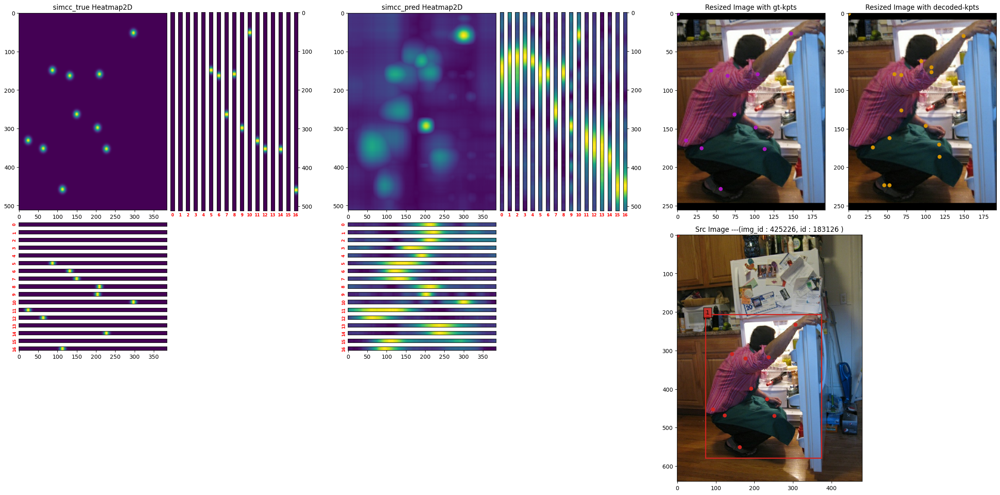

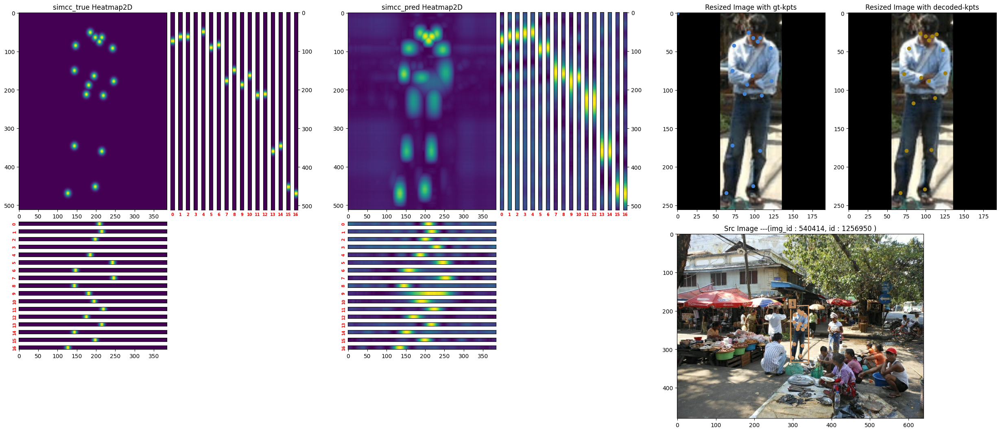

In [20]:
batch_val_dataset = val_tfds_builder.GenerateTargets(
    test_mode=True,     
    unpack_x_y_sample_weight= False, 
    ds_weights =None,
    show_PackTensorTypeSpec  = False,
    show_pipeline_cfg = True
)


batched_samples_list = [ model.encoder(feat) for feat in batch_val_dataset.take(2)]
batched_pred_list = [ model.predict(batched_samples) for batched_samples in batched_samples_list]
batched_pred_list[0]['decode_pred'].shape



vis_fn = Vis_TopdownPoseSimCCLabelCodec(
    simicc_split_xy_dim  = (192*2, 256*2),
    figsize = (24, 8),
    sel_batch_ids  = [0]
)

vis_fn(
    batched_samples_list = batched_pred_list,
)


In [18]:
batched_pred_list[0].keys()

dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'transform2src', 'y_true', 'sample_weight', 'y_pred', 'decode_pred'])

In [26]:
dict_1 = dict(a=1, b=None)
dict_2 = dict(c=1, b=4)
dict_3 = dict()
{**dict_1 ,**dict_2,**dict_3}
# a  = [1, 1]
# all(a)
# keys = ["opip", "apec"]
# data = dict()
# for key in keys :
#     data[key] = 2

a = [1,1]
all(a,1)

TypeError: all() takes exactly one argument (2 given)

h:\deep_learning\project_sample_V0.7.2\lib\datasets\tfds_builder.py:291: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")



 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x0000018D1B081280>
< 2 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x0000018D1B081130>
< 3 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x0000018F20418160>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
src_image ----- RaggedTensorSpec(TensorShape([128, None, None, 3]), tf.uint8, 2, tf.int64)
src_height ----- TensorSpec(shape=(128,), dtype=tf.int64, name=None)
src_width ----- TensorSpec(shape=(128,), dtype=tf.int64, name=None)
src_keypoints ----- RaggedTensorSpec(TensorShape([128, None]), tf.float32, 1, tf.int64)
src_bbox ----- TensorSpec(shape=(128, 4), dtype=tf.float32, name=None)
src_num_keypoints ----- TensorSpec(shape=(128,), dt

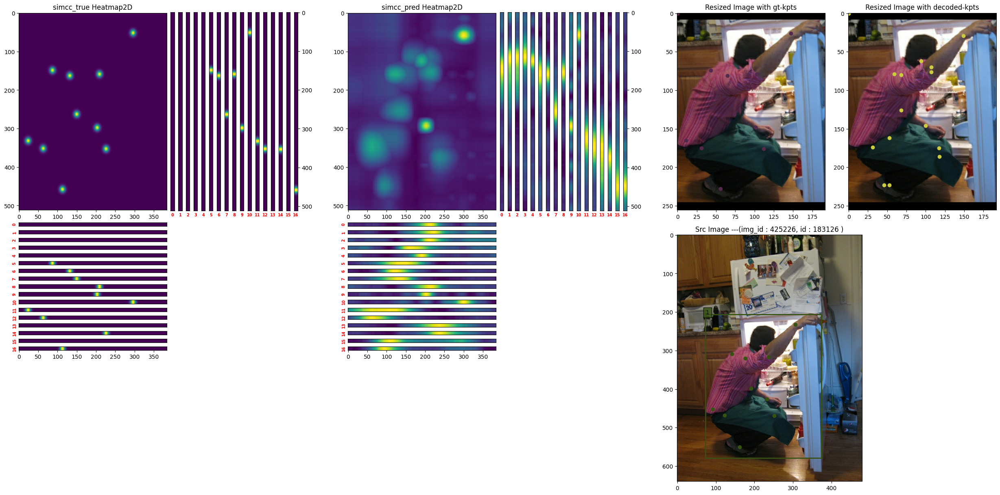

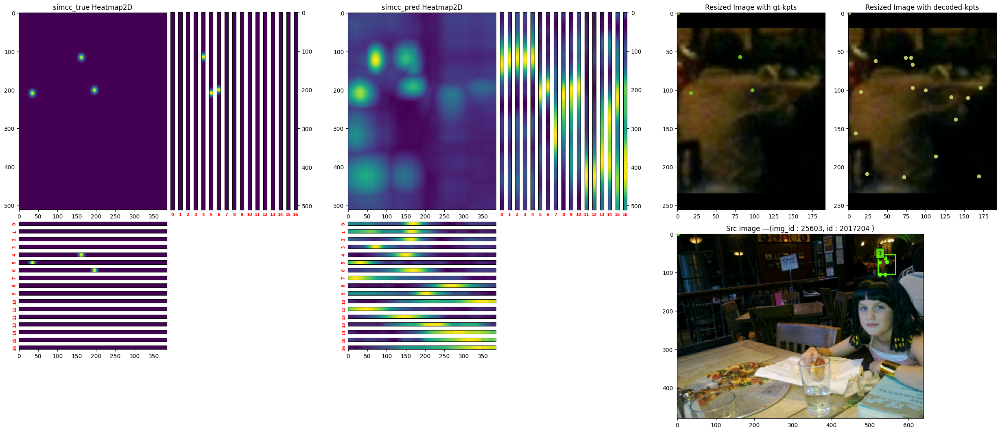

In [76]:
from typing import Dict, List, Optional, Tuple, Union, Any, Sequence, Callable
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from tensorflow import Tensor
class BasePoseVisFun:
    VERSION = '1.0.0'

    r""" 
    
        y_preds : Optional[List[Tensor]] = None,
        decoded_preds : Optional[List[Tensor]] = None,
        encoded_trues : Optional[List[Tensor]] = None,
        kpts : Optional[List[Tensor]] = None,
        bboxes : Optional[List[Tensor]] = None,
        labels : Optional[List[Tensor]] = None,
        src_imgs : Optional[List[Tensor]] = None,
        src_kpts : Optional[List[Tensor]] = None,
        src_bboxes : Optional[List[Tensor]] = None,
        src_labels : Optional[List[Tensor]] = None,
        src_img_ids : Optional[List[Tensor]] = None,
        src_ids : Optional[List[Tensor]] = None,  

    """
    def __init__(
            self, 
            figsize : Tuple[int] = (24, 8),
            take_batch_num : int = 1,
            sel_batch_ids : Optional[List[int]] = [0]
    ):
        self.figsize = figsize
        self.sel_batch_ids = sel_batch_ids
        self.num_batched_samples = None
        self.take_batch_num = take_batch_num
        self.batched_samples_list = []

    def parse_subplot_spec(self, subplot_spec, **kwargs):
        if type(subplot_spec)==tuple:
            plt.subplot(*subplot_spec,**kwargs)
        else:
            plt.subplot(subplot_spec, **kwargs)
        
    def base_plot(
        self, image, bboxes=None, labels=None, kpts=None, title='Image',subplot_spec=(1,1,1),**kwargs
    ):  
        
        self.parse_subplot_spec(
            subplot_spec=subplot_spec, **kwargs
        )
        plt.title(
            title, fontsize = 12
        )
        plt.imshow(image)
        if bboxes is not None and bboxes.shape.rank==3 :
            num_obj = bboxes.shape[0]
            ith_obj = -1 
        else:
            num_obj = 1 # single pose

        num_obj = bboxes.shape[0] if bboxes is not None and bboxes.shape.rank==3 else 1
        ith_obj = -1 
        for i in range(num_obj):   
            label = labels[i] if labels is not None else 1
            if label==1: 
                color = np.random.uniform(
                    low=0., high=1., size=3
                )
                ith_obj +=1

            if bboxes is not None :   
                bbox = bboxes[i] if num_obj!=1 else bboxes
                x1, y1, w, h = bbox
                ax = plt.gca() 
                patch = plt.Rectangle(
                    [x1, y1], w, h, 
                    fill=False, 
                    edgecolor=color, 
                    linewidth=2
                )
                ax.add_patch(patch)
                text = "{}".format(label)
                ax.text(
                    x1, y1, text,
                    bbox={"facecolor": color, "alpha": 0.8},
                    clip_box=ax.clipbox,
                    clip_on=True,
                )

            if kpts is not  None and label == 1 :
                kpt_ith = kpts[ith_obj] if num_obj!=1 else kpts
                for j in range(0,kpt_ith.shape[0]):
                    kps_x = int((kpt_ith[j,0]))
                    kps_y = int((kpt_ith[j,1]))
                    plt.scatter(kps_x,kps_y, color=color)

    def heatmaps_plot(
            self,  
            y_trues : Tensor, 
            sum_axis= -1, 
            title : str='heatmap', 
            subplot_spec=(1,1,1),
            **kwargs
    ):
        self.parse_subplot_spec(subplot_spec=subplot_spec)
        plt.title(title, fontsize = 12)
        heatmaps = y_trues.numpy()
        plt.imshow(heatmaps.sum(axis=sum_axis))


    def xy_heatmaps_plot(
        self, 
        gs : gridspec.GridSpec,
        x_heatmaps : Tensor, 
        y_heatmaps : Tensor, 
        lt_start_gxy : Tuple[int] = (0,0), 
        title = "simcc_",
        hm_1d_size : int = 5,
        hm_1d_intervel_row : int = 5,
        hm_1d_intervel_col : int = 5,
    ): 
        if not isinstance(gs,gridspec.GridSpec):
            raise TypeError(
                f"input 'gs' must be  matplotlib.gridspec.GridSpec type in xy_heatmaps_plot() "
                f"but got {type(gs)} @ {self.__class__.__name__} "
            ) 
        num_joints = y_heatmaps.shape[0]
        lt_start_gx, lt_start_gy = lt_start_gxy
        heatmaps_2d = x_heatmaps[:,None,:]*y_heatmaps[:,:,None] #(17,simcc_y, simcc_x)
        hm_2d_size_hw = heatmaps_2d.shape[1:] #(512,384)
        heatmaps_2d = tf.reduce_max(heatmaps_2d, axis=0).numpy()
       
        '2d heatmap'
        plt.subplot(
            gs[lt_start_gy:lt_start_gy + hm_2d_size_hw[0]//2, lt_start_gx:lt_start_gx+hm_2d_size_hw[1]//2]
        )
        plt.title(
            title + "Heatmap2D", fontsize = 12
        )
        plt.imshow(heatmaps_2d)
        '1d heatmap'
        start_gy = lt_start_gy + hm_2d_size_hw[0]//2+hm_1d_intervel_row+10
        start_gx = lt_start_gx  + hm_2d_size_hw[1]//2+hm_1d_intervel_col
        
        for i in range(num_joints) :
            x_heatmap = x_heatmaps[i][None,:]
            ax2 = plt.subplot(gs[start_gy:start_gy+hm_1d_size, lt_start_gx:lt_start_gx+hm_2d_size_hw[1]//2])
            plt.imshow(x_heatmap, aspect='auto')
            ax2.set_yticks([])
            if i!=num_joints-1 :
                ax2.set_xticks([])
            ax2.set_ylabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red')
            start_gy += hm_1d_intervel_row+hm_1d_size


            y_heatmap = y_heatmaps[i][:, None] 
            ax2 = plt.subplot(gs[ lt_start_gy: lt_start_gy + hm_2d_size_hw[0]//2, start_gx:start_gx+hm_1d_size])
            plt.imshow(y_heatmap, aspect='auto')
            if i!=num_joints-1 :
                ax2.set_yticks([])
            else:
                ax2.yaxis.set_label_position("right")
                ax2.yaxis.tick_right()
            ax2.set_xticks([])
            ax2.set_xlabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red') 
            start_gx += hm_1d_intervel_col+hm_1d_size  

    def src_img_plot(
        self,
        src_img : Tensor,
        subplot_spec =(1,1,1),
        title : str = 'src_image',
        src_kpts : Optional[Tensor] = None,
        src_bboxes : Optional[Tensor] = None,
        src_labels : Optional[Tensor]= None,
        src_img_id : Optional[Tensor] = None,
        src_ids : Optional[Tensor] = None,
        **kwargs
        
    ):
        if src_img_id is not None:
            #extra_text =title + f" ---(img_id : {image_id}, id : {instance_id} if )"
            title = title + f" ---(img_id : {image_id} )"

        self.base_plot(
            image = src_img, 
            bboxes=src_bboxes, 
            labels=src_labels, 
            kpts=src_kpts, 
            title=title,
            subplot_spec=subplot_spec,
            **kwargs  
        )


    

    def map_data_structure(
        self, data : dict
    )->tuple:
        
        num_batched_samples = None
        batch_size = 0

        for key, val in data.items():

            if val==None:
               continue  
            if val==[]:
               data[key] = None
               continue 

            if isinstance(val, Tensor):
                val = [ val ]

            if isinstance(val, list) : 
                'get and verify batch_size'
                if not batch_size :
                    batch_size =val[0].shape[0] 
                    print(f"batch_size : {batch_size}")
                else:
                    #print(key, batch_size, type(val[0]))
                    assert(val[0].shape[0]==batch_size) 
                
                data[key] =  tf.stack(
                    val, axis=0
                )
                'get and verify num_batched_samples'
                if not num_batched_samples :
                    num_batched_samples = data[key].shape[0]
                else:
                    assert(data[key].shape[0]==num_batched_samples) 

            else:
                raise TypeError(
                    f""
                )  
               
        return data , num_batched_samples  

    def extract_key_samples(
        self, samples_list : List[Dict[str,Tensor]], key : str, fn =None
    ) : 
        data = []
        for samples in samples_list :
            if isinstance(samples, dict):
                val = samples.get(key, None)
            else:
                val = samples
        
            if val == None :
                return None
            else:
                data.append(fn(val) if isinstance(fn, Callable) else None)
        return data

    def call(
        self,  **kwargs
    ):
        r"""
        args :
            img : Tensor,
            y_pred : Optional[Tensor] = None,
            decode_pred : Optional[Tensor] = None,
            encode_true : Optional[Tensor] = None,
            kpts : Optional[Tensor] = None,
            bboxes : Optional[Tensor] = None,
            labels : Optional[Tensor] = None,
            src_img : Optional[Tensor] = None,
            src_kpts : Optional[Tensor] = None,
            src_bboxes : Optional[Tensor] = None,
            src_labels : Optional[Tensor] = None,
            src_img_id : Optional[Tensor] = None,
            src_ids : Optional[Tensor] = None,
        
 
        """
        raise NotImplementedError()

    # def __call__(
    #     self, **kwargs
    # )-> None :
    #     R""" args :

        
    #     """
    #     if all( [(val==None or val==[]) for val in kwargs.values()]):
    #         raise ValueError(
    #             f"all input values are None or [], please check input data"
    #     ) 

    #     tf_data  , num_batched_samples  = self.map_data_structure(kwargs)

    #     for i in range(num_batched_samples):
    #         for batch_id in self.sel_batch_ids:
    #             sel_data = tf.nest.map_structure(
    #                 lambda x : x[i, batch_id,...] if x is not None else None, tf_data     
    #             ) 
    #             'sel_data (single one sample) for ploting'
    #             self.call(**sel_data) 

    def parse_tf_dataset(
            self, tf_dataset, tf_model
        ) :
        r""" Example 
        
        """
        raise NotImplementedError()


    def __call__(
        self, 
        tf_dataset : Optional[tf.data.Dataset]=None,  
        tf_model : Optional[BaseModel] = None, 
        **kwargs
    )-> None :
        
        R""" args :

        
        """
        if isinstance(tf_dataset, tf.data.Dataset) :
            tf_data , num_batched_samples  =  self.parse_tf_dataset(tf_dataset,  tf_model)
        else:
            if all( [(val==None or val==[]) for val in kwargs.values()]):
                raise ValueError(
                    f"all input values are None or [], please check input data"
            ) 
            tf_data  , num_batched_samples  = self.map_data_structure(kwargs)

        for i in range(num_batched_samples):
            for batch_id in self.sel_batch_ids:
                sel_data = tf.nest.map_structure(
                    lambda x : x[i, batch_id,...] if x is not None else None, tf_data     
                ) 
                'sel_data (single one sample) for ploting'
                self.call(**sel_data)             
             


class Vis_TopdownPoseSimCCLabelCodec(BasePoseVisFun):
    VERSION = '1.0.0'

    R"""  Vis_TopdownPoseSimCCLabelCodec
    
    i.e. :
        batch_val_dataset = val_tfds_builder.GenerateTargets(
            test_mode=True,     
            unpack_x_y_sample_weight= False, 
        )

        batched_samples_list = [ model.encoder(feat) for feat in batch_val_dataset.take(2)]
        encoded_trues_list = [ batched_samples['y_true'] for batched_samples in batched_samples_list]
        batched_images_list = [ batched_samples['image'] for batched_samples in batched_samples_list]
        batched_kpts_list = [ batched_samples['kps'] for batched_samples in batched_samples_list]
        batched_pred_list = [ model(batched_samples['image']) for batched_samples in batched_samples_list]
        batched_decode_pred_list = [ model.decoder(batched_samples) for batched_samples in batched_pred_list]
        batched_src_imgs_list = [ batched_samples['meta_info']['src_image'] for batched_samples in batched_samples_list]
        batched_src_kpts_list =  [ tf.reshape(batched_samples['meta_info']['src_keypoints'],[-1,17,3])  for batched_samples in batched_samples_list]
        batched_src_bboxes_list = [ batched_samples['meta_info']['src_bbox'] for batched_samples in batched_samples_list]
        batched_src_img_ids_list = [ batched_samples['meta_info']['image_id'] for batched_samples in batched_samples_list]
        batched_src_ids_list = [ batched_samples['meta_info']['id'] for batched_samples in batched_samples_list]



        vis_fn = Vis_TopdownPoseSimCCLabelCodec(
            simicc_split_xy_dim  = (192*2, 256*2),
            figsize = (24, 8),
            sel_batch_ids  = [0]
        )
        vis_fn(
            img = batched_images_list,
            y_pred = batched_pred_list,
            decode_pred  = batched_decode_pred_list,
            encode_true  = encoded_trues_list,
            kpts = batched_kpts_list,
            bboxes  = None,
            labels = None,
            src_img  = batched_src_imgs_list,
            src_bboxes  = batched_src_bboxes_list,
            src_kpts  = batched_src_kpts_list,
            src_labels  = None,
            src_img_id  = batched_src_img_ids_list,
            src_ids = batched_src_ids_list,
        )

    """
    def __init__(
            self, 
            simicc_split_xy_dim : Tuple[int] = (192*2, 256*2),
            **kwargs
    ):
        super().__init__(**kwargs)
        self.simicc_split_xy_dim = simicc_split_xy_dim
        
    def parse_tf_dataset(
            self, 
            tf_dataset, 
            model
    ) :

        batched_samples_list = [model.encoder(feat) for feat in tf_dataset.take(self.take_batch_num)]
        y_pred = self.extract_key_samples(batched_samples_list, 'image',model)
        data = dict(
            img = self.extract_key_samples(batched_samples_list, 'image') ,
            y_pred = self.extract_key_samples(batched_samples_list, 'image',model) ,
            decode_pred = self.extract_key_samples(y_pred, 'image',model) ,
        )

    
    def call(
        self, 
        img : Tensor,
        y_pred : Optional[Tensor] = None,
        decode_pred : Optional[Tensor] = None,
        encode_true : Optional[Tensor] = None,
        kpts : Optional[Tensor] = None,
        bboxes : Optional[Tensor] = None,
        labels : Optional[Tensor] = None,
        src_img : Optional[Tensor] = None,
        src_kpts : Optional[Tensor] = None,
        src_bboxes : Optional[Tensor] = None,
        src_labels : Optional[Tensor] = None,
        src_img_id : Optional[Tensor] = None,
        src_ids : Optional[Tensor] = None,
        **kwargs
    )->None:
        
        r"""

        """
        '''

        '''
        np_resized_img =  None if img  is None else img.numpy()
        np_src_img = None if src_img is None else src_img.numpy()  
        image_id = '' if src_img_id is None else src_img_id
        instance_id = '' if src_ids is None else src_ids



        img_size_hw = (0,0) if np_resized_img is None else  np_resized_img.shape[:2]#(256,192)
        src_img_size_hw = (0,0)  if np_src_img is None else np_src_img.shape[:2]
        hm_2d_size_hw = (0, 0)
        hm_1d_num = 0
        hm_1d_size = 5
        hm_1d_intervel_row = 5
        hm_1d_intervel_col = 5
        subplot_intervel = 30 
       

        'encode data'
        plot_hm_true = False if encode_true is None else True
        if plot_hm_true :
            simcc_xy_heatmaps_true   = encode_true
            x_heatmaps_true , y_heatmaps_true = tf.split(simcc_xy_heatmaps_true, num_or_size_splits=[*self.simicc_split_xy_dim], axis=-1)
            hm_2d_size_hw = (y_heatmaps_true.shape[1], x_heatmaps_true.shape[1])
            hm_1d_num = x_heatmaps_true.shape[0] 


        'pred data (model output)'
        plot_hm_pred = False if y_pred is None else True
        if plot_hm_pred :
            simcc_xy_heatmaps_pred   = y_pred
            x_heatmaps_pred , y_heatmaps_pred = tf.split(simcc_xy_heatmaps_pred, num_or_size_splits=[*self.simicc_split_xy_dim], axis=-1)
            hm_2d_size_hw = (y_heatmaps_pred.shape[1], x_heatmaps_pred.shape[1])
            hm_1d_num = x_heatmaps_pred.shape[0] 

    

        "one simcc_hm_size_hw including 2d and 1d heatmap"
        simcc_hm_size_hw = (
           hm_2d_size_hw[0]//2 + hm_1d_intervel_row +10+(hm_1d_intervel_row+hm_1d_size)*hm_1d_num,
           (hm_2d_size_hw[1]//2 + hm_1d_intervel_col + (hm_1d_intervel_col+hm_1d_size)*hm_1d_num + subplot_intervel*2)
        )

        'set GridSpec'
        grid_rows = max(simcc_hm_size_hw[0] , img_size_hw[0] + subplot_intervel + src_img_size_hw[0]//2)
        grid_cols = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true) + max( img_size_hw[1]*2 + subplot_intervel, src_img_size_hw[1]//2)
        gs = gridspec.GridSpec(grid_rows, grid_cols)
        'set Image Size'
        fig_size_wh  = (grid_cols//40, grid_rows//40 ) #((hm_2d_size_hw[0]+extra_rows)//40, (hm_2d_size_hw[1]+extra_cols)//40)

        plt.figure(figsize=fig_size_wh)
        if  plot_hm_true:
            self.xy_heatmaps_plot(
                title = "simcc_true ",
                gs = gs,
                x_heatmaps = x_heatmaps_true, 
                y_heatmaps = y_heatmaps_true, 
                lt_start_gxy  = (0,0), 
                hm_1d_size = hm_1d_size,
                hm_1d_intervel_row = hm_1d_intervel_row,
                hm_1d_intervel_col = hm_1d_intervel_col,
            )
        if plot_hm_pred:
            a = simcc_hm_size_hw[1]*plot_hm_true
            self.xy_heatmaps_plot(
                title = "simcc_pred ",
                gs = gs,
                x_heatmaps = x_heatmaps_pred, 
                y_heatmaps = y_heatmaps_pred, 
                lt_start_gxy  = (a,0), 
                hm_1d_size = hm_1d_size,
                hm_1d_intervel_row = hm_1d_intervel_row,
                hm_1d_intervel_col = hm_1d_intervel_col,
            )   

        'resized_image'
        if all(img_size_hw) :
            start_x = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true)
            self.base_plot(
                title = f"Resized Image with gt-kpts",
                image = np_resized_img,
                kpts = kpts,
                bboxes = None,
                subplot_spec = gs[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

            )
        'resized_image # 2'
        #start_x = (hm_2d_size_hw[1]//2+subplot_intervel+hm_1d_num*(hm_1d_intervel_col+hm_1d_size)+subplot_intervel)
        if all(img_size_hw) :
            start_x += img_size_hw[1] + subplot_intervel
            self.base_plot(
                title = f"Resized Image with decoded-kpts",
                image = np_resized_img,
                kpts = decode_pred,
                bboxes = None,
                subplot_spec = gs[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

            )
        'src_image'
        if all(src_img_size_hw) :
            start_x = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true)
            start_y = img_size_hw[0]+subplot_intervel
            extra_text = f" ---(img_id : {image_id}, id : {instance_id} )"
            self.base_plot(
                title = f"Src Image" + extra_text,
                image = np_src_img,
                kpts = src_kpts,
                bboxes = src_bboxes,
                subplot_spec = gs[start_y:start_y + src_img_size_hw[0]//2, start_x:start_x+src_img_size_hw[1]//2]

            )


batch_val_dataset = val_tfds_builder.GenerateTargets(
    test_mode=True,     
    unpack_x_y_sample_weight= False, 
    ds_weights =None,
    show_PackTensorTypeSpec  = True,
    show_pipeline_cfg = True
)

batched_samples_list = [ model.encoder(feat) for feat in batch_val_dataset.take(2)]

encoded_trues_list = [ batched_samples['y_true'] for batched_samples in batched_samples_list]
batched_images_list = [ batched_samples['image'] for batched_samples in batched_samples_list]
batched_kpts_list = [ batched_samples['kps'] for batched_samples in batched_samples_list]
batched_pred_list = [ model(batched_samples['image']) for batched_samples in batched_samples_list]
batched_decode_pred_list = [ model.decoder(batched_samples) for batched_samples in batched_pred_list]
batched_src_imgs_list = [ batched_samples['meta_info']['src_image'] for batched_samples in batched_samples_list]
batched_src_kpts_list =  [ tf.reshape(batched_samples['meta_info']['src_keypoints'],[-1,17,3])  for batched_samples in batched_samples_list]
batched_src_bboxes_list = [ batched_samples['meta_info']['src_bbox'] for batched_samples in batched_samples_list]
batched_src_img_ids_list = [ batched_samples['meta_info']['image_id'] for batched_samples in batched_samples_list]
batched_src_ids_list = [ batched_samples['meta_info']['id'] for batched_samples in batched_samples_list]



vis_fn = Vis_TopdownPoseSimCCLabelCodec(
    simicc_split_xy_dim  = (192*2, 256*2),
    figsize = (24, 8),
    sel_batch_ids  = [0]
)
vis_fn(
    img = batched_images_list,
    y_pred = batched_pred_list,
    decode_pred  = batched_decode_pred_list,
    encode_true  = encoded_trues_list,
    kpts = batched_kpts_list,
    bboxes  = None,
    labels = None,
    src_img  = batched_src_imgs_list,
    src_bboxes  = batched_src_bboxes_list,
    src_kpts  = batched_src_kpts_list,
    src_labels  = None,
    src_img_id  = batched_src_img_ids_list,
    src_ids = batched_src_ids_list,
)





In [78]:
a = None
from typing import Dict, List, Optional, Tuple, Union, Any, Sequence, Callable
isinstance(a, Callable)

False

In [54]:
type(batch_val_dataset)
isinstance(batch_val_dataset, tf.data.Dataset)
isinstance(None, BaseModel)
a = []
print(a)
b = dict(opip=1)
a.extend( [ b['opip'] ] if b.get('opip',None) else [])
print(a)

[]
[1]


In [69]:
b = dict(opip=1)
a.extend( [ b.get('apenc', null)])
print(a)

NameError: name 'null' is not defined


 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x7f93a0371160>
< 2 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x7f93c0ddbca0>
< 3 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7f92e92c5160>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
src_image ----- RaggedTensorSpec(TensorShape([128, None, None, 3]), tf.uint8, 2, tf.int64)
src_height ----- TensorSpec(shape=(128,), dtype=tf.int64, name=None)
src_width ----- TensorSpec(shape=(128,), dtype=tf.int64, name=None)
src_keypoints ----- RaggedTensorSpec(TensorShape([128, None]), tf.float32, 1, tf.int64)
src_bbox ----- TensorSpec(shape=(128, 4), dtype=tf.float32, name=None)
src_num_keypoints ----- TensorSpec(shape=(128,), dtype=tf.int64

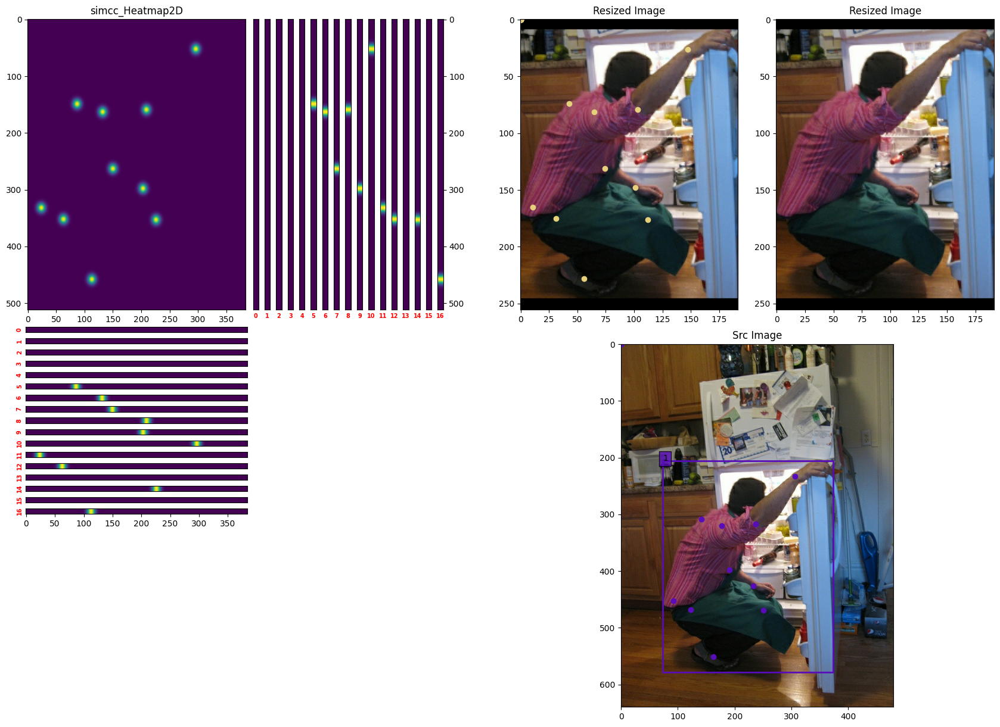

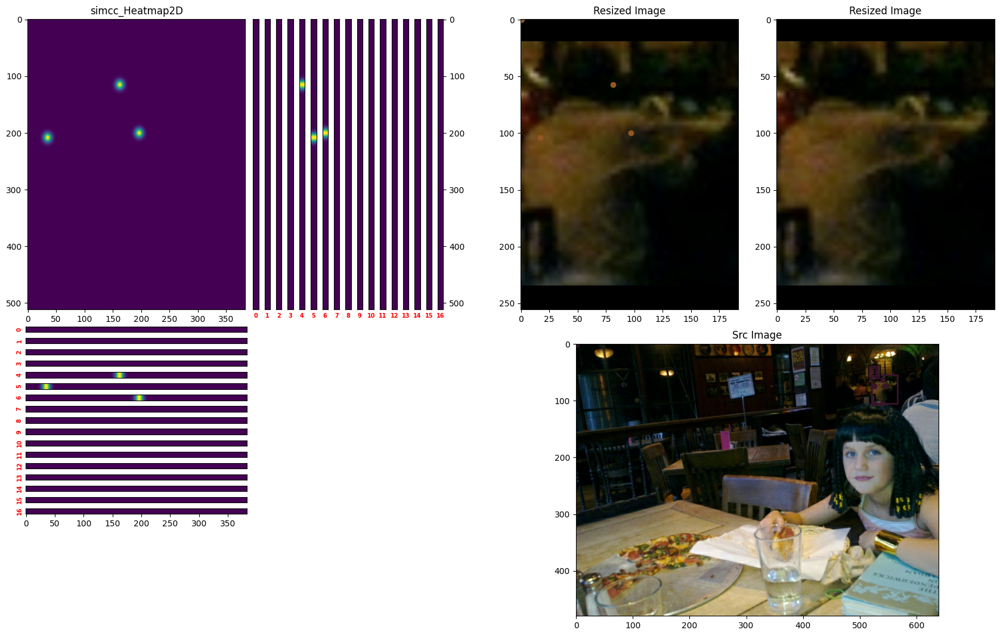

In [51]:
from typing import Dict, List, Optional, Tuple, Union, Any, Sequence
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from tensorflow import Tensor
class BasePoseVisFun:
    VERSION = '1.0.0'

    r""" 
    
        y_preds : Optional[List[Tensor]] = None,
        decoded_preds : Optional[List[Tensor]] = None,
        encoded_trues : Optional[List[Tensor]] = None,
        kpts : Optional[List[Tensor]] = None,
        bboxes : Optional[List[Tensor]] = None,
        labels : Optional[List[Tensor]] = None,
        src_imgs : Optional[List[Tensor]] = None,
        src_kpts : Optional[List[Tensor]] = None,
        src_bboxes : Optional[List[Tensor]] = None,
        src_labels : Optional[List[Tensor]] = None,
        src_img_ids : Optional[List[Tensor]] = None,
        src_ids : Optional[List[Tensor]] = None,  

    """
    def __init__(
            self, 
            figsize : Tuple[int] = (24, 8),
            sel_batch_ids : Optional[List[int]] = [0],
    ):
        self.figsize = figsize
        self.sel_batch_ids = sel_batch_ids

    def parse_subplot_spec(self, subplot_spec, **kwargs):
        if type(subplot_spec)==tuple:
            plt.subplot(*subplot_spec,**kwargs)
        else:
            plt.subplot(subplot_spec, **kwargs)
        
    def base_plot(
        self, image, bboxes=None, labels=None, kpts=None, title='Image',subplot_spec=(1,1,1),**kwargs
    ):  
        
        self.parse_subplot_spec(
            subplot_spec=subplot_spec, **kwargs
        )
        plt.title(
            title, fontsize = 12
        )
        plt.imshow(image)
        if bboxes is not None and bboxes.shape.rank==3 :
            num_obj = bboxes.shape[0]
            ith_obj = -1 
        else:
            num_obj = 1 # single pose

        num_obj = bboxes.shape[0] if bboxes is not None and bboxes.shape.rank==3 else 1
        ith_obj = -1 
        for i in range(num_obj):   
            label = labels[i] if labels is not None else 1
            if label==1: 
                color = np.random.uniform(
                    low=0., high=1., size=3
                )
                ith_obj +=1

            if bboxes is not None :   
                bbox = bboxes[i] if num_obj!=1 else bboxes
                x1, y1, w, h = bbox
                ax = plt.gca() 
                patch = plt.Rectangle(
                    [x1, y1], w, h, 
                    fill=False, 
                    edgecolor=color, 
                    linewidth=2
                )
                ax.add_patch(patch)
                text = "{}".format(label)
                ax.text(
                    x1, y1, text,
                    bbox={"facecolor": color, "alpha": 0.8},
                    clip_box=ax.clipbox,
                    clip_on=True,
                )

            if kpts is not  None and label == 1 :
                kpt_ith = kpts[ith_obj] if num_obj!=1 else kpts
                for j in range(0,kpt_ith.shape[0]):
                    kps_x = int((kpt_ith[j,0]))
                    kps_y = int((kpt_ith[j,1]))
                    plt.scatter(kps_x,kps_y, color=color)

    def heatmaps_plot(
            self,  
            y_trues : Tensor, 
            sum_axis= -1, 
            title : str='heatmap', 
            subplot_spec=(1,1,1),
            **kwargs
    ):
        self.parse_subplot_spec(subplot_spec=subplot_spec)
        plt.title(title, fontsize = 12)
        heatmaps = y_trues.numpy()
        plt.imshow(heatmaps.sum(axis=sum_axis))


    def xy_heatmaps_plot(
        self, 
        gs : gridspec.GridSpec,
        x_heatmaps : Tensor, 
        y_heatmaps : Tensor, 
        lt_start_gxy : Tuple[int] = (0,0), 
        title = "simcc_",
        hm_1d_size : int = 5,
        hm_1d_intervel_row : int = 5,
        hm_1d_intervel_col : int = 5,
    ): 
        if not isinstance(gs,gridspec.GridSpec):
            raise TypeError(
                f"input 'gs' must be  matplotlib.gridspec.GridSpec type in xy_heatmaps_plot() "
                f"but got {type(gs)} @ {self.__class__.__name__} "
            ) 
        num_joints = y_heatmaps.shape[0]
        lt_start_gx, lt_start_gy = lt_start_gxy
        heatmaps_2d = x_heatmaps[:,None,:]*y_heatmaps[:,:,None] #(17,simcc_y, simcc_x)
        hm_2d_size_hw = heatmaps_2d.shape[1:] #(512,384)
        heatmaps_2d = tf.reduce_max(heatmaps_2d, axis=0).numpy()
       
        '2d heatmap'
        plt.subplot(
            gs[lt_start_gy:lt_start_gy + hm_2d_size_hw[0]//2, lt_start_gx:lt_start_gx+hm_2d_size_hw[1]//2]
        )
        plt.title(
            title + "Heatmap2D", fontsize = 12
        )
        plt.imshow(heatmaps_2d)
        '1d heatmap'
        start_gy = lt_start_gy + hm_2d_size_hw[0]//2+hm_1d_intervel_row+10
        start_gx = lt_start_gx  + hm_2d_size_hw[1]//2+hm_1d_intervel_col
        
        for i in range(num_joints) :
            x_heatmap = x_heatmaps[i][None,:]
            ax2 = plt.subplot(gs[start_gy:start_gy+hm_1d_size, lt_start_gx:lt_start_gx+hm_2d_size_hw[1]//2])
            plt.imshow(x_heatmap, aspect='auto')
            ax2.set_yticks([])
            if i!=num_joints-1 :
                ax2.set_xticks([])
            ax2.set_ylabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red')
            start_gy += hm_1d_intervel_row+hm_1d_size


            y_heatmap = y_heatmaps[i][:, None] 
            ax2 = plt.subplot(gs[ lt_start_gy: lt_start_gy + hm_2d_size_hw[0]//2, start_gx:start_gx+hm_1d_size])
            plt.imshow(y_heatmap, aspect='auto')
            if i!=num_joints-1 :
                ax2.set_yticks([])
            else:
                ax2.yaxis.set_label_position("right")
                ax2.yaxis.tick_right()
            ax2.set_xticks([])
            ax2.set_xlabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red') 
            start_gx += hm_1d_intervel_col+hm_1d_size  

    def src_img_plot(
        self,
        src_img : Tensor,
        subplot_spec =(1,1,1),
        title : str = 'src_image',
        src_kpts : Optional[Tensor] = None,
        src_bboxes : Optional[Tensor] = None,
        src_labels : Optional[Tensor]= None,
        src_img_id : Optional[Tensor] = None,
        src_ids : Optional[Tensor] = None,
        **kwargs
        
    ):
        if src_img_id is not None:
            #extra_text =title + f" ---(img_id : {image_id}, id : {instance_id} if )"
            title = title + f" ---(img_id : {image_id} )"

        self.base_plot(
            image = src_img, 
            bboxes=src_bboxes, 
            labels=src_labels, 
            kpts=src_kpts, 
            title=title,
            subplot_spec=subplot_spec,
            **kwargs  
        )

    def map_data_structure(self, **kwargs):
        num_batched_samples = None
        batch_size = 0
        #print(kwargs.keys(), kwargs[])
        #data = dict()
        if all( [(val==None or val==[]) for val in kwargs.values()]):
            raise ValueError(
                f""
            ) 
        
        for key, val in kwargs.items():
            if val==[] or val==None:
               kwargs[key] = None 
               continue 

            if isinstance(val, Tensor):
                val = [ val ]
                
            if isinstance(val, list) : 
                # 'get and verify batch_size'
                if not batch_size :
                    batch_size = val[0].shape[0] 
                    #print(f"batch_size : {batch_size}")
                else:
                    assert(
                        val[0].shape[0]==batch_size
                    ) 
    
                kwargs[key] =  tf.stack(
                    val, axis=0
                )
                'get and verify num_batched_samples'
                if not num_batched_samples :
                    num_batched_samples = kwargs[key].shape[0]
                else:
                    assert(kwargs[key].shape[0]==num_batched_samples) 

            else:
                raise TypeError(
                    f""
                )  
               
        return kwargs , num_batched_samples   
    

    def map_data_structure(
            self, 
            data : dict
    )->tuple:
        
        num_batched_samples = None
        batch_size = 0
        if all( [(val==None or val==[]) for val in data.values()]):
            raise ValueError(
                f""
            ) 
        for key, val in data.items():

            if val==None:
               continue  
            if val==[]:
               data[key] = None
               continue 

            if isinstance(val, Tensor):
                val = [ val ]

            if isinstance(val, list) : 
                # 'get and verify batch_size'
                if not batch_size :
                    batch_size =val[0].shape[0] 
                    print(f"batch_size : {batch_size}")
                else:
                    #print(key, batch_size, type(val[0]))
                    assert(val[0].shape[0]==batch_size) 
                
                data[key] =  tf.stack(
                    val, axis=0
                )
                'get and verify num_batched_samples'
                if not num_batched_samples :
                    num_batched_samples = data[key].shape[0]
                else:
                    assert(data[key].shape[0]==num_batched_samples) 

            else:
                raise TypeError(
                    f""
                )  
               
        return data , num_batched_samples  

    def call(
        self, 
        img : Tensor,
        y_pred : Optional[Tensor] = None,
        decode_pred : Optional[Tensor] = None,
        encode_true : Optional[Tensor] = None,
        kpts : Optional[Tensor] = None,
        bboxes : Optional[Tensor] = None,
        labels : Optional[Tensor] = None,
        src_img : Optional[Tensor] = None,
        src_kpts : Optional[Tensor] = None,
        src_bboxes : Optional[Tensor] = None,
        src_labels : Optional[Tensor] = None,
        src_img_id : Optional[Tensor] = None,
        src_ids : Optional[Tensor] = None,
        **kwargs
    ):
        r"""
        DATA_KEYS_MAP = {
            'batched_imgs_list' : 'img', 
            'batched_preds_list' : 'y_pred', 
            'batched_decode_preds_list' : 'decode_pred', 
            'batched_encode_trues_list' : 'encode_true',
            'batched_kpts_list' : 'kpts', 
            'batched_bboxes_list' : 'bboxes', 
            'batched_labels_list' : 'labels', 
            'batched_src_imgs_list' : 'src_img', 
            'batched_src_bboxes_list' : 'src_bboxes', 
            'batched_src_labels_list' : 'src_labels', 
            'batched_src_kpts_list' : 'src_kpts',, 
            'batched_src_img_ids_list' : 'src_img_id',  
            'batched_src_ids_list' : : 'src_img_id',
        }
 
        """
        raise NotImplementedError()

    def __call__(
        self, 
        img : Union[List[Tensor], Tensor] = None,
        y_pred : Union[List[Tensor], Tensor] = None,
        decode_pred : Union[List[Tensor], Tensor] = None,
        encode_true :Union[List[Tensor], Tensor] = None,
        kpts :  Union[List[Tensor], Tensor]= None,
        bboxes : Union[List[Tensor], Tensor]= None,
        labels :  Union[List[Tensor], Tensor] = None,
        src_img :  Union[List[Tensor], Tensor] = None,
        src_kpts :  Union[List[Tensor], Tensor]= None,
        src_bboxes :  Union[List[Tensor], Tensor] = None,
        src_labels : Union[List[Tensor], Tensor]= None,
        src_img_id :  Union[List[Tensor], Tensor]= None,
        src_ids :  Union[List[Tensor], Tensor] = None,
        **kwargs
    )-> None :
        R""" args :

        
        """
        lcls = locals()
        lcls.pop('self')
        cfg = lcls.pop('kwargs')
        #print(lcls.keys())
        
        #tf_data  , num_batched_samples  = self.map_data_structure(**lcls)
        tf_data  , num_batched_samples  = self.map_data_structure(lcls)
        for i in range(num_batched_samples):
            for batch_id in self.sel_batch_ids:
                sel_data = tf.nest.map_structure(
                    lambda x : x[i, batch_id,...] if x is not None else None, tf_data     
                ) 
                'sel_data (single one sample) for ploting'
                self.call(**sel_data, **cfg) 


        

class Vis_TopdownPoseSimCCLabelCodec(BasePoseVisFun):
    def __init__(
            self, 
            simicc_split_xy_dim : Tuple[int] = (192*2, 256*2),
            **kwargs
    ):
        super().__init__(**kwargs)
        self.simicc_split_xy_dim = simicc_split_xy_dim
        

    def call(
        self, 
        img : Tensor,
        y_pred : Optional[Tensor] = None,
        decode_pred : Optional[Tensor] = None,
        encode_true : Optional[Tensor] = None,
        kpts : Optional[Tensor] = None,
        bboxes : Optional[Tensor] = None,
        labels : Optional[Tensor] = None,
        src_img : Optional[Tensor] = None,
        src_kpts : Optional[Tensor] = None,
        src_bboxes : Optional[Tensor] = None,
        src_labels : Optional[Tensor] = None,
        src_img_id : Optional[Tensor] = None,
        src_ids : Optional[Tensor] = None,
        **kwargs
    )->None:
        
        r"""
        DATA_KEYS_MAP = {
            'batched_imgs_list' : 'img', 
            'batched_preds_list' : 'y_pred', 
            'batched_decode_preds_list' : 'decode_pred', 
            'batched_encode_trues_list' : 'encode_true',
            'batched_kpts_list' : 'kpts', 
            'batched_bboxes_list' : 'bboxes', 
            'batched_labels_list' : 'labels', 
            'batched_src_imgs_list' : 'src_img', 
            'batched_src_bboxes_list' : 'src_bboxes', 
            'batched_src_labels_list' : 'src_labels', 
            'batched_src_kpts_list' : 'src_kpts',, 
            'batched_src_img_ids_list' : 'src_img_id',  
            'batched_src_ids_list' : : 'src_img_id',
        }
        """
        '''

        '''
        np_resized_img =  None if img  is None else img.numpy()
        np_src_img = None if src_img is None else src_img.numpy()  

        
        img_size_hw = (0,0) if np_resized_img is None else  np_resized_img.shape[:2]#(256,192)
        src_img_size_hw = (0,0)  if np_src_img is None else np_src_img.shape[:2]
        hm_2d_size_hw = (0, 0)
        hm_1d_num = 0
        hm_1d_size = 5
        hm_1d_intervel_row = 5
        hm_1d_intervel_col = 5
        subplot_intervel = 30 

        'encode data'
        plot_hm_true = False if encode_true is None else True
        if plot_hm_true :
            simcc_xy_heatmaps_true   = encode_true
            x_heatmaps_true , y_heatmaps_true = tf.split(simcc_xy_heatmaps_true, num_or_size_splits=[*self.simicc_split_xy_dim], axis=-1)
            hm_2d_size_hw = (y_heatmaps_true.shape[1], x_heatmaps_true.shape[1])
            hm_1d_num = x_heatmaps_true.shape[0] 


        'pred data (model output)'
        plot_hm_pred = False if y_pred is None else True
        if plot_hm_pred :
            simcc_xy_heatmaps_pred   = y_pred
            x_heatmaps_pred , y_heatmaps_pred = tf.split(simcc_xy_heatmaps_pred, num_or_size_splits=[*self.simicc_split_xy_dim], axis=-1)
            hm_2d_size_hw = (y_heatmaps_pred.shape[1], x_heatmaps_pred.shape[1])
            hm_1d_num = x_heatmaps_pred.shape[0] 

        "one simcc_hm_size_hw including 2d and 1d heatmap"
        simcc_hm_size_hw = (
           hm_2d_size_hw[0]//2 + hm_1d_intervel_row +10+(hm_1d_intervel_row+hm_1d_size)*hm_1d_num,
           (hm_2d_size_hw[1]//2 + hm_1d_intervel_col + (hm_1d_intervel_col+hm_1d_size)*hm_1d_num + subplot_intervel*2)
        )

        'set GridSpec'
        grid_rows = max(simcc_hm_size_hw[0] , img_size_hw[0] + subplot_intervel + src_img_size_hw[0]//2)
        grid_cols = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true) + max( img_size_hw[1]*2 + subplot_intervel, src_img_size_hw[1]//2)
        gs = gridspec.GridSpec(grid_rows, grid_cols)
        'set Image Size'
        fig_size_wh  = (grid_cols//40, grid_rows//40 ) #((hm_2d_size_hw[0]+extra_rows)//40, (hm_2d_size_hw[1]+extra_cols)//40)

        plt.figure(figsize=fig_size_wh)
        if  plot_hm_true:
            self.xy_heatmaps_plot(
                title = "simcc_",
                gs = gs,
                x_heatmaps = x_heatmaps_true, 
                y_heatmaps = y_heatmaps_true, 
                lt_start_gxy  = (0,0), 
                hm_1d_size = hm_1d_size,
                hm_1d_intervel_row = hm_1d_intervel_row,
                hm_1d_intervel_col = hm_1d_intervel_col,
            )
        # if plot_hm_true:
        #     a = hm_2d_size_hw[1]//2 + hm_1d_intervel_row+ (hm_1d_intervel_row+hm_1d_size)*hm_1d_num + subplot_intervel*2 
        #     self.xy_heatmaps_plot(
        #         title = "simcc_",
        #         gs = gs,
        #         x_heatmaps = x_heatmaps_true, 
        #         y_heatmaps = y_heatmaps_true, 
        #         lt_start_gxy  = (a,0), 
        #         hm_1d_size = hm_1d_size,
        #         hm_1d_intervel_row = hm_1d_intervel_row,
        #         hm_1d_intervel_col = hm_1d_intervel_col,
        #     )   


        'resized_image'
        start_x = (hm_2d_size_hw[1]//2+subplot_intervel+hm_1d_num*(hm_1d_intervel_col+hm_1d_size)+subplot_intervel)

        start_x = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true)
        self.base_plot(
            title = f"Resized Image",
            image = np_resized_img,
            kpts = kpts,
            bboxes = None,
            subplot_spec = gs[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

        )
        'resized_image # 2'
        #start_x = (hm_2d_size_hw[1]//2+subplot_intervel+hm_1d_num*(hm_1d_intervel_col+hm_1d_size)+subplot_intervel)

        start_x += img_size_hw[1] + subplot_intervel
        self.base_plot(
            title = f"Resized Image",
            image = np_resized_img,
            kpts = None,
            bboxes = None,
            subplot_spec = gs[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

        )

        'src_image # 2'
        start_x = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true)
        start_y = img_size_hw[0]+subplot_intervel
        self.base_plot(
            title = f"Src Image",
            image = np_src_img,
            kpts = src_kpts,
            bboxes = src_bboxes,
            subplot_spec = gs[start_y:start_y + src_img_size_hw[0], start_x:start_x+src_img_size_hw[1]]

        )

        # start_x = (hm_2d_size_hw[1]//2+subplot_intervel+hm_1d_num*(hm_1d_intervel_col+hm_1d_size)+subplot_intervel)
        # self.base_plot(
        #     title = f"Resized Image",
        #     image = np_resized_img,
        #     kpts = None,
        #     bboxes = None,
        #     subplot_spec = gs[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

        # )

        #image, bboxes=None, labels=None, kpts=None, title='Image',subplot_spec=(1,1,1),

#batched_samples_list = [feat for feat in batch_test_dataset.take(2)]
#Vis_TopdownPoseSimCCLabelCodec

batch_val_dataset = val_tfds_builder.GenerateTargets(
    test_mode=True,     
    unpack_x_y_sample_weight= False, 
    ds_weights =None,
    show_PackTensorTypeSpec  = True,
    show_pipeline_cfg = True
)

batched_samples_list = [ model.encoder(feat) for feat in batch_val_dataset.take(2)]
encoded_trues_list = [ batched_samples['y_true'] for batched_samples in batched_samples_list]
batched_images_list = [ batched_samples['image'] for batched_samples in batched_samples_list]
batched_kpts_list = [ batched_samples['kps'] for batched_samples in batched_samples_list]
batched_src_imgs_list = [ batched_samples['meta_info']['src_image'] for batched_samples in batched_samples_list]
batched_src_kpts_list =  [ tf.reshape(batched_samples['meta_info']['src_keypoints'],[-1,17,3])  for batched_samples in batched_samples_list]
batched_src_bboxes_list = [ batched_samples['meta_info']['src_bbox'] for batched_samples in batched_samples_list]

vis_fn = Vis_TopdownPoseSimCCLabelCodec()
vis_fn(
    img = batched_images_list,
    y_pred = None,
    decode_pred  = None,
    encode_true  = encoded_trues_list,
    kpts = batched_kpts_list,
    bboxes  = None,
    labels = None,
    src_img  = batched_src_imgs_list,
    src_bboxes  = batched_src_bboxes_list,
    src_kpts  = batched_src_kpts_list,
    src_labels  = None,
    src_img_id  = None,
    src_ids = None,
    test = 1
)



/Volumes/Extreme Pro/deep_learning/project_sample_V0.7.2/lib/datasets/tfds_builder.py:291: UserWarning: test_mode cannot support training !!!!!!!!!! @pose_dataloader
  warnings.warn("test_mode cannot support training !!!!!!!!!! @pose_dataloader")



 ----------------pipeline_cfg  (< ith > --- key : value)  -------------------
< 1 >  --- TopdownAffine : <lib.datasets.transforms.topdown_transforms.TopdownAffine object at 0x7f93a0371160>
< 2 >  --- EnsureTensor : <lib.datasets.transforms.ensure_to_tensor.EnsureTensor object at 0x7f93c0ddbca0>
< 3 >  --- DataAdapter : <function dataloader.GenerateTargets.<locals>.<lambda> at 0x7f92d01f60d0>
--------------------------------------------------------------------------------


==========Pack data type : Dict[str,Tensor] --Test Mode ============= 
src_image ----- RaggedTensorSpec(TensorShape([128, None, None, 3]), tf.uint8, 2, tf.int64)
src_height ----- TensorSpec(shape=(128,), dtype=tf.int64, name=None)
src_width ----- TensorSpec(shape=(128,), dtype=tf.int64, name=None)
src_keypoints ----- RaggedTensorSpec(TensorShape([128, None]), tf.float32, 1, tf.int64)
src_bbox ----- TensorSpec(shape=(128, 4), dtype=tf.float32, name=None)
src_num_keypoints ----- TensorSpec(shape=(128,), dtype=tf.int64

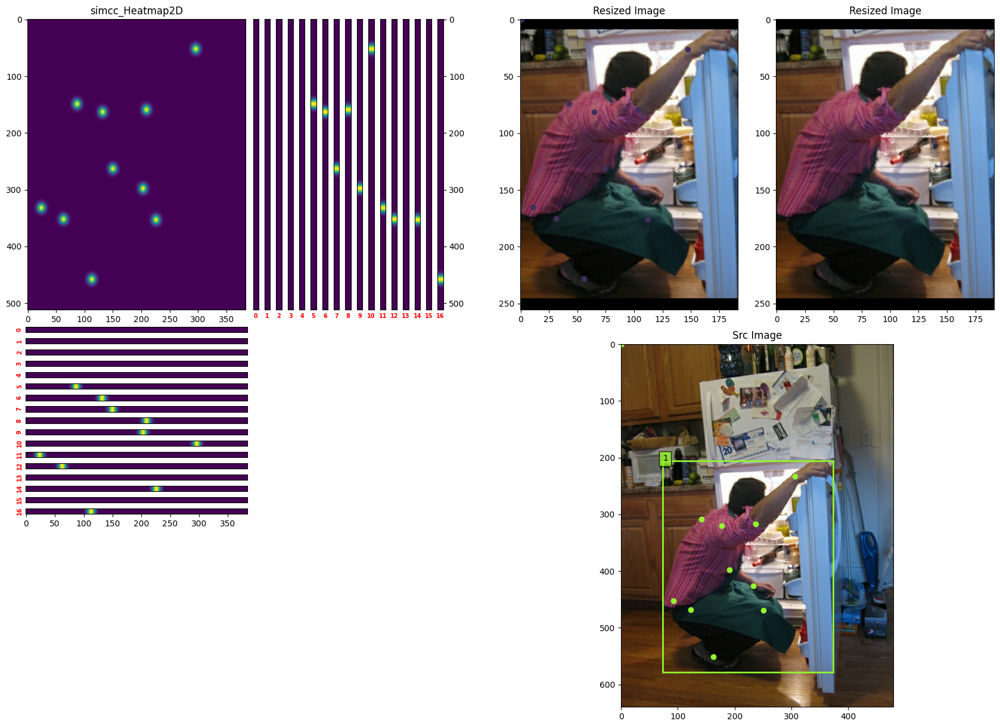

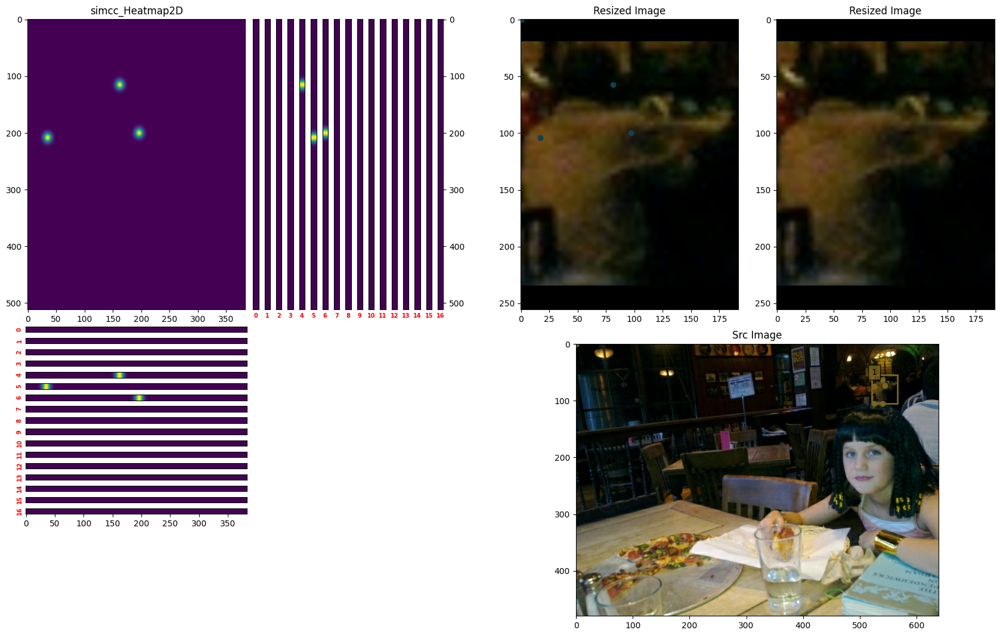

In [32]:
from typing import Dict, List, Optional, Tuple, Union, Any, Sequence
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from tensorflow import Tensor
class BasePoseVisFun:
    VERSION = '1.0.0'
    DATA_KEYS = [
        'batched_imgs', 
        'y_preds', 
        'decoded_preds', 
        'encoded_trues',
        'kpts', 
        'bboxes', 
        'labels', 
        'src_imgs', 
        'src_bboxes', 
        'src_labels', 
        'src_kpts', 
        'src_img_ids',  
        'src_ids',
    ]

    DATA_KEYS_MAP = {
        'batched_imgs_list' : 'img', 
        'batched_preds_list' : 'y_pred', 
        'batched_decode_preds_list' : 'decode_pred', 
        'batched_encode_trues_list' : 'encode_true',
        'batched_kpts_list' : 'kpts', 
        'batched_bboxes_list' : 'bboxes', 
        'batched_labels_list' : 'labels', 
        'batched_src_imgs_list' : 'src_img', 
        'batched_src_bboxes_list' : 'src_bboxes', 
        'batched_src_labels_list' : 'src_labels', 
        'batched_src_kpts_list' : 'src_kpts',
        'batched_src_img_ids_list' : 'src_img_id',  
        'batched_src_ids_list'  : 'src_ids',
    }
    r""" 
    
        y_preds : Optional[List[Tensor]] = None,
        decoded_preds : Optional[List[Tensor]] = None,
        encoded_trues : Optional[List[Tensor]] = None,
        kpts : Optional[List[Tensor]] = None,
        bboxes : Optional[List[Tensor]] = None,
        labels : Optional[List[Tensor]] = None,
        src_imgs : Optional[List[Tensor]] = None,
        src_kpts : Optional[List[Tensor]] = None,
        src_bboxes : Optional[List[Tensor]] = None,
        src_labels : Optional[List[Tensor]] = None,
        src_img_ids : Optional[List[Tensor]] = None,
        src_ids : Optional[List[Tensor]] = None,  

    """
    def __init__(
            self, 
            figsize : Tuple[int] = (24, 8),
            sel_batch_ids : Optional[List[int]] = [0],
    ):
        self.figsize = figsize
        self.sel_batch_ids = sel_batch_ids

    # def get_i_size(self,imgs)

    #      src_img_size_hw = src_img.shape[:2] if src_img is not None else (0,0)

    def parse_subplot_spec(self, subplot_spec, **kwargs):
        if type(subplot_spec)==tuple:
            plt.subplot(*subplot_spec,**kwargs)
        else:
            plt.subplot(subplot_spec, **kwargs)
        

    def base_plot(
        self, image, bboxes=None, labels=None, kpts=None, title='Image',subplot_spec=(1,1,1),**kwargs
    ):  
        
        self.parse_subplot_spec(
            subplot_spec=subplot_spec, **kwargs
        )
        plt.title(
            title, fontsize = 12
        )
        plt.imshow(image)
        if bboxes is not None and bboxes.shape.rank==3 :
            num_obj = bboxes.shape[0]
            ith_obj = -1 
        else:
            num_obj = 1 # single pose

        num_obj = bboxes.shape[0] if bboxes is not None and bboxes.shape.rank==3 else 1
        ith_obj = -1 
        for i in range(num_obj):   
            label = labels[i] if labels is not None else 1
            if label==1: 
                color = np.random.uniform(
                    low=0., high=1., size=3
                )
                ith_obj +=1

            if bboxes is not None :   
                bbox = bboxes[i] if num_obj!=1 else bboxes
                x1, y1, w, h = bbox
                ax = plt.gca() 
                patch = plt.Rectangle(
                    [x1, y1], w, h, 
                    fill=False, 
                    edgecolor=color, 
                    linewidth=2
                )
                ax.add_patch(patch)
                text = "{}".format(label)
                ax.text(
                    x1, y1, text,
                    bbox={"facecolor": color, "alpha": 0.8},
                    clip_box=ax.clipbox,
                    clip_on=True,
                )

            if kpts is not  None and label == 1 :
                kpt_ith = kpts[ith_obj] if num_obj!=1 else kpts
                for j in range(0,kpt_ith.shape[0]):
                    kps_x = int((kpt_ith[j,0]))
                    kps_y = int((kpt_ith[j,1]))
                    plt.scatter(kps_x,kps_y, color=color)

    def heatmaps_plot(
            self,  
            y_trues : Tensor, 
            sum_axis= -1, 
            title : str='heatmap', 
            subplot_spec=(1,1,1),
            **kwargs
    ):
        self.parse_subplot_spec(subplot_spec=subplot_spec)
        plt.title(title, fontsize = 12)
        heatmaps = y_trues.numpy()
        plt.imshow(heatmaps.sum(axis=sum_axis))


    def xy_heatmaps_plot(
        self, 
        gs : gridspec.GridSpec,
        x_heatmaps : Tensor, 
        y_heatmaps : Tensor, 
        lt_start_gxy : Tuple[int] = (0,0), 
        title = "simcc_",
        hm_1d_size : int = 5,
        hm_1d_intervel_row : int = 5,
        hm_1d_intervel_col : int = 5,
    ): 
        if not isinstance(gs,gridspec.GridSpec):
            raise TypeError(
                f"input 'gs' must be  matplotlib.gridspec.GridSpec type in xy_heatmaps_plot() "
                f"but got {type(gs)} @ {self.__class__.__name__} "
            ) 
        num_joints = y_heatmaps.shape[0]
        lt_start_gx, lt_start_gy = lt_start_gxy
        heatmaps_2d = x_heatmaps[:,None,:]*y_heatmaps[:,:,None] #(17,simcc_y, simcc_x)
        hm_2d_size_hw = heatmaps_2d.shape[1:] #(512,384)
        heatmaps_2d = tf.reduce_max(heatmaps_2d, axis=0).numpy()
       
        '2d heatmap'
        plt.subplot(
            gs[lt_start_gy:lt_start_gy + hm_2d_size_hw[0]//2, lt_start_gx:lt_start_gx+hm_2d_size_hw[1]//2]
        )
        plt.title(
            title + "Heatmap2D", fontsize = 12
        )
        plt.imshow(heatmaps_2d)
        '1d heatmap'
        start_gy = lt_start_gy + hm_2d_size_hw[0]//2+hm_1d_intervel_row+10
        start_gx = lt_start_gx  + hm_2d_size_hw[1]//2+hm_1d_intervel_col
        
        for i in range(num_joints) :
            x_heatmap = x_heatmaps[i][None,:]
            ax2 = plt.subplot(gs[start_gy:start_gy+hm_1d_size, lt_start_gx:lt_start_gx+hm_2d_size_hw[1]//2])
            plt.imshow(x_heatmap, aspect='auto')
            ax2.set_yticks([])
            if i!=num_joints-1 :
                ax2.set_xticks([])
            ax2.set_ylabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red')
            start_gy += hm_1d_intervel_row+hm_1d_size


            y_heatmap = y_heatmaps[i][:, None] 
            ax2 = plt.subplot(gs[ lt_start_gy: lt_start_gy + hm_2d_size_hw[0]//2, start_gx:start_gx+hm_1d_size])
            plt.imshow(y_heatmap, aspect='auto')
            if i!=num_joints-1 :
                ax2.set_yticks([])
            else:
                ax2.yaxis.set_label_position("right")
                ax2.yaxis.tick_right()
            ax2.set_xticks([])
            ax2.set_xlabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red') 
            start_gx += hm_1d_intervel_col+hm_1d_size  

    def src_img_plot(
        self,
        src_img : Tensor,
        subplot_spec =(1,1,1),
        title : str = 'src_image',
        src_kpts : Optional[Tensor] = None,
        src_bboxes : Optional[Tensor] = None,
        src_labels : Optional[Tensor]= None,
        src_img_id : Optional[Tensor] = None,
        src_ids : Optional[Tensor] = None,
        **kwargs
        
    ):
        if src_img_id is not None:
            #extra_text =title + f" ---(img_id : {image_id}, id : {instance_id} if )"
            title = title + f" ---(img_id : {image_id} )"

        self.base_plot(
            image = src_img, 
            bboxes=src_bboxes, 
            labels=src_labels, 
            kpts=src_kpts, 
            title=title,
            subplot_spec=subplot_spec,
            **kwargs  
        )



    # def parse_data(self, **kwargs):
    #     num_batched_samples = None
    #     data = dict()
    #     if all( [(val==None or val==[]) for val in kwargs.values()]):
    #         raise ValueError(
    #             f""
    #         )  
    #     #DATA_KEYS_MAP.items()
    #     for key, val in kwargs.items():
    #         if key in self.DATA_KEYS:
    #             'extract effective data'
    #             #val = kwargs.pop(key,None)
    #             val = kwargs[key]
    #             if isinstance(val, Tensor):
    #                  val = [ val ]

    #             if isinstance(val, list) and val!= [] :
    #                 data[key] =  tf.stack(
    #                     val, axis=0
    #                 )
    #                 if not num_batched_samples :
    #                     num_batched_samples = data[key].shape[0]
    #                 else:
    #                     assert(data[key].shape[0]==num_batched_samples)  
                
    #             elif val==[] or val == None  :
    #                 data[key] = None
    #             else:
    #                 raise TypeError(
    #                     f""
    #                 )  
                               
    #     return data , kwargs, num_batched_samples

    def parse_data(self, **kwargs):
        num_batched_samples = None
        cfg = kwargs.copy()
        data = dict()
        if all( [(val==None or val==[]) for val in kwargs.values()]):
            raise ValueError(
                f""
            ) 
        #key_map = self.DATA_KEYS_MAP.keys()
        for key in kwargs.keys():
             if key in self.DATA_KEYS_MAP.keys():
                val = cfg.pop(key,None)
                map_key = self.DATA_KEYS_MAP[key]

                if isinstance(val, Tensor):
                     val = [ val ]
       
                if isinstance(val, list) and val!= [] :
                   
                    data[map_key] =  tf.stack(
                        val, axis=0
                    )
                    if not num_batched_samples :
                        num_batched_samples = data[map_key].shape[0]
                    else:
                        assert(data[map_key].shape[0]==num_batched_samples)  
                
                elif val==[] or val == None  :
                    data[map_key] = None
                else:
                    raise TypeError(
                        f""
                    )  
        del  kwargs                    
        return data , cfg.pop('kwargs'), num_batched_samples
    

    def parse_data(self, **kwargs):
        num_batched_samples = None
        data = dict()
        if all( [(val==None or val==[]) for val in kwargs.values()]):
            raise ValueError(
                f""
            ) 
        #key_map = self.DATA_KEYS_MAP.keys()
        for key, val in kwargs.items():
            if key in self.DATA_KEYS_MAP.keys():
                map_key = self.DATA_KEYS_MAP[key]

                if isinstance(val, Tensor):
                    val = [ val ]
       
                if isinstance(val, list) and val!= [] :
                   
                    data[map_key] =  tf.stack(
                        val, axis=0
                    )
                    if not num_batched_samples :
                        num_batched_samples = data[map_key].shape[0]
                    else:
                        assert(data[map_key].shape[0]==num_batched_samples)  
                
                elif val==[] or val == None  :
                    data[map_key] = None
                else:
                    raise TypeError(
                        f""
                    )  
        del  kwargs                    
        return data , num_batched_samples   



    def call(
        self, 
        img : Tensor,
        y_pred : Optional[Tensor] = None,
        decode_pred : Optional[Tensor] = None,
        encode_true : Optional[Tensor] = None,
        kpts : Optional[Tensor] = None,
        bboxes : Optional[Tensor] = None,
        labels : Optional[Tensor] = None,
        src_img : Optional[Tensor] = None,
        src_kpts : Optional[Tensor] = None,
        src_bboxes : Optional[Tensor] = None,
        src_labels : Optional[Tensor] = None,
        src_img_id : Optional[Tensor] = None,
        src_ids : Optional[Tensor] = None,
        **kwargs
    ):
        r"""
        DATA_KEYS_MAP = {
            'batched_imgs_list' : 'img', 
            'batched_preds_list' : 'y_pred', 
            'batched_decode_preds_list' : 'decode_pred', 
            'batched_encode_trues_list' : 'encode_true',
            'batched_kpts_list' : 'kpts', 
            'batched_bboxes_list' : 'bboxes', 
            'batched_labels_list' : 'labels', 
            'batched_src_imgs_list' : 'src_img', 
            'batched_src_bboxes_list' : 'src_bboxes', 
            'batched_src_labels_list' : 'src_labels', 
            'batched_src_kpts_list' : 'src_kpts',, 
            'batched_src_img_ids_list' : 'src_img_id',  
            'batched_src_ids_list' : : 'src_img_id',
        }
 
        """
        raise NotImplementedError()

    def __call__(
        self, 
        batched_imgs_list : List[Tensor],
        batched_preds_list : Optional[List[Tensor]] = None,
        batched_decode_preds_list : Optional[List[Tensor]] = None,
        batched_encode_trues_list : Optional[List[Tensor]] = None,
        batched_kpts_list : Optional[List[Tensor]] = None,
        batched_bboxes_list : Optional[List[Tensor]] = None,
        batched_labels_list : Optional[List[Tensor]] = None,
        batched_src_imgs_list : Optional[List[Tensor]] = None,
        batched_src_kpts_list : Optional[List[Tensor]] = None,
        batched_src_bboxes_list : Optional[List[Tensor]] = None,
        batched_src_labels_list : Optional[List[Tensor]] = None,
        batched_src_img_ids_list : Optional[List[Tensor]] = None,
        batched_src_ids_list :  Optional[List[Tensor]] = None,
        **kwargs
    )-> None :
        R""" kwargs :

        batched_imgs_list : List[Tensor],
        batched_preds_list : Optional[List[Tensor]] = None,
        batched_decode_preds_list : Optional[List[Tensor]] = None,
        batched_encode_trues_list : Optional[List[Tensor]] = None,
        batched_kpts_list : Optional[List[Tensor]] = None,
        batched_bboxes_list : Optional[List[Tensor]] = None,
        batched_labels_list : Optional[List[Tensor]] = None,
        batched_src_imgs_list : Optional[List[Tensor]] = None,
        batched_src_kpts_list : Optional[List[Tensor]] = None,
        batched_src_bboxes_list : Optional[List[Tensor]] = None,
        batched_src_labels_list : Optional[List[Tensor]] = None,
        batched_src_img_ids_list : Optional[List[Tensor]] = None,
        batched_src_ids_list :  Optional[List[Tensor]] = None,
        
        """
        lcls = locals()
        lcls.pop('self')
        print(lcls.keys())

        
        # num_batched_samples = self.get_num_batched_samples(**kwargs)
        # data = self.merge_sample_list(num_batched_samples, **kwargs)
        #data , cfg, num_batched_samples  = self.parse_data(**kwargs)
        tf_data  , num_batched_samples  = self.parse_data(**lcls)


        for i in range(num_batched_samples):
            for batch_id in self.sel_batch_ids:
                sel_data = tf.nest.map_structure(
                    lambda x : x[i, batch_id,...] if x is not None else None, tf_data     
                ) 
                'sel_data (single sample) for ploting'
                #self.call(**sel_data, **cfg) 
                self.call(**sel_data, **kwargs) 








    

class Vis_TopdownPoseSimCCLabelCodec(BasePoseVisFun):
    def __init__(
            self, 
            simicc_split_xy_dim : Tuple[int] = (192*2, 256*2),
            **kwargs
    ):
        super().__init__(**kwargs)
        self.simicc_split_xy_dim = simicc_split_xy_dim
        

    def call(
        self, 
        img : Tensor,
        y_pred : Optional[Tensor] = None,
        decode_pred : Optional[Tensor] = None,
        encode_true : Optional[Tensor] = None,
        kpts : Optional[Tensor] = None,
        bboxes : Optional[Tensor] = None,
        labels : Optional[Tensor] = None,
        src_img : Optional[Tensor] = None,
        src_kpts : Optional[Tensor] = None,
        src_bboxes : Optional[Tensor] = None,
        src_labels : Optional[Tensor] = None,
        src_img_id : Optional[Tensor] = None,
        src_ids : Optional[Tensor] = None,
        **kwargs
    )->None:
        
        r"""
        DATA_KEYS_MAP = {
            'batched_imgs_list' : 'img', 
            'batched_preds_list' : 'y_pred', 
            'batched_decode_preds_list' : 'decode_pred', 
            'batched_encode_trues_list' : 'encode_true',
            'batched_kpts_list' : 'kpts', 
            'batched_bboxes_list' : 'bboxes', 
            'batched_labels_list' : 'labels', 
            'batched_src_imgs_list' : 'src_img', 
            'batched_src_bboxes_list' : 'src_bboxes', 
            'batched_src_labels_list' : 'src_labels', 
            'batched_src_kpts_list' : 'src_kpts',, 
            'batched_src_img_ids_list' : 'src_img_id',  
            'batched_src_ids_list' : : 'src_img_id',
        }
        """
        '''

        '''
        np_resized_img =  None if img  is None else img.numpy()
        np_src_img = None if src_img is None else src_img.numpy()  

        
        img_size_hw = (0,0) if np_resized_img is None else  np_resized_img.shape[:2]#(256,192)
        src_img_size_hw = (0,0)  if np_src_img is None else np_src_img.shape[:2]
        hm_2d_size_hw = (0, 0)
        hm_1d_num = 0
        hm_1d_size = 5
        hm_1d_intervel_row = 5
        hm_1d_intervel_col = 5
        subplot_intervel = 30 

        'encode data'
        plot_hm_true = False if encode_true is None else True
        if plot_hm_true :
            simcc_xy_heatmaps_true   = encode_true
            x_heatmaps_true , y_heatmaps_true = tf.split(simcc_xy_heatmaps_true, num_or_size_splits=[*self.simicc_split_xy_dim], axis=-1)
            hm_2d_size_hw = (y_heatmaps_true.shape[1], x_heatmaps_true.shape[1])
            hm_1d_num = x_heatmaps_true.shape[0] 


        'pred data (model output)'
        plot_hm_pred = False if y_pred is None else True
        if plot_hm_pred :
            simcc_xy_heatmaps_pred   = y_pred
            x_heatmaps_pred , y_heatmaps_pred = tf.split(simcc_xy_heatmaps_pred, num_or_size_splits=[*self.simicc_split_xy_dim], axis=-1)
            hm_2d_size_hw = (y_heatmaps_pred.shape[1], x_heatmaps_pred.shape[1])
            hm_1d_num = x_heatmaps_pred.shape[0] 

        "one simcc_hm_size_hw including 2d and 1d heatmap"
        simcc_hm_size_hw = (
           hm_2d_size_hw[0]//2 + hm_1d_intervel_row +10+(hm_1d_intervel_row+hm_1d_size)*hm_1d_num,
           (hm_2d_size_hw[1]//2 + hm_1d_intervel_col + (hm_1d_intervel_col+hm_1d_size)*hm_1d_num + subplot_intervel*2)
        )

        'set GridSpec'
        grid_rows = max(simcc_hm_size_hw[0] , img_size_hw[0] + subplot_intervel + src_img_size_hw[0]//2)
        grid_cols = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true) + max( img_size_hw[1]*2 + subplot_intervel, src_img_size_hw[1]//2)
        gs = gridspec.GridSpec(grid_rows, grid_cols)
        'set Image Size'
        fig_size_wh  = (grid_cols//40, grid_rows//40 ) #((hm_2d_size_hw[0]+extra_rows)//40, (hm_2d_size_hw[1]+extra_cols)//40)

        plt.figure(figsize=fig_size_wh)
        if  plot_hm_true:
            self.xy_heatmaps_plot(
                title = "simcc_",
                gs = gs,
                x_heatmaps = x_heatmaps_true, 
                y_heatmaps = y_heatmaps_true, 
                lt_start_gxy  = (0,0), 
                hm_1d_size = hm_1d_size,
                hm_1d_intervel_row = hm_1d_intervel_row,
                hm_1d_intervel_col = hm_1d_intervel_col,
            )
        # if plot_hm_true:
        #     a = hm_2d_size_hw[1]//2 + hm_1d_intervel_row+ (hm_1d_intervel_row+hm_1d_size)*hm_1d_num + subplot_intervel*2 
        #     self.xy_heatmaps_plot(
        #         title = "simcc_",
        #         gs = gs,
        #         x_heatmaps = x_heatmaps_true, 
        #         y_heatmaps = y_heatmaps_true, 
        #         lt_start_gxy  = (a,0), 
        #         hm_1d_size = hm_1d_size,
        #         hm_1d_intervel_row = hm_1d_intervel_row,
        #         hm_1d_intervel_col = hm_1d_intervel_col,
        #     )   


        'resized_image'
        start_x = (hm_2d_size_hw[1]//2+subplot_intervel+hm_1d_num*(hm_1d_intervel_col+hm_1d_size)+subplot_intervel)

        start_x = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true)
        self.base_plot(
            title = f"Resized Image",
            image = np_resized_img,
            kpts = kpts,
            bboxes = None,
            subplot_spec = gs[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

        )
        'resized_image # 2'
        #start_x = (hm_2d_size_hw[1]//2+subplot_intervel+hm_1d_num*(hm_1d_intervel_col+hm_1d_size)+subplot_intervel)

        start_x += img_size_hw[1] + subplot_intervel
        self.base_plot(
            title = f"Resized Image",
            image = np_resized_img,
            kpts = None,
            bboxes = None,
            subplot_spec = gs[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

        )

        'src_image # 2'
        start_x = simcc_hm_size_hw[1]*(plot_hm_pred+plot_hm_true)
        start_y = img_size_hw[0]+subplot_intervel
        self.base_plot(
            title = f"Src Image",
            image = np_src_img,
            kpts = src_kpts,
            bboxes = src_bboxes,
            subplot_spec = gs[start_y:start_y + src_img_size_hw[0], start_x:start_x+src_img_size_hw[1]]

        )

        # start_x = (hm_2d_size_hw[1]//2+subplot_intervel+hm_1d_num*(hm_1d_intervel_col+hm_1d_size)+subplot_intervel)
        # self.base_plot(
        #     title = f"Resized Image",
        #     image = np_resized_img,
        #     kpts = None,
        #     bboxes = None,
        #     subplot_spec = gs[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

        # )

        #image, bboxes=None, labels=None, kpts=None, title='Image',subplot_spec=(1,1,1),

#batched_samples_list = [feat for feat in batch_test_dataset.take(2)]
#Vis_TopdownPoseSimCCLabelCodec

batch_val_dataset = val_tfds_builder.GenerateTargets(
    test_mode=True,     
    unpack_x_y_sample_weight= False, 
    ds_weights =None,
    show_PackTensorTypeSpec  = True,
    show_pipeline_cfg = True
)


batched_samples_list = [ model.encoder(feat) for feat in batch_val_dataset.take(2)]
encoded_trues_list = [ batched_samples['y_true'] for batched_samples in batched_samples_list]
batched_images_list = [ batched_samples['image'] for batched_samples in batched_samples_list]
batched_kpts_list = [ batched_samples['kps'] for batched_samples in batched_samples_list]
batched_src_imgs_list = [ batched_samples['meta_info']['src_image'] for batched_samples in batched_samples_list]
batched_src_kpts_list =  [ tf.reshape(batched_samples['meta_info']['src_keypoints'],[-1,17,3])  for batched_samples in batched_samples_list]
batched_src_bboxes_list = [ batched_samples['meta_info']['src_bbox'] for batched_samples in batched_samples_list]

vis_fn = Vis_TopdownPoseSimCCLabelCodec()
'''
            'batched_imgs_list' : 'img', 
            'batched_preds_list' : 'y_pred', 
            'batched_decode_preds_list' : 'decode_pred', 
            'batched_encode_trues_list' : 'encode_true',
            'batched_kpts_list' : 'kpts', 
            'batched_bboxes_list' : 'bboxes', 
            'batched_labels_list' : 'labels', 
            'batched_src_imgs_list' : 'src_img', 
            'batched_src_bboxes_list' : 'src_bboxes', 
            'batched_src_labels_list' : 'src_labels', 
            'batched_src_kpts_list' : 'src_kpts',, 
            'batched_src_img_ids_list' : 'src_img_id',  
            'batched_src_ids_list' : : 'src_img_id',
'''
vis_fn(
    batched_imgs_list = batched_images_list,
    batched_preds_list = None,
    batched_decode_preds_list  = None,
    batched_encode_trues_list  = encoded_trues_list,
    batched_kpts_list = batched_kpts_list,
    batched_bboxes_list  = None,
    batched_labels_list = None,
    batched_src_imgs_list  = batched_src_imgs_list,
    batched_src_bboxes_list  = batched_src_bboxes_list,
    batched_src_kpts_list  = batched_src_kpts_list,
    batched_src_labels_list  = None,
    batched_src_img_ids_list  = None,
    batched_src_ids_list = None,
    test = 1
)

In [24]:
dictionary = {2 : 1}
table = tf.lookup.StaticVocabularyTable(
        tf.lookup.KeyValueTensorInitializer(
            list(dictionary.keys()),
            list(dictionary.values()),
            key_dtype=tf.int32,
            value_dtype=tf.int32,
        ),
        num_oov_buckets=1,
    )
origin_tensor = dict('a' = 2)
result_tensor = table.lookup(origin_tensor)

SyntaxError: expression cannot contain assignment, perhaps you meant "=="? (4285019528.py, line 11)

In [30]:
tensor = dict(a = 2, b =3, c= 4)
tensor.pop(('a','b'))

KeyError: ('a', 'b')

In [90]:
a = True
b = False
a+b

1

In [24]:
batched_samples_list = [ model.encoder(feat) for feat in batch_val_dataset.take(2)]
encoded_trues_list = [ batched_samples['y_true'] for batched_samples in batched_samples_list]
batched_images_list = [ batched_samples['image'] for batched_samples in batched_samples_list]
batched_kpts_list = [ batched_samples['kps'] for batched_samples in batched_samples_list]

In [22]:
encoded_trues_list[0].shape

TensorShape([128, 17, 896])

In [19]:
data = model.encoder( batched_samples_list[0])
data.keys()

dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'y_true', 'sample_weight'])

In [53]:
# data = tf.ones(shape=(32,4,8))
# ith = 1
# tf.nest.map_structure(lambda x, ith : x[ith], data, 1)

# ith = 1
# tf.nest.map_structure(lambda args, batch_ith : args[batch_ith], data, ith)
# tf.nest.map_structure(lambda args, batch_ith : args[batch_ith], data, ith)

      
    # def op_expand_batch_dim(
    #         self, data : Union[Tensor, Sequence[Tensor], Dict[str,Tensor]]
    # ):
    #     return tf.nest.map_structure(
    #         lambda x : tf.expand_dims(x, axis=0), data
    #     )
# def test(data, ith = 1 ):
#     return tf.nest.map_structure(lambda x, batch_ith : x[batch_ith], data, ith
                             
data = dict(image = tf.ones(shape=(32,4,8)))
data1 = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))]
data2 = [tf.ones(shape=(32,7,3)), tf.ones(shape=(32,7,3))]
data3 = [tf.ones(shape=(32,2)), tf.ones(shape=(32,2))]
def test(**kwargs):
    batch_ids = [0,1]
    for ith, (key, val) in enumerate(kwargs.items()):
        data = dict



    for batch_id in batch_ids:
        data = tf.nest.map_structure(
            lambda x : x[batch_id], kwargs     
        )  
        for key, val in kwargs.items():


        for i in range (len( data['data1_input'] )):
            print(data)
            pass
        
        # print(len(data.values()))
        # print(len(data['data1_input']))
    return 


test(data1_input = data1  , data2_input = data2, data3_input = data3 )                                  
 

IndentationError: expected an indented block (1751209367.py, line 37)

In [59]:

def test(**kwargs):
    num_batch_samples = 0
    #print(kwargs.items())
    for key in kwargs.keys():
        val = kwargs[key]
        if isinstance(val,list) and len(val)!= [] :
            num_batch_samples = len(val)
            kwargs[key] = tf.stack(val, axis=0)
            if num_batch_samples == 0:
                num_batch_samples =   kwargs[key].shape[0]
            else:
                if kwargs[key].shape[0]!=num_batch_samples:
                    raise ValueError(
                        f"vis_fn must be callable function"
                )  
        else:
            kwargs[key] = None  
    return kwargs, num_batch_samples
image = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))]
image2 = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))]
image3 = None
new_data, num_batched_samples = test(image=image, image2=image2, image3=image3)


def call(**kwargs):
    return test(**kwargs)

image = dict(imagea = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))])
image2 = dict(image2 = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))])
new_data, num_batched_samples = call(image=image, image2=image2, image3=image3)
new_data, num_batched_samples = call(**image,**image2  )

new_data.keys()
#new_data['image'].shape

dict_keys(['imagea', 'image2'])

In [35]:
#data1 = dict( image = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))], image2 = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))], image3 = None)
image = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))]
image2 = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))]
#image3 = None

def test(**kwargs):
    num_batch_samples = 0
    data = dict()
    for key in kwargs.keys():
        if kwargs[key] != None and kwargs[key] != [] :
            data[key] = tf.stack(kwargs[key], axis=0)
            if num_batch_samples == 0:
                num_batch_samples =  data[key].shape[0]
            else:
                if data[key].shape[0]!=num_batch_samples:
                    raise ValueError(
                        f"vis_fn must be callable function"
                )  
        else:
            data[key] = None  
    return data, num_batch_samples

new_data, num_batched_samples = test(image=image, image2=image2)

new_data['image2']
#tf.map_fn(fn=lambda t: tf.stack(t), elems = data1)
sel_data = tf.nest.map_structure(
    lambda x : x[0,1], new_data     
)  
print(sel_data['image'].shape)
# data = tf.nest.map_structure(lambda x : tf.stack(x), data1)
# print(data['image'])

(4, 8)


In [37]:
from itertools import product
N= [1,2,3]
K= [4,5,6]
for (n, k) in zip(product(N, K)):
    print(n,k)

ValueError: not enough values to unpack (expected 2, got 1)

In [79]:
data1 = dict( image = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))], image2 = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))])
test = dict()
a = lambda kwargs :  test.update(key, val[0]) for (key, val) in enumerate(kwargs.items())
#a(data1)
data1.values()

dict_values([[<tf.Tensor: shape=(32, 4, 8), dtype=float32, numpy=
array([[[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       [[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       [[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       ...,

       [[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       [[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       [[1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1

In [54]:
data1 = [tf.ones(shape=(32,4,8)), tf.ones(shape=(32,4,8))]
tf.nest.map_structure(
    lambda x : x[0], data1     
)  

[<tf.Tensor: shape=(4, 8), dtype=float32, numpy=
 array([[1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1.]], dtype=float32)>,
 <tf.Tensor: shape=(4, 8), dtype=float32, numpy=
 array([[1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1.]], dtype=float32)>]

In [16]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
gs1 = gridspec.GridSpec(20, 20)
print(type(gs1))
isinstance(gs1,gridspec.GridSpec)


<class 'matplotlib.gridspec.GridSpec'>


True

4/4 [==============================] - 0s 30ms/step
dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'meta_info', 'transform2src', 'y_true', 'sample_weight'])




tf.Tensor(
[[110.400444  22.308365   1.      ]
 [115.86686   16.786499   1.      ]
 [107.66723   19.547424   1.      ]
 [  0.         0.         0.      ]
 [ 94.00117   22.308365   1.      ]
 [115.86686   52.67865    1.      ]
 [ 83.06832   55.43959    1.      ]
 [  0.         0.         0.      ]
 [ 80.335106  96.85362    1.      ]
 [  0.         0.         0.      ]
 [ 94.00117  129.98483    1.      ]
 [118.600075 127.22391    1.      ]
 [ 99.4676   129.98483    1.      ]
 [113.133644 187.96448    1.      ]
 [ 96.73438  190.7254     1.      ]
 [110.400444 237.66132    1.      ]
 [ 94.00117  237.66132    1.      ]], shape=(17, 3), dtype=float32)
tf.Tensor(
[[ 78.79309   35.302826   1.      ]
 [ 81.816284  33.286255   1.      ]
 [ 74.763794  33.283752   1.      ]
 [ 98.94385   33.292343   1.      ]
 [  0.      

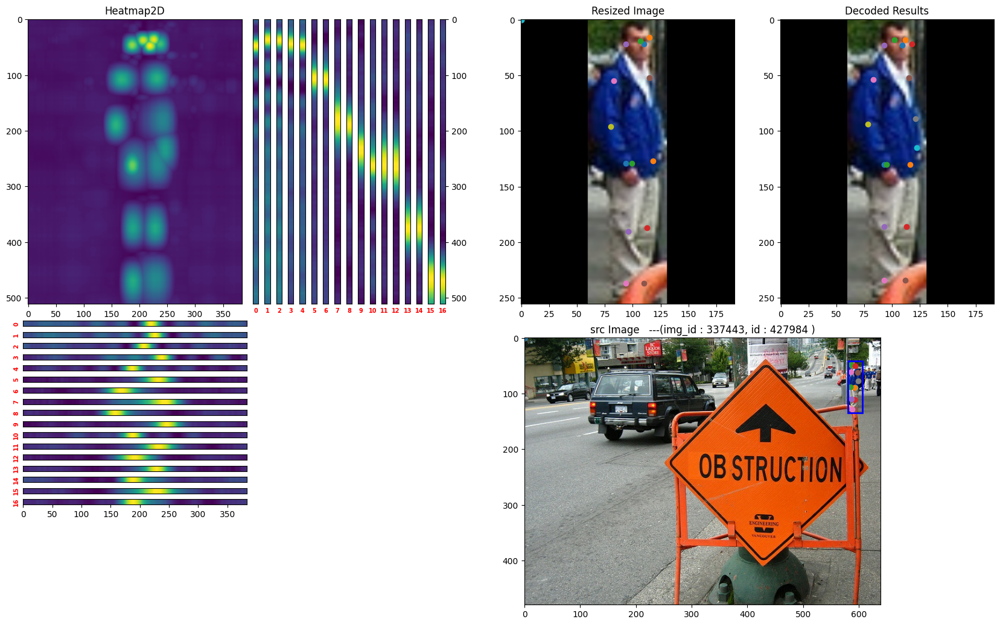

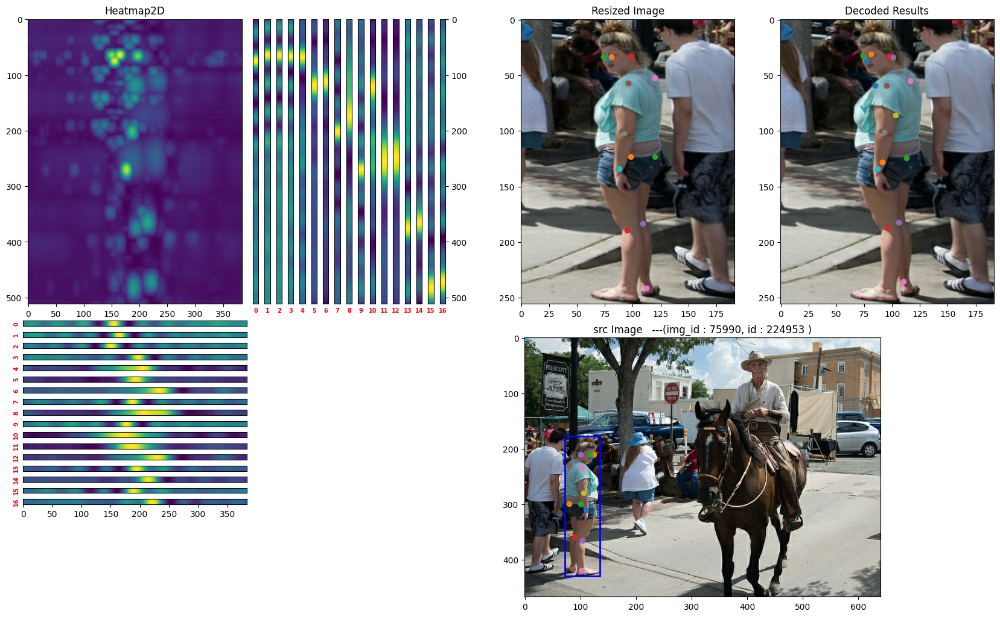

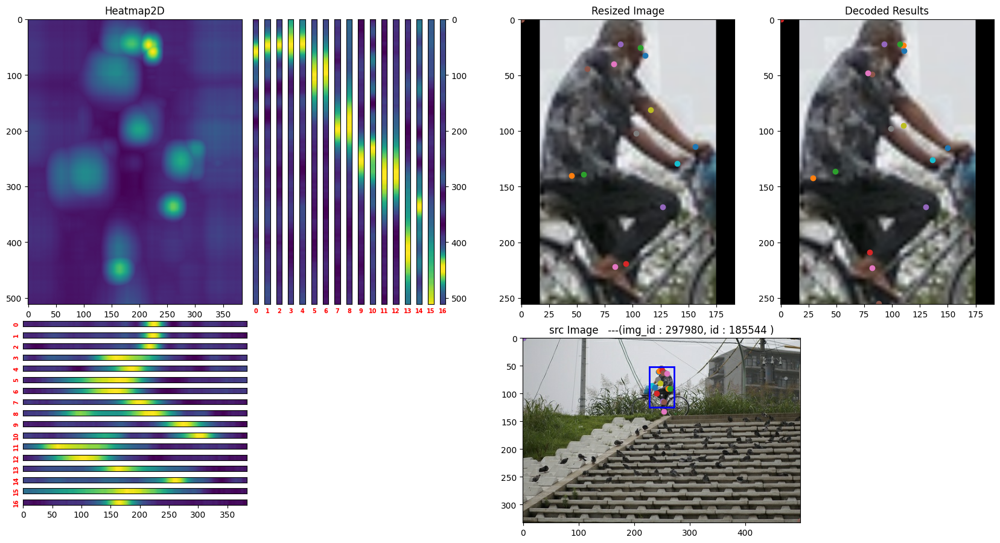

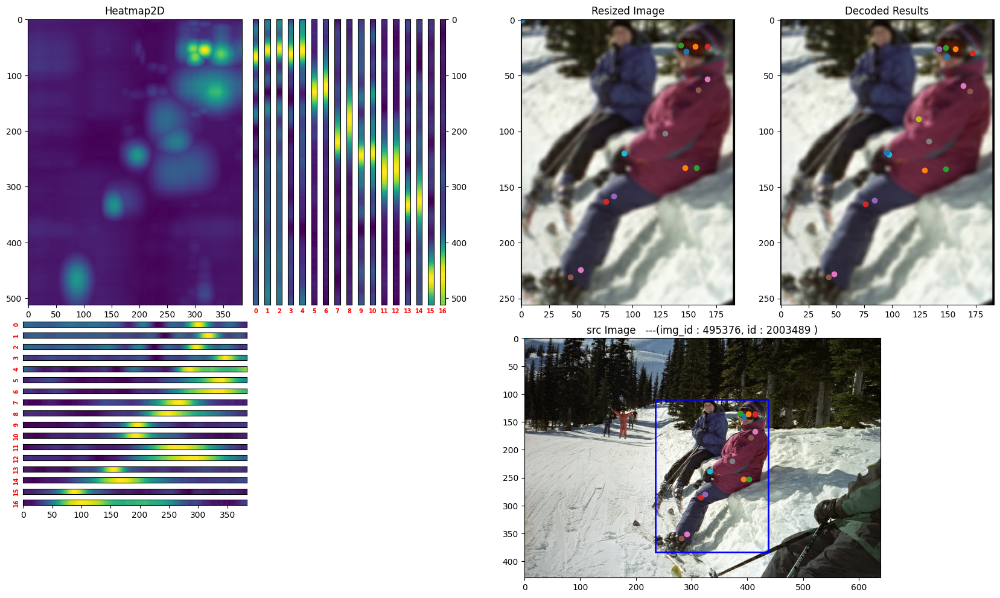

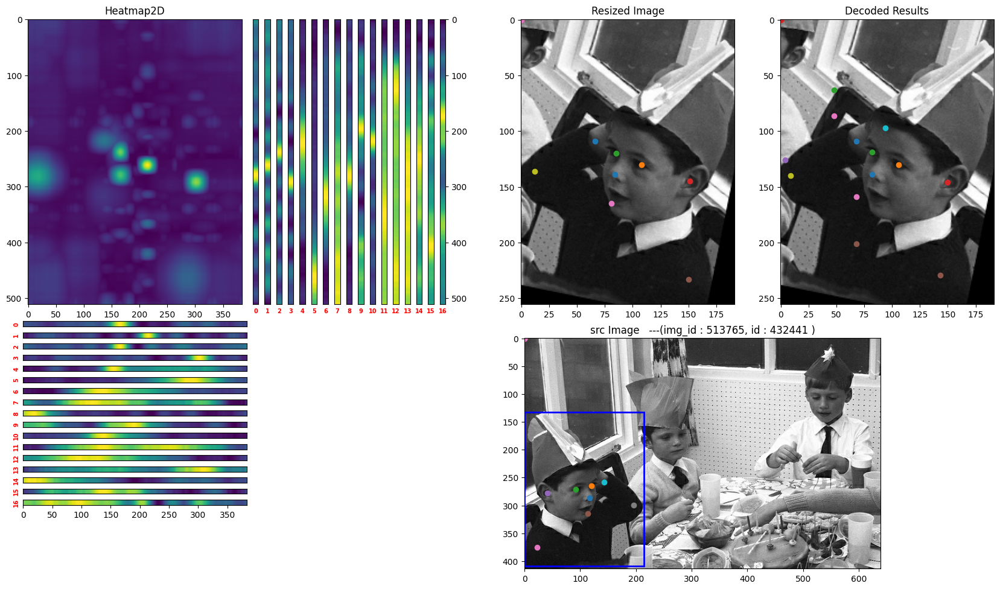

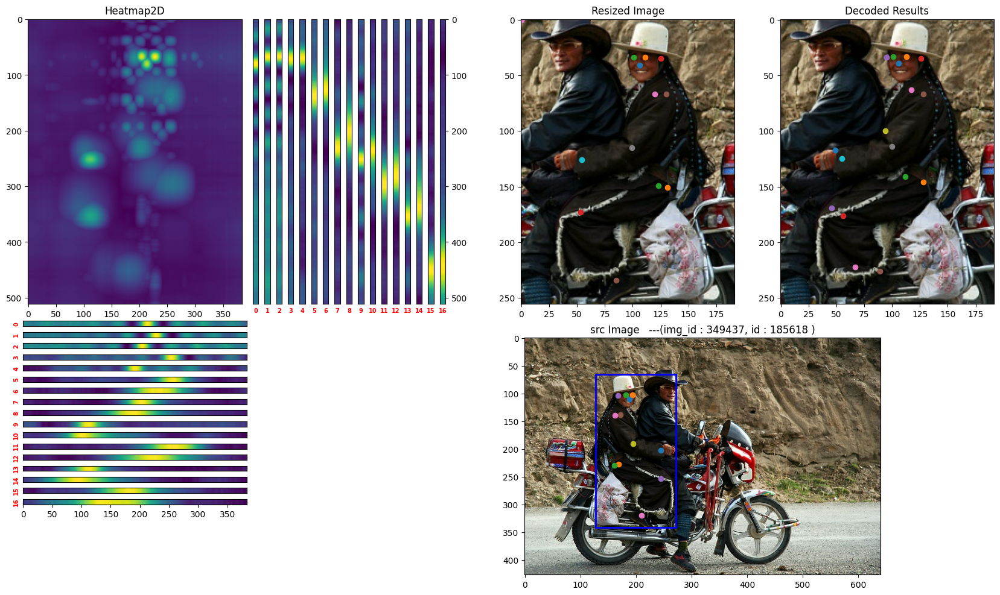

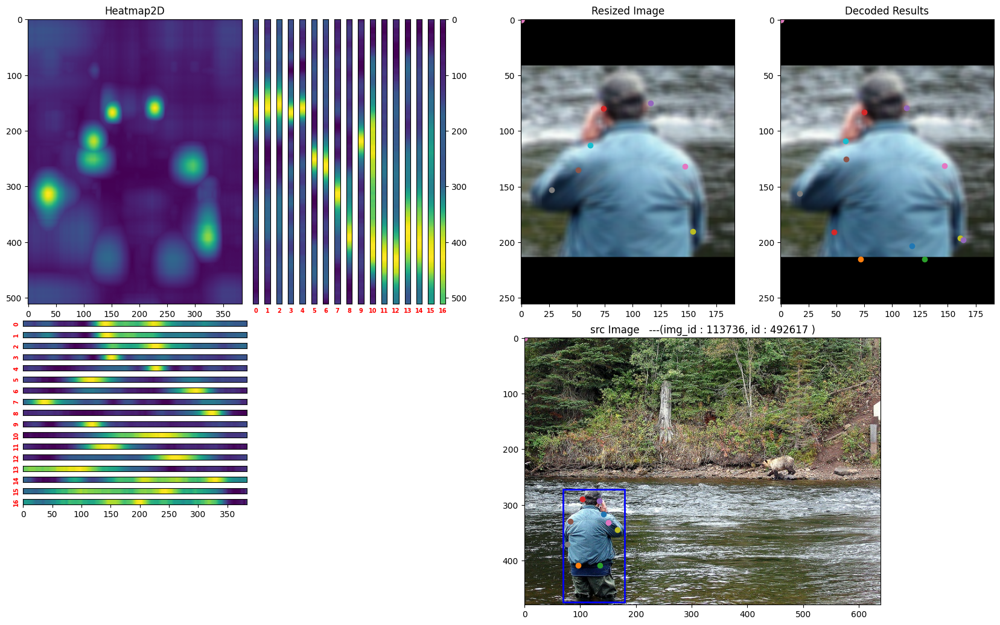

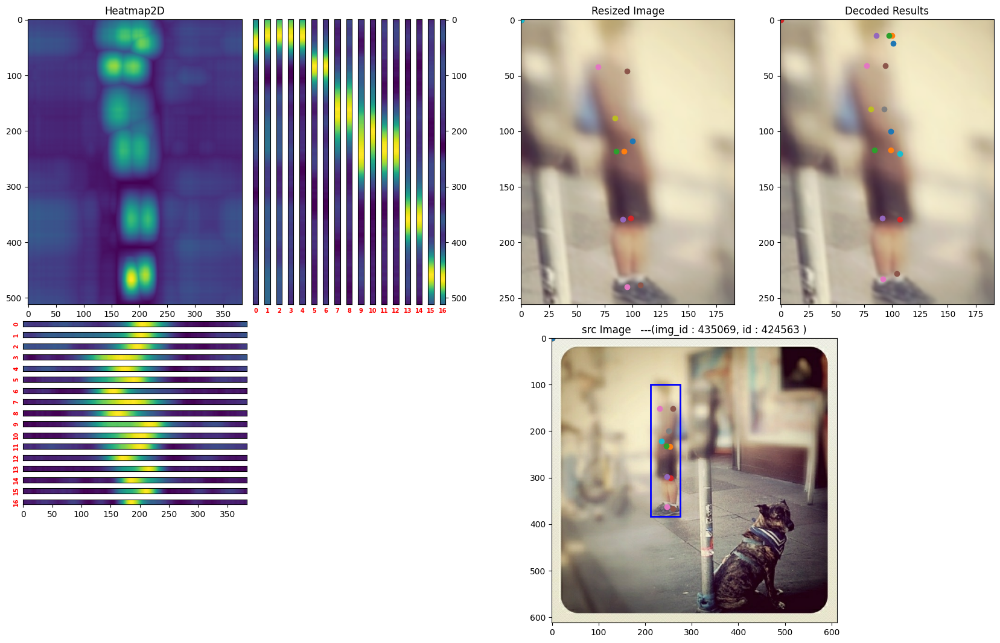

In [33]:
from typing import Dict, List, Optional, Tuple, Union, Any, Sequence
from tensorflow import Tensor
import tensorflow as tf
from lib.datasets.transforms.utils import PackInputTensorTypeSpec
import math

def Vis_TopdownPoseSimCCLabelCodec_test(
    batched_samples : Union[Dict, List],   
    decoded_preds : Optional[Union[tf.Tensor, List]] = None,
    y_preds : Optional[Union[tf.Tensor, List]] = None,
    batch_ids : int =0,
    show_kpts : bool = True,
    simcc_split_dim_wh : Tuple[int] = (192*2, 256*2)
):
    import matplotlib.pyplot as plt
    import matplotlib.gridspec as gridspec

    if decoded_preds == []: decoded_preds =  None
    if y_preds == []: y_preds =  None

    batched_decoded_kpts = decoded_preds
   


    def plot(
        title,  image, kpts=None, bbox=None, subplot_spec=(1,1,1),**kwargs
    ):  
        if type(subplot_spec)==tuple:
            plt.subplot(*subplot_spec,**kwargs)
        else:
            plt.subplot(subplot_spec, **kwargs)

        plt.title(
            title, fontsize = 12
        )
        plt.imshow(image)
        if kpts is not None :
            for i in range(0,kpts.shape[0]):
                kpt_x = int((kpts[i,0]))
                kpt_y = int((kpts[i,1]))
                plt.scatter(kpt_x,kpt_y)
    
        if bbox is not None :
            x1, y1, w, h = bbox
            ax = plt.gca()
            patch = plt.Rectangle(
                [x1, y1], w, h, 
                fill=False, 
                edgecolor=[0, 0, 1], 
                linewidth=2
            )
            ax.add_patch(patch)

    def plot_heatmaps(
            heatmaps, x_heatmap, y_heatmap, gs, lt_start_gxy, title = "pred_"
        ):
        lt_start_gx, lt_start_gy = lt_start_gxy
        hm_2d_size_hw = heatmaps.shape[1:] #(512,384)
        heatmap2d = tf.reduce_max(heatmaps, axis=0).numpy() #(simcc_y, simcc_x) 
        plt.subplot(gs[lt_start_gy:lt_start_gy + hm_2d_size_hw[0]//2, lt_start_gx:lt_start_gx+hm_2d_size_hw[1]//2])
        plt.title(
            title + "Heatmap2D", fontsize = 12
        )
        plt.imshow(heatmap2d)

        
        start_gy = lt_start_gy + hm_2d_size_hw[0]//2+hm_1d_intervel_row+10
        start_gx = lt_start_gx  + hm_2d_size_hw[1]//2+hm_1d_intervel_col

        for i in range(heatmaps.shape[0]) :
            x_heatmap = x_heatmaps[i][None,:]
            ax2 = plt.subplot(gs[start_gy:start_gy+hm_1d_size, lt_start_gx:lt_start_gx+hm_2d_size_hw[1]//2])
            plt.imshow(x_heatmap, aspect='auto')
            ax2.set_yticks([])
            if i!=heatmaps.shape[0]-1 :
                ax2.set_xticks([])
            ax2.set_ylabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red')
            start_gy += hm_1d_intervel_row+hm_1d_size

        # start_gx = lt_start_gx  + hm_2d_size_hw[1]//2+hm_1d_intervel_col
        # for i in range(heatmaps.shape[0]) :
            y_heatmap = y_heatmaps[i][:, None] 
            ax2 = plt.subplot(gs[ lt_start_gy: lt_start_gy + hm_2d_size_hw[0]//2, start_gx:start_gx+hm_1d_size])
            plt.imshow(y_heatmap, aspect='auto')
            if i!=heatmaps.shape[0]-1 :
                ax2.set_yticks([])
            else:
                ax2.yaxis.set_label_position("right")
                ax2.yaxis.tick_right()
            ax2.set_xticks([])
            ax2.set_xlabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red') 
            start_gx += hm_1d_intervel_col+hm_1d_size  
    if not isinstance(batched_samples, (dict, list)):
        raise TypeError(
            "input samples must be dict or List"
        )

    if isinstance(batched_samples, dict):
       batched_samples = [batched_samples]
    
    if batched_decoded_kpts is not None :
        if not isinstance(batched_samples, (tf.Tensor, list)):
            raise TypeError(
                "type of batched_decoded_kpts must be 'tf.Tensor' or 'List[Tensor]'"
            )
        if isinstance(batched_decoded_kpts, tf.Tensor):
            batched_decoded_kpts = [batched_decoded_kpts] 

    if batched_samples[0]['bbox_format'][0] != b'xywh':
        raise ValueError(
            "only support samples['bbox_format'] == 'xywh'"
        )  



    print(batched_samples[0].keys())
    #PackInputTensorTypeSpec(batched_samples[0],{}, show_log=True)
    print("\n\n\n")
    
    for ith, features in enumerate(batched_samples):
        for batch_id in batch_ids :
            resized_image = features["image"][batch_id].numpy()
            kpts = features['kps'][batch_id]
            if show_kpts :
                print(kpts)
            if batched_decoded_kpts is not None:
               decoded_kpts = batched_decoded_kpts[ith][batch_id] 
        
            if  features.get('meta_info',None) is not None :
                meta_info = features['meta_info']
                image_id = meta_info['image_id'][batch_id]
                instance_id = meta_info['id'][batch_id]
                src_image = meta_info['src_image'][batch_id].numpy()
                src_bbox = meta_info['src_bbox'][batch_id] 
                src_kpts = meta_info['src_keypoints'][batch_id]
                src_kpts = tf.reshape(src_kpts,[*(kpts.shape)])


            if y_preds is not None :
                simcc_xy_heatmaps = y_preds[ith][batch_id] 
            else:
                simcc_xy_heatmaps = features['y_true'][batch_id]
  
            # if y_preds is not None :
            #     simcc_xy_heatmaps_pred = y_preds[ith][batch_id] 

            # simcc_xy_heatmaps = features['y_true'][batch_id]


            x_heatmaps , y_heatmaps = tf.split(simcc_xy_heatmaps, num_or_size_splits=[*simcc_split_dim_wh], axis=-1)
            heatmaps = x_heatmaps[:,None,:]*y_heatmaps[:,:,None] #(17,simcc_y, simcc_x)
            
            'grid cfg'
            hm_2d_size_hw = heatmaps.shape[1:] #(512,384)
            img_size_hw = resized_image.shape[:2] #(256,192)
            src_img_size_hw = src_image.shape[:2]
            hm_1d_num = kpts.shape[0]
            hm_1d_size = 5
            hm_1d_intervel_row = 5
            hm_1d_intervel_col = 5
            subplot_intervel = 30 

            'set GridSpec'
            hm_w = hm_2d_size_hw[1]//2 + hm_1d_intervel_col + (hm_1d_intervel_col+hm_1d_size)*hm_1d_num + subplot_intervel 
            # if y_preds is not None :
            #    hm_w *= 2 
            grid_rows = hm_2d_size_hw[0]//2 + max(hm_1d_intervel_row+10+(hm_1d_intervel_row+hm_1d_size)*hm_1d_num, img_size_hw[0]+subplot_intervel)
            #grid_cols = hm_2d_size_hw[1]//2 + hm_1d_intervel_row + (hm_1d_intervel_row+hm_1d_size)*hm_1d_num + subplot_intervel + img_size_hw[1] +src_img_size_hw[1]//2
            grid_cols = hm_w  + max((img_size_hw[1]+subplot_intervel)*2,  src_img_size_hw[1]//2)

            gs1 = gridspec.GridSpec(grid_rows, grid_cols)


            'set Image Size'
            fig_size_wh  = (grid_cols//40, grid_rows//40 ) #((hm_2d_size_hw[0]+extra_rows)//40, (hm_2d_size_hw[1]+extra_cols)//40)
            plt.figure(figsize=fig_size_wh)

            'Heatmap2D'
            plot_heatmaps(
                heatmaps,x_heatmaps,y_heatmaps, gs = gs1, lt_start_gxy= (0, 0), title = ""
            )

            
            'resized_image'
            start_x = hm_2d_size_hw[1]//2+subplot_intervel+hm_1d_num*(hm_1d_intervel_col+hm_1d_size)+subplot_intervel
            plot(
                f"Resized Image",
                resized_image,
                kpts = kpts,
                bbox = None,
                subplot_spec = gs1[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

            )
            'source image  (option)'
            if 'meta_info' in locals():
                extra_text = f" ---(img_id : {image_id}, id : {instance_id} )"
                start_y = img_size_hw[0]+subplot_intervel #256 + 20
                plot(
                    f"src Image  " + extra_text,
                    src_image,
                    kpts = src_kpts,
                    bbox = src_bbox,
                    subplot_spec = gs1[start_y:start_y+src_img_size_hw[0]//2, start_x:start_x+src_img_size_hw[1]//2],
                    aspect='equal'
                )
            'decode image (option)'
            if 'decoded_kpts' in locals():
                start_x = start_x+img_size_hw[1]+subplot_intervel
                plot(
                    f"Decoded Results",
                    resized_image,
                    kpts = decoded_kpts,
                    bbox = None,
                    subplot_spec = gs1[:img_size_hw[0] , start_x: start_x+img_size_hw[1]]
                ) 

batched_samples_list = [feat for feat in batch_test_dataset.take(2)]

model.vis_evaluate(
    batched_samples_list, 
    vis_fn  = Vis_TopdownPoseSimCCLabelCodec_test,
    batch_ids = [0,6,8,12]
)

In [18]:
class base_test()

{'_self_setattr_tracking': True,
 '_instrumented_keras_api': True,
 '_instrumented_keras_layer_class': True,
 '_instrumented_keras_model_class': False,
 '_trainable': True,
 '_stateful': False,
 'built': True,
 '_input_spec': None,
 '_build_input_shape': {'image': TensorShape([128, 256, 192, 3]),
  'bbox': TensorShape([128, 4]),
  'kps': TensorShape([128, 17, 3]),
  'image_size': TensorShape([128, 2]),
  'bbox_format': TensorShape([128]),
  'meta_info': {'src_image': TensorShape([128, None, None, 3]),
   'src_height': TensorShape([128]),
   'src_width': TensorShape([128]),
   'src_keypoints': TensorShape([128, None]),
   'src_bbox': TensorShape([128, 4]),
   'src_num_keypoints': TensorShape([128]),
   'area': TensorShape([128]),
   'category_id': TensorShape([128]),
   'id': TensorShape([128]),
   'image_id': TensorShape([128]),
   'iscrowd': TensorShape([128])},
  'transform2src': {'scale_xy': TensorShape([128, 2]),
   'pad_offset_xy': TensorShape([128, 2]),
   'bbox_lt_xy': TensorSha

In [16]:
batched_samples_list = [model.encoder(feat) for feat in batch_test_dataset.take(1)]
batched_samples_lis =  [ model.predict(batched_samples['image']) for batched_samples in batched_samples_list]

In [17]:
preds =  [ model.predict(batched_samples['image']) for batched_samples in batched_samples_list]

4/4 [==============================] - 9s 33ms/step


In [21]:
y_pred = [pred[0] for pred in preds]
decoded_pred = [pred[1] for pred in preds]
batched_samples_list[0].keys()
#batched_decoded_kpts =  [ batched_samples['decoded_pred'] for batched_samples in batched_samples_list]
batched_samples_list[0].update(dict(y_pred = decoded_pred[0]))


In [22]:
batched_samples_list[0].keys()


dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'meta_info', 'transform2src', 'y_true', 'sample_weight', 'y_pred'])

In [49]:
# a = [(1,tf.ones(shape=(17,3))),(3,tf.ones(shape=(17,3)))]
# #tf.nest.map_structure(lambda x : x, a)
# x, y = tf.split(a, 2, axis=1)
# print(x)
a = [[1,2],[3,8]]
b = [ sample.pop(0) for sample in a] 
c = [ sample.pop(0) for sample in a] 
# print(a)
# print(b)
# print(c)

a = [[tf.ones(shape=(32,64,48)),tf.ones(shape=(32,17,2))],[tf.ones(shape=(32,64,48)),tf.ones(shape=(32,17,2))]]

tf.split(a,2, axis=1, num=2)

InvalidArgumentError: {{function_node __wrapped__Pack_N_2_device_/job:localhost/replica:0/task:0/device:GPU:0}} Shapes of all inputs must match: values[0].shape = [32,64,48] != values[1].shape = [32,17,2] [Op:Pack] name: 0

In [54]:
a  = 3
if a == (1 or 3):
    print('ok')

In [47]:
batched_samples_list[0].keys()
if batched_samples_list[0]['bbox_format'][0] != b'xywh':
    print("fail")
batched_samples_list =  [ model.predict(batched_samples) for batched_samples in batched_samples_list]
batched_samples_list[0].keys()
if batched_samples_list[0]['bbox_format'][0] != b'xywh':
    print("fail")


4/4 [==============================] - 1s 130ms/step


In [56]:
data = batched_samples_list[0] 
for key, val in data.items():
    print(key, type(val))

#tf.nest.map_structure(lambda x : tf.convert_to_tensor(x, dtype=x.dtype), data)

image <class 'numpy.ndarray'>
bbox <class 'numpy.ndarray'>
kps <class 'numpy.ndarray'>
image_size <class 'numpy.ndarray'>
bbox_format <class 'numpy.ndarray'>
meta_info <class 'dict'>
transform2src <class 'dict'>
y_true <class 'numpy.ndarray'>
sample_weight <class 'numpy.ndarray'>
y_pred <class 'numpy.ndarray'>
decoded_pred <class 'numpy.ndarray'>


ValueError: TypeError: object of type 'RaggedTensor' has no len()


In [46]:
batched_samples_list[0].keys()
batched_decoded_kpts =  [ batched_samples['decoded_pred'] for batched_samples in batched_samples_list]
#batched_decoded_kpts =  [ model.predict(batched_samples['image']) for batched_samples in batched_samples_list]
Vis_TopdownPoseSimCCLabelCodec_test(
    batched_samples = batched_samples_list,   
    batch_ids = [0,1,2],
    batched_decoded_kpts = batched_decoded_kpts,
    simcc_split_dim_wh = (192*2, 256*2)
)

dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'meta_info', 'transform2src', 'y_true', 'sample_weight', 'y_pred', 'decoded_pred'])






AttributeError: 'numpy.ndarray' object has no attribute 'numpy'

In [86]:
test = dict(opip= 1)
batched_samples_list = [model.encoder(feat) for feat in batch_test_dataset.take(1)]
batched_decoded_kpts =  [ model.predict(batched_samples['image']) for batched_samples in batched_samples_list]
for i in range(len(batched_samples_list)):
   images = batched_samples_list[i]['image']
   batched_samples_list[i]["y_pred"] = model(images) 





4/4 [==============================] - 0s 118ms/step


In [87]:
batched_samples_list[0].keys()

dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'meta_info', 'transform2src', 'y_true', 'sample_weight', 'y_pred'])

In [79]:

test = dict(opip= 1)
batched_samples_list = [model.encoder(feat) for feat in batch_test_dataset.take(1)]
batched_samples_list = [batched_samples for batched_samples in batched_samples_list]
# batched_y_preds =  [ model(batched_samples['image']) for batched_samples in batched_samples_list]
# batched_samples_list = [batched_samples for batched_samples in batched_samples_list]
# batched_decoded_kpts =  [ model.predict(batched_samples['image']) for batched_samples in batched_samples_list]

# Vis_TopdownPoseSimCCLabelCodec_test(
#     batched_samples = batched_samples_list,   
#     batch_ids = [0,1,2],
#     batched_decoded_kpts = batched_decoded_kpts,
#     simcc_split_dim_wh = (192*2, 256*2)
# )

In [67]:
batched_samples_list[0].keys()

dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format', 'meta_info', 'transform2src', 'y_true', 'sample_weight'])

In [32]:
batched_samples[0].keys()

dict_keys(['image', 'bbox', 'kps', 'image_size', 'bbox_format'])

In [80]:
# batched_samples[0]['opip'] = 1
# test = type(batched_samples[0])
# #print(batched_samples[0].update({'a': 1}).keys())
# print(test)
test = dict(opip= 1)
batched_samples_list = [batched_samples['opip'] for batched_samples in batched_samples_list]
print(batched_samples_list)

KeyError: 'opip'

In [ ]:
#---------------------------------------------------------------------
#
#----------------------------------------------------------------------
def Vis_TopdownPoseSimCCLabelCodec(
    batched_samples : Union[Dict, List],   
    batch_ids : int =0,
    simcc_label_gt : Tensor,
    simcc_label_preds : Tensor,
    true_kpts, 
    batched_decoded_kpts : Optional[Union[tf.Tensor, List]] = None,
    show_kpts : bool = True
):
    


In [ ]:

from typing import Dict, List, Optional, Tuple, Union, Any, Sequence
#---------------------------------------------------------------------
#
#----------------------------------------------------------------------
def Vis_TopdownPoseSimCCLabelCodec(
    batched_samples : Union[Dict, List],   
    batch_ids : int =0,
    batched_decoded_kpts : Optional[Union[tf.Tensor, List]] = None,
    show_kpts : bool = True
):
    import matplotlib.pyplot as plt
    import matplotlib.gridspec as gridspec
    
    def plot(
        title,  image, kpts=None, bbox=None, subplot_spec=(1,1,1),**kwargs
    ):  
        if type(subplot_spec)==tuple:
            plt.subplot(*subplot_spec,**kwargs)
        else:
            plt.subplot(subplot_spec, **kwargs)

        plt.title(
            title, fontsize = 12
        )
        plt.imshow(image)
        if kpts is not None :
            for i in range(0,kpts.shape[0]):
                kpt_x = int((kpts[i,0]))
                kpt_y = int((kpts[i,1]))
                plt.scatter(kpt_x,kpt_y)
    
        if bbox is not None :
            x1, y1, w, h = bbox
            ax = plt.gca()
            patch = plt.Rectangle(
                [x1, y1], w, h, 
                fill=False, 
                edgecolor=[0, 0, 1], 
                linewidth=2
            )
            ax.add_patch(patch)

    if not isinstance(batched_samples, (dict, list)):
        raise TypeError(
            "input samples must be dict or List"
        )

    if isinstance(batched_samples, dict):
       batched_samples = [batched_samples]

    if batched_decoded_kpts is not None :
        if not isinstance(batched_samples, (tf.Tensor, list)):
            raise TypeError(
                "type of batched_decoded_kpts must be 'tf.Tensor' or 'List[Tensor]'"
            )
        if isinstance(batched_decoded_kpts, tf.Tensor):
            batched_decoded_kpts = [batched_decoded_kpts] 

    
    if batched_samples[0]['bbox_format'][0] != 'xywh':
        raise ValueError(
            "only support samples['bbox_format'] == 'xywh'"
        )  
  

    print(batched_samples[0].keys())
    PackInputTensorTypeSpec(batched_samples[0],{}, show_log=True)
    print("\n\n\n")

    #---------------------------------------------------------------------
#
#----------------------------------------------------------------------
def Vis_TopdownPoseSimCCLabelCodec(
    batched_samples : Union[Dict, List],   
    batch_ids : int =0,
    batched_decoded_kpts : Optional[Union[tf.Tensor, List]] = None,
    show_kpts : bool = True,
    simcc_split_dim_wh : Tuple[int] = (192*2, 256*2)
):
    import matplotlib.pyplot as plt
    import matplotlib.gridspec as gridspec
    
    def plot(
        title,  image, kpts=None, bbox=None, subplot_spec=(1,1,1),**kwargs
    ):  
        if type(subplot_spec)==tuple:
            plt.subplot(*subplot_spec,**kwargs)
        else:
            plt.subplot(subplot_spec, **kwargs)

        plt.title(
            title, fontsize = 12
        )
        plt.imshow(image)
        if kpts is not None :
            for i in range(0,kpts.shape[0]):
                kpt_x = int((kpts[i,0]))
                kpt_y = int((kpts[i,1]))
                plt.scatter(kpt_x,kpt_y)
    
        if bbox is not None :
            x1, y1, w, h = bbox
            ax = plt.gca()
            patch = plt.Rectangle(
                [x1, y1], w, h, 
                fill=False, 
                edgecolor=[0, 0, 1], 
                linewidth=2
            )
            ax.add_patch(patch)

    if not isinstance(batched_samples, (dict, list)):
        raise TypeError(
            "input samples must be dict or List"
        )

    if isinstance(batched_samples, dict):
       batched_samples = [batched_samples]

    if batched_decoded_kpts is not None :
        if not isinstance(batched_samples, (tf.Tensor, list)):
            raise TypeError(
                "type of batched_decoded_kpts must be 'tf.Tensor' or 'List[Tensor]'"
            )
        if isinstance(batched_decoded_kpts, tf.Tensor):
            batched_decoded_kpts = [batched_decoded_kpts] 

    
    if batched_samples[0]['bbox_format'][0] != 'xywh':
        raise ValueError(
            "only support samples['bbox_format'] == 'xywh'"
        )  

    def plot_heatmaps(
            heatmaps, x_heatmap, y_heatmap, gs, start_gx, start_gy, title = "pred_"
        ):

        heatmap2d = tf.reduce_max(heatmaps, axis=0).numpy() #(simcc_y, simcc_x) 
        plt.subplot(gs[start_gy:start_gy + hm_2d_size_hw[0]//2, start_gx:start_gx+hm_2d_size_hw[1]//2])
        plt.title(
            title + "Heatmap2D", fontsize = 12
        )
        plt.imshow(heatmap2d)

        hm_2d_size_hw = heatmaps.shape[1:] #(512,384)
        start_gy = start_gy + hm_2d_size_hw[0]//2+hm_1d_intervel_row+10
        start_gx = start_gx + hm_2d_size_hw[1]//2+hm_1d_intervel_col

        for i in range(heatmaps.shape[0]) :
            x_heatmap = x_heatmaps[i][None,:]
            ax2 = plt.subplot(gs[start_gy:start_gy+hm_1d_size, start_gx:start_gx+hm_2d_size_hw[1]//2])
            plt.imshow(x_heatmap, aspect='auto')
            ax2.set_yticks([])
            if i!=heatmaps.shape[0]-1 :
                ax2.set_xticks([])
            ax2.set_ylabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red')
            start_gy += hm_1d_intervel_row+hm_1d_size

               
            #y_heatmap = tf.reduce_max(heatmaps[i],axis=1,keepdims=True)
            y_heatmap = y_heatmaps[i][:, None] 
            ax2 = plt.subplot(gs[start_gy: start_gy+hm_2d_size_hw[0]//2, start_gx:start_gx+hm_1d_size])
            plt.imshow(y_heatmap, aspect='auto')
            if i!=heatmaps.shape[0]-1 :
                ax2.set_yticks([])
            else:
                ax2.yaxis.set_label_position("right")
                ax2.yaxis.tick_right()
            ax2.set_xticks([])
            ax2.set_xlabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red') 
            start_gx += hm_1d_intervel_col+hm_1d_size  

    print(batched_samples[0].keys())
    PackInputTensorTypeSpec(batched_samples[0],{}, show_log=True)
    print("\n\n\n")
    
    for ith, features in enumerate(batched_samples):
        for batch_id in batch_ids :
            resized_image = features["image"][batch_id].numpy()
            kpts = features['kps'][batch_id]
            if show_kpts :
                print(kpts)
            if batched_decoded_kpts is not None:
               decoded_kpts = batched_decoded_kpts[ith][batch_id] 
        
            if  features.get('meta_info',None) is not None :
                meta_info = features['meta_info']
                image_id = meta_info['image_id'][batch_id]
                instance_id = meta_info['id'][batch_id]
                src_image = meta_info['src_image'][batch_id].numpy()
                src_bbox = meta_info['src_bbox'][batch_id] 
                src_kpts = meta_info['src_keypoints'][batch_id]
                src_kpts = tf.reshape(src_kpts,[*(kpts.shape)])

            if batched_decoded_kpts is not None: #(17, simcc_x+simcc_y)
                simcc_xy_heatmaps = features['y_pred'][batch_id]
            else:
                simcc_xy_heatmaps = features['y_true'][batch_id] 
            
            x_heatmaps , y_heatmaps = tf.split(simcc_xy_heatmaps, num_or_size_splits=[*simcc_split_dim_wh], axis=-1)
            heatmaps = x_heatmaps[:,None,:]*y_heatmaps[:,:,None] #(17,simcc_y, simcc_x)
            heatmap2d = tf.reduce_max(heatmaps, axis=0).numpy() #(simcc_y, simcc_x)
            'grid cfg'
            hm_2d_size_hw = heatmaps.shape[1:] #(512,384)
            img_size_hw = resized_image.shape[:2] #(256,192)
            src_img_size_hw = src_image.shape[:2]
            hm_1d_num = kpts.shape[0]
            hm_1d_size = 5
            hm_1d_intervel_row = 5
            hm_1d_intervel_col = 5
            subplot_intervel = 30 

            'set GridSpec'
            grid_rows = hm_2d_size_hw[0]//2 + max(hm_1d_intervel_row+10+(hm_1d_intervel_row+hm_1d_size)*hm_1d_num, img_size_hw[0]+subplot_intervel)
            grid_cols = hm_2d_size_hw[1]//2 + hm_1d_intervel_row+ (hm_1d_intervel_row+hm_1d_size)*hm_1d_num + subplot_intervel + img_size_hw[1] +src_img_size_hw[1]//2
            gs1 = gridspec.GridSpec(grid_rows, grid_cols)
            'set Image Size'
            fig_size_wh  = (grid_cols//40, grid_rows//40 ) #((hm_2d_size_hw[0]+extra_rows)//40, (hm_2d_size_hw[1]+extra_cols)//40)
            plt.figure(figsize=fig_size_wh)

            'Heatmap2D'
            plot_heatmaps(
                heatmaps,x_heatmaps,y_heatmaps, gs = gs1, start_gx=0, start_gy=0, title = "pred_"
            )
            'resized_image'
            start_x = hm_2d_size_hw[1]//2+subplot_intervel+hm_1d_num*(hm_1d_intervel_col+hm_1d_size)+subplot_intervel
            plot(
                f"Resized Image",
                resized_image,
                kpts = kpts,
                bbox = None,
                subplot_spec = gs1[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

            )
            'source image  (option)'
            if 'meta_info' in locals():
                extra_text = f" ---(img_id : {image_id}, id : {instance_id} )"
                start_y = img_size_hw[0]+subplot_intervel #256 + 20
                plot(
                    f"src Image  " + extra_text,
                    src_image,
                    kpts = src_kpts,
                    bbox = src_bbox,
                    subplot_spec = gs1[start_y:start_y+src_img_size_hw[0]//2, start_x:start_x+src_img_size_hw[1]//2],
                    aspect='equal'
                )
            'decode image (option)'
            if 'decoded_kpts' in locals():
                start_x = start_x+img_size_hw[1]+subplot_intervel
                # plt.subplot(gs1[start_y:start_y+img_size_hw[0], start_x:start_x+img_size_hw[1]])
                # plt.title('decode_image')
                # plt.imshow(resized_image, aspect='auto')
                plot(
                    f"Decoded Results",
                    resized_image,
                    kpts = decoded_kpts,
                    bbox = None,
                    subplot_spec = gs1[:img_size_hw[0] , start_x: start_x+img_size_hw[1]]
                ) 





In [ ]:

from typing import Dict, List, Optional, Tuple, Union, Any, Sequence
#---------------------------------------------------------------------
#
#----------------------------------------------------------------------
def Vis_TopdownPoseSimCCLabelCodec(
    batched_samples : Union[Dict, List],   
    batch_ids : int =0,
    batched_decoded_kpts : Optional[Union[tf.Tensor, List]] = None,
    show_kpts : bool = True
):
    import matplotlib.pyplot as plt
    import matplotlib.gridspec as gridspec
    
    def plot(
        title,  image, kpts=None, bbox=None, subplot_spec=(1,1,1),**kwargs
    ):  
        if type(subplot_spec)==tuple:
            plt.subplot(*subplot_spec,**kwargs)
        else:
            plt.subplot(subplot_spec, **kwargs)

        plt.title(
            title, fontsize = 12
        )
        plt.imshow(image)
        if kpts is not None :
            for i in range(0,kpts.shape[0]):
                kpt_x = int((kpts[i,0]))
                kpt_y = int((kpts[i,1]))
                plt.scatter(kpt_x,kpt_y)
    
        if bbox is not None :
            x1, y1, w, h = bbox
            ax = plt.gca()
            patch = plt.Rectangle(
                [x1, y1], w, h, 
                fill=False, 
                edgecolor=[0, 0, 1], 
                linewidth=2
            )
            ax.add_patch(patch)

    if not isinstance(batched_samples, (dict, list)):
        raise TypeError(
            "input samples must be dict or List"
        )

    if isinstance(batched_samples, dict):
       batched_samples = [batched_samples]

    if batched_decoded_kpts is not None :
        if not isinstance(batched_samples, (tf.Tensor, list)):
            raise TypeError(
                "type of batched_decoded_kpts must be 'tf.Tensor' or 'List[Tensor]'"
            )
        if isinstance(batched_decoded_kpts, tf.Tensor):
            batched_decoded_kpts = [batched_decoded_kpts] 

    
    if batched_samples[0]['bbox_format'][0] != 'xywh':
        raise ValueError(
            "only support samples['bbox_format'] == 'xywh'"
        )  
  

    print(batched_samples[0].keys())
    PackInputTensorTypeSpec(batched_samples[0],{}, show_log=True)
    print("\n\n\n")

    def plot_heatmaps(simcc_xy_heatmaps, gs, start_gx, start_gy):

        x_heatmaps , y_heatmaps = tf.split(
            simcc_xy_heatmaps, num_or_size_splits=[192*2,256*2], axis=-1
        )
        heatmaps = x_heatmaps[:,None,:]*y_heatmaps[:,:,None] #(17,simcc_y, simcc_x)
        heatmap2d = tf.reduce_max(heatmaps, axis=0).numpy() #(simcc_y, simcc_x)
        plt.subplot(gs[start_gy:start_gy + hm_2d_size_hw[0]//2, start_gx:start_gx+hm_2d_size_hw[1]//2])
        plt.title(
            "Heatmap2D", fontsize = 12
        )
        plt.imshow(heatmap2d)

        start_gy = start_gy + hm_2d_size_hw[0]//2+hm_1d_intervel_row+10
        start_gx = start_gx + hm_2d_size_hw[1]//2+hm_1d_intervel_col
        for i in range(heatmaps.shape[0]) :
            x_heatmap = x_heatmaps[i][None,:]
            ax2 = plt.subplot(gs[start_gy:start_gy+hm_1d_size, start_gx:start_gx+hm_2d_size_hw[1]//2])
            plt.imshow(x_heatmap, aspect='auto')
            ax2.set_yticks([])
            if i!=heatmaps.shape[0]-1 :
                ax2.set_xticks([])
            ax2.set_ylabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red')
            start_gy += hm_1d_intervel_row+hm_1d_size

               
            #y_heatmap = tf.reduce_max(heatmaps[i],axis=1,keepdims=True)
            y_heatmap = y_heatmaps[i][:, None] 
            ax2 = plt.subplot(gs1[start_gy: start_gy+hm_2d_size_hw[0]//2, start_gx:start_gx+hm_1d_size])
            plt.imshow(y_heatmap, aspect='auto')
            if i!=heatmaps.shape[0]-1 :
                ax2.set_yticks([])
            else:
                ax2.yaxis.set_label_position("right")
                ax2.yaxis.tick_right()
            ax2.set_xticks([])
            ax2.set_xlabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red') 
            start_gx += hm_1d_intervel_col+hm_1d_size








    
    for ith, features in enumerate(batched_samples):
        for batch_id in batch_ids :
            resized_image = features["image"][batch_id].numpy()
            kpts = features['kps'][batch_id]
            if show_kpts :
                print(kpts)
            if batched_decoded_kpts is not None:
               decoded_kpts = batched_decoded_kpts[ith][batch_id] 
        
            if  features.get('meta_info',None) is not None :
                meta_info = features['meta_info']
                image_id = meta_info['image_id'][batch_id]
                instance_id = meta_info['id'][batch_id]
                src_image = meta_info['src_image'][batch_id].numpy()
                src_bbox = meta_info['src_bbox'][batch_id] 
                src_kpts = meta_info['src_keypoints'][batch_id]
                src_kpts = tf.reshape(src_kpts,[*(kpts.shape)])


            simcc_xy_heatmaps = features['y_true'][batch_id] #(17, simcc_x+simcc_y)
            x_heatmaps , y_heatmaps = tf.split(simcc_xy_heatmaps, num_or_size_splits=[192*2,256*2], axis=-1)
            heatmaps = x_heatmaps[:,None,:]*y_heatmaps[:,:,None] #(17,simcc_y, simcc_x)
            heatmap2d = tf.reduce_max(heatmaps, axis=0).numpy() #(simcc_y, simcc_x)


            ''
            hm_2d_size_hw = heatmaps.shape[1:] #(512,384)
            img_size_hw = resized_image.shape[:2] #(256,192)
            src_img_size_hw = src_image.shape[:2]
            hm_1d_num = kpts.shape[0]
            hm_1d_size = 5
            hm_1d_intervel_row = 5
            hm_1d_intervel_col = 5
            subplot_intervel = 30 

            'set GridSpec'
            grid_rows = hm_2d_size_hw[0]//2 + max(hm_1d_intervel_row+10+(hm_1d_intervel_row+hm_1d_size)*hm_1d_num, img_size_hw[0]+subplot_intervel)
            grid_cols = hm_2d_size_hw[1]//2 + hm_1d_intervel_row+ (hm_1d_intervel_row+hm_1d_size)*hm_1d_num + subplot_intervel + img_size_hw[1] +src_img_size_hw[1]//2
            gs1 = gridspec.GridSpec(grid_rows, grid_cols)
            'set Image Size'
            fig_size_wh  = (grid_cols//40, grid_rows//40 ) #((hm_2d_size_hw[0]+extra_rows)//40, (hm_2d_size_hw[1]+extra_cols)//40)
            plt.figure(figsize=fig_size_wh)
            'Heatmap2D'
            plot(
                f"Heatmap2D ",
                heatmap2d,
                kpts = None,
                bbox = None,
                subplot_spec = gs1[:hm_2d_size_hw[0]//2, :hm_2d_size_hw[1]//2]
            )
            'resized_image'
            start_x = hm_2d_size_hw[1]//2+subplot_intervel+hm_1d_num*(hm_1d_intervel_col+hm_1d_size)+subplot_intervel
            plot(
                f"Resized Image",
                resized_image,
                kpts = kpts,
                bbox = None,
                subplot_spec = gs1[:img_size_hw[0], start_x:start_x+img_size_hw[1]]

            )
            'source image  (option)'
            if 'meta_info' in locals():
                extra_text = f" ---(img_id : {image_id}, id : {instance_id} )"
                start_y = img_size_hw[0]+subplot_intervel #256 + 20
                plot(
                    f"src Image  " + extra_text,
                    src_image,
                    kpts = src_kpts,
                    bbox = src_bbox,
                    subplot_spec = gs1[start_y:start_y+src_img_size_hw[0]//2, start_x:start_x+src_img_size_hw[1]//2],
                    aspect='equal'
                )
            'decode image (option)'
            if 'decoded_kpts' in locals():
                start_x = start_x+img_size_hw[1]+subplot_intervel
                # plt.subplot(gs1[start_y:start_y+img_size_hw[0], start_x:start_x+img_size_hw[1]])
                # plt.title('decode_image')
                # plt.imshow(resized_image, aspect='auto')
                plot(
                    f"Decoded Results",
                    resized_image,
                    kpts = decoded_kpts,
                    bbox = None,
                    subplot_spec = gs1[:img_size_hw[0] , start_x: start_x+img_size_hw[1]]
                ) 
            'Heatmap1D_xy'
            start_y = hm_2d_size_hw[0]//2+hm_1d_intervel_row+10
            start_x = hm_2d_size_hw[1]//2+hm_1d_intervel_col
            for i in range(heatmaps.shape[0]) :
                #x_heatmap = tf.reduce_max(heatmaps[i],axis=0,keepdims=True)
                x_heatmap = x_heatmaps[i][None,:]
                ax2 = plt.subplot(gs1[start_y:start_y+hm_1d_size, :hm_2d_size_hw[1]//2])
                plt.imshow(x_heatmap, aspect='auto')
                ax2.set_yticks([])
                if i!=heatmaps.shape[0]-1 :
                    ax2.set_xticks([])
                ax2.set_ylabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red')
                start_y += hm_1d_intervel_row+hm_1d_size

               
                #y_heatmap = tf.reduce_max(heatmaps[i],axis=1,keepdims=True)
                y_heatmap = y_heatmaps[i][:, None] 
                ax2 = plt.subplot(gs1[:hm_2d_size_hw[0]//2, start_x:start_x+hm_1d_size])
                plt.imshow(y_heatmap, aspect='auto')
                if i!=heatmaps.shape[0]-1 :
                    ax2.set_yticks([])
                else:
                    ax2.yaxis.set_label_position("right")
                    ax2.yaxis.tick_right()
                ax2.set_xticks([])
                ax2.set_xlabel(f'{i}',fontweight ='bold', fontsize=7).set_color('red') 
                start_x += hm_1d_intervel_col+hm_1d_size

    
    

In [ ]:
### **<font size="6">` Training`</font>**